```
##################################################################
┌──────────────────────────────────────────────────────────────┐   
│................/ __\__ _ _ __| |__...___.._.__...............│  
│.............../ /  / _` | '__| '_ \./ _ \| '_ \..............│  
│............../ /__| (_| | |..| |_) | (_) | |.| |.............│  
│..............\____/\__,_|_|..|_.__/.\___/|_|.|_|.............│   
│...../\/\...___| |_.__._| |.___._.__..___..___..___...........│  
│..../    \./ _ \ __/ _` | |/ _ \ '_ \/ __|/ _ \/ __|.._____...│  
│.../ /\/\ \  __/ || (_| | |  __/ |.| \__ \  __/\__ \.|_____|..│  
│...\/....\/\___|\__\__,_|_|\___|_|.|_|___/\___||___/..........│  
│................../ _ (_)_.__...__._..___._.__................│  
│................./ /_\/ | '_ \./ _` |/ _ \ '__|...............│  
│................/ /_\\| | |.| | (_| |  __/ |..................│  
│................\____/|_|_|.|_|\__, |\___|_|..................│  
│...............................|___/..........................│  
└──────────────────────────────────────────────────────────────┘  
##################################################################
Apr 13 2020 13:28:03
```

In [ ]:
# should update the amplitude function
# and rerun

This variant specializes in simulating sets of metasurfaces for varied geometries. The electric field of the emitter is alwasy assumed to be out-of-plane, and its radiation to be independent of angle.

The used phase profile is

$\phi(x) = \frac{2\pi}{\lambda}\left( n \left(H-\sqrt{x^2+H^2}\right) - \frac{1}{\eta}\left(d-\sqrt{\eta^2 x^2 + d^2}\right) \right)$

with

$\eta = \left(l-w\right) / w$.

The target here is assumed to be a fiber with a radius equal to $w$ and a numerical aperture NA${}_f$. Given these, and an estimation $\Delta$ of how large a phase gradient the metasurface can possible impart to light that goes through it, the radius $R$ of the metalens is determined, and the maximum separation between the fiber and the metalens for which the radiation from the metalens fills the aperture of the fiber.

<img src="./figs/Carbon Metalenses - Red - Collage.png" style="width: 600px;">

The simulations here are performed only in the region that includes the metasurface, and the far-field is computed by using the adequate propagator.



In [1]:
import meep as mp
import numpy as np
from matplotlib import pyplot as plt
%config InlineBackend.figure_format ='retina'
import os
import uuid
import subprocess
import pickle
import time
import sys
from matplotlib.colors import ListedColormap, LogNorm
import h5py
home_folder = os.path.expanduser('~')

if sys.platform == 'darwin':
    sys.path.append(os.path.join(home_folder,
                    'Google Drive/Zia Lab/Codebase/zialab'))
else:
    print("Make amends for Windows or your other OS.")
sys.path.append(os.getcwd())

%reload_ext autoreload
%autoreload 2
from cem.metalenses_3 import *
import datetime
from tabulate import tabulate
import pyperclip
import itertools
# from joblib import Parallel, delayed
# os.system("taskset -p 0xff %d" % os.getpid())
import multiprocessing as multip

# Finite Conjugate H=20 um, d=50um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [18]:
simulation_parameters = {
                        'wavelength': 0.633,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1}
simulation_parameters = expand_sim_params(simulation_parameters)

In [19]:
results = post_phase(simulation_parameters)

In [20]:
post_widths = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_widths:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_widths)
print(critical_width)

0.18015461198312047


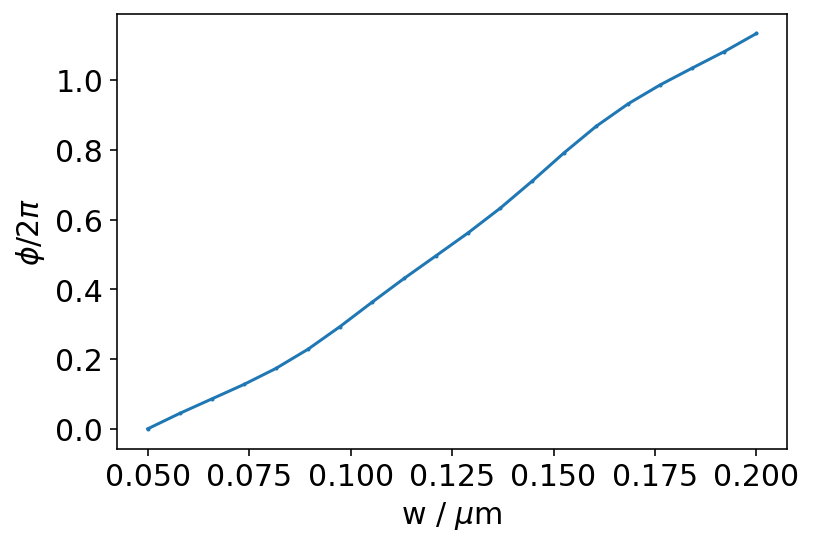

In [21]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_widths,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [22]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_widths':post_widths,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1587075813


### MEEP - simulate an array of geometries

In [23]:
sim_fname = '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [24]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': depth, # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 100.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': False,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [True,''],
    'NAf': 0.5
    }

In [15]:
depths = np.linspace(5,50,10)
depths = np.linspace(50,50,1)
metalenses = []
for depth in depths:
    metalens_pair = {}
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                         + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['shiny'] = metalens['sim_id']
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                         + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens['R'] = metalens['w']
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['control'] = metalens['sim_id']
    metalens_pair['H'] = depth
    metalenses.append(metalens_pair)

-----------
Initializing structure...
     block, center = (0,0,0)
          size (206,4.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 3.6125000000000003/85.85868404087027 = 4.2% done in 4.0s, 91.2s to go
Meep progress: 7.1625000000000005/85.85868404087027 = 8.3% done in 8.0s, 88.0s to go
Meep progress: 10.725000000000001/85.85868404087027 = 12.5% done in 12.0s, 84.1s to go
Meep progress: 14.350000000000001/85.85868404087027 = 16.7% done in 16.0s, 79.8s to go
Meep progress: 18.025000000000002/85.85868404087027 = 21.0% done in 20.0s, 75.4s to go
Meep progress: 21.5375/85.85868404087027 = 25.1% done in 24.0s, 71.8s to go
Meep progress: 24.875/85.85868404087027 = 29.0% done in 28.0s, 68.7s to go
Meep progress: 28.525000000000002/85.85868404087027 = 33.2% done in 32.0s, 64.4s to go
Meep progress: 32.15/85.85868404087027 = 37.4% done in 36.1s, 60.2s to go
Meep progress: 35.7875/85.85868404087027 = 41.7% done in 40.1s, 56.1s to go
Meep progress: 39.

Meep progress: 143.26250000000002/159.27547551405985 = 89.9% done in 148.2s, 16.6s to go
Meep progress: 146.8625/159.27547551405985 = 92.2% done in 152.2s, 12.9s to go
Meep progress: 150.7875/159.27547551405985 = 94.7% done in 156.2s, 8.8s to go
Meep progress: 154.7125/159.27547551405985 = 97.1% done in 160.2s, 4.7s to go
Meep progress: 158.6125/159.27547551405985 = 99.6% done in 164.2s, 0.7s to go
run 0 finished at t = 159.28750000000002 (12743 timesteps)
-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (206.002,1,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-99.75,-1,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-99.5,-1,0)
          size (0.159009,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-99.25,-1,0)
          size (0.144275,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-99,-1,0)
          size (0.128484,0.8,0)
          axes (

In [10]:
# pickle.dump(metalenses, 
#             open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','wb'))

In [10]:
# metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))['metalenses']

In [3]:
metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))

In [5]:
merit_fun = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    merit_fun.append([metalenses[i]['H'],
                      metalens_shiny['tf/if'],
                      metalens_shiny['tf/ff'],
                      metalens_control['tf/if'],
                      metalens_control['tf/ff']])
    del metalens_shiny
    del metalens_control
merit_fun = np.array(merit_fun)

metalens-1586341730.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586341754.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342061.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342102.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field fo

In [12]:
merit_fun = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    merit_fun.append([metalenses[i]['H'],
                      metalens_shiny['tf/if'],
                      metalens_shiny['tf/ff'],
                      metalens_control['tf/if'],
                      metalens_control['tf/ff']])
    del metalens_shiny
    del metalens_control
merit_fun = np.array(merit_fun)

metalens-1586341730.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586341754.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342061.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342102.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field fo

In [26]:
radii = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    radii.append(metalens_shiny['R'])
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    radii.append(metalens_control['R'])
    del metalens_shiny
    del metalens_control
radii = np.array(radii)

metalens-1586341730.pkl
metalens-1586341754.pkl
metalens-1586342061.pkl
metalens-1586342102.pkl
metalens-1586342409.pkl
metalens-1586342467.pkl
metalens-1586342774.pkl
metalens-1586342849.pkl
metalens-1586343157.pkl
metalens-1586343249.pkl
metalens-1586343558.pkl
metalens-1586343668.pkl
metalens-1586343977.pkl
metalens-1586344104.pkl
metalens-1586344413.pkl
metalens-1586344557.pkl
metalens-1586344871.pkl
metalens-1586345037.pkl
metalens-1586345355.pkl
metalens-1586345537.pkl


In [15]:
depths = np.linspace(5,50,10)

In [107]:
print(metalenses)

[{'shiny': '1586341730', 'control': '1586341754', 'H': 5.0}, {'shiny': '1586342061', 'control': '1586342102', 'H': 10.0}, {'shiny': '1586342409', 'control': '1586342467', 'H': 15.0}, {'shiny': '1586342774', 'control': '1586342849', 'H': 20.0}, {'shiny': '1586343157', 'control': '1586343249', 'H': 25.0}, {'shiny': '1586343558', 'control': '1586343668', 'H': 30.0}, {'shiny': '1586343977', 'control': '1586344104', 'H': 35.0}, {'shiny': '1586344413', 'control': '1586344557', 'H': 40.0}, {'shiny': '1586344871', 'control': '1586345037', 'H': 45.0}, {'shiny': '1586345355', 'control': '1586345537', 'H': 50.0}]


In [108]:
print_params(metalens_shiny)

-----------------------------  -----------------------
post_height                    0.80
R                              53.51
d                              26.84
s                              0.00
H                              50.00
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              100.00
unit cell size                 0.25
epsilon                        5.84
wavelength                     0.63
min_width                      0.05
pml_width                      1.00
resolution                     40.00
sim_id                         1586345355
complex_fields                 True
save_output                    False
x_mirror_symmetry              True
quiet                          False
freq_multiplier                3
NAf                            0.50
n                              2.42
Ω                              0.73
zeta                           0.52
aperture                       107

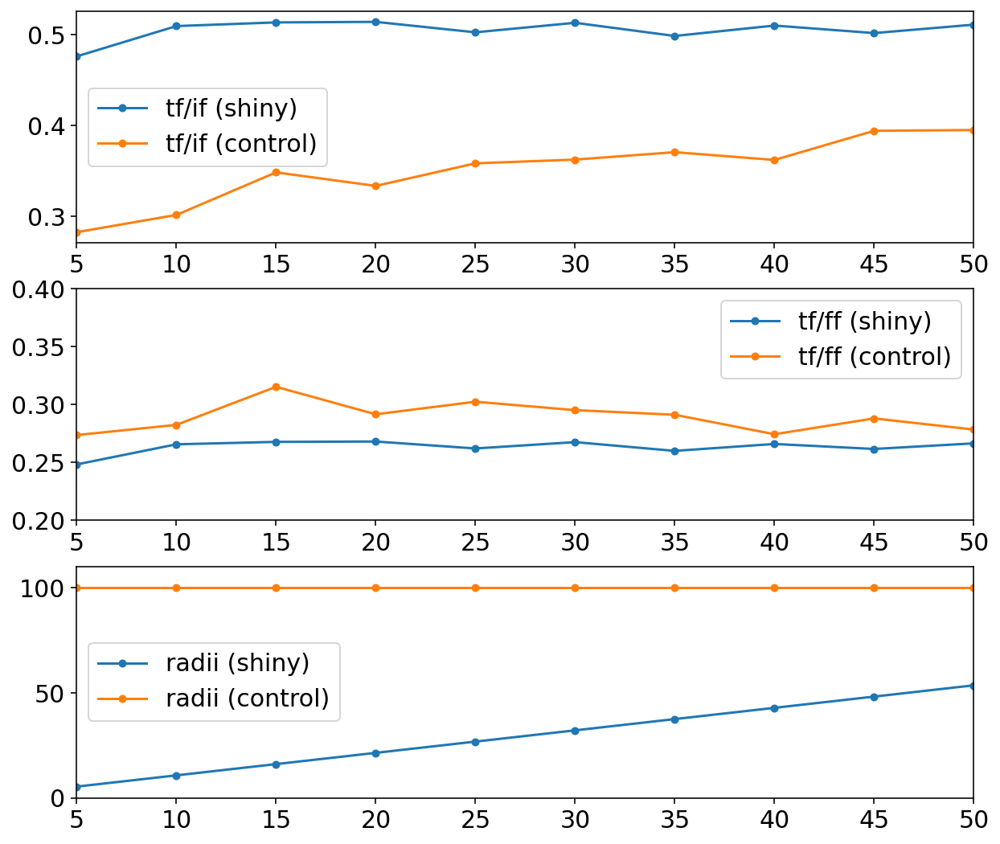

In [106]:
fig, ax = plt.subplots(nrows=3,figsize=(10,9))
ax[0].plot(depths,merit_fun[:,1],'o-',label='tf/if (shiny)',ms=4)
ax[0].plot(depths,merit_fun[:,3],'o-',label='tf/if (control)',ms=4)
ax[0].set_xlim(5,50)
ax[0].legend()
ax[1].plot(depths,merit_fun[:,2],'o-',label='tf/ff (shiny)',ms=4)
ax[1].plot(depths,merit_fun[:,4],'o-',label='tf/ff (control)',ms=4)
ax[1].set_ylim(0.2,0.4)
ax[1].set_xlim(5,50)
ax[1].legend()
ax[2].plot(depths,radii[::2],'o-',label='radii (shiny)',ms=4)
ax[2].plot(depths,radii[1::2],'o-',label='radii (control)',ms=4)
ax[2].legend()
ax[2].set_ylim(0,110)
ax[2].set_xlim(5,50)
plt.show()

In [39]:
metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
print(metalens_shiny_fname.split('/')[-1])
metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
metalens_shiny = compute_post_simulation_params(metalens_shiny)
metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
print(metalens_control_fname.split('/')[-1])
metalens_control = pickle.load(open(metalens_control_fname,'rb'))
metalens_control = compute_post_simulation_params(metalens_control)

metalens-1586342061.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342102.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


In [16]:
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    this_field = np.concatenate((shiny_field,control_field),axis=0)
    fig, ax = plt.subplots(figsize=(10,10))
    extent_c = metalens_control['full_extent']
    extent_s = metalens_shiny['full_extent']
    extent = extent_s[:2] + [extent_s[2],extent_s[3]+(extent_c[3]-extent_s[2])]
    vmin = np.percentile(this_field.flatten(),2)
    vmax = np.percentile(this_field.flatten(),98)
    shiny_height = extent_s[3]-extent_s[2]
    ax.imshow(this_field,
              cmap=metalens_shiny['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=extent)
    ax.plot([-metalens_shiny['w'], metalens_shiny['w']],
             [metalens_shiny['detector_plane_coordinate']]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_shiny['R'], metalens_shiny['R']],
             [metalens_shiny['interface_coordinate']]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.plot([-metalens_control['w'], metalens_control['w']],
             [metalens_control['detector_plane_coordinate']+shiny_height]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_control['R'], metalens_control['R']],
             [metalens_control['interface_coordinate']+shiny_height]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.set_xlabel('x/$\mu$m')
    ax.set_ylabel('y/$\mu$m')
    ax.set_xlim(-105,105)
    ax.set_yticklabels([])
    plt.title('H={H}$\mu$m'.format(H=metalens_shiny['H']))
    #fig.subplots_adjust(hspace=0.1)
    plt.tight_layout()
    plt.savefig("/Users/juan/Temp/metalenses-sbs-2-%d.png" % metalens_control['H'],
               dpi=200)
    plt.close()

metalens-1587069832.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1587070022.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


In [17]:
os.system('pushover "done"')

0

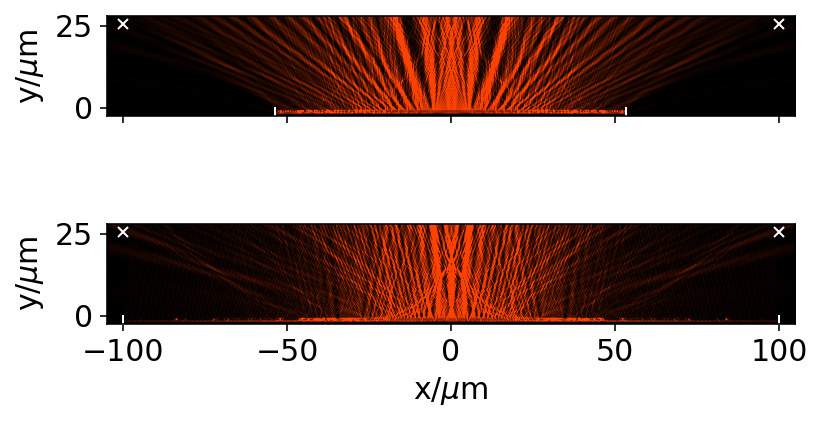

In [81]:
control_field = np.abs(metalens_control['farfields']['rho_em'])
shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
fig, axes = plt.subplots(nrows=2)
for ax_index, axis in enumerate(axes):
    this_field = [shiny_field, control_field][ax_index]
    this_metalens = [metalens_shiny, metalens_control][ax_index]
    vmin = np.percentile(this_field.flatten(),2)
    vmax = np.percentile(this_field.flatten(),98)
    axis.imshow(this_field,
              cmap=this_metalens['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=this_metalens['full_extent'])
    axis.plot([-this_metalens['w'], this_metalens['w']],
             [this_metalens['detector_plane_coordinate']]*2,
             'wx',
             ms=5)
    axis.plot([-this_metalens['R'], this_metalens['R']],
             [this_metalens['interface_coordinate']]*2,
             'wx',
             marker = "|",
             ms=5)
    if ax_index == 1:
        axis.set_xlabel('x/$\mu$m')
    axis.set_ylabel('y/$\mu$m')
    axis.set_xlim(-105,105)
    #axis.set_ylim(-1.5,55)
    if ax_index == 0:
        axis.set_xticklabels([])
#fig.subplots_adjust(hspace=0.1)
# plt.savefig("/Users/juan/Temp/metalenses-sbs-%d.png" % this_metalens['H'],
#            dpi=200)
plt.tight_layout()
plt.show()


In [75]:
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    fig, axes = plt.subplots(nrows=2, figsize=(10,6))
    for ax_index, axis in enumerate(axes):
        this_field = [shiny_field, control_field][ax_index]
        this_metalens = [metalens_shiny, metalens_control][ax_index]
        vmin = np.percentile(this_field.flatten(),2)
        vmax = np.percentile(this_field.flatten(),98)
        axis.imshow(this_field,
                  cmap=this_metalens['cmap'],
                  origin='lower',
                  vmin=vmin,
                  vmax=vmax,
                  extent=this_metalens['full_extent'])
        axis.plot([-this_metalens['w'], this_metalens['w']],
                 [this_metalens['detector_plane_coordinate']]*2,
                 'wx',
                 ms=5)
        axis.plot([-this_metalens['R'], this_metalens['R']],
                 [this_metalens['interface_coordinate']]*2,
                 'wx',
                 marker = "|",
                 ms=5)
        if ax_index == 1:
            axis.set_xlabel('x/$\mu$m')
        axis.set_ylabel('y/$\mu$m')
        axis.set_xlim(-105,105)
        axis.set_ylim(-1.5,55)
        if ax_index == 0:
            axis.set_xticklabels([])
    #fig.subplots_adjust(hspace=0.1)
    plt.savefig("/Users/juan/Temp/metalenses-sbs-%d.png" % this_metalens['H'],
               dpi=200)
    plt.close()
    break

metalens-1586341730.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586341754.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342061.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586342102.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field fo

In [77]:
os.system('say "finished"')

0

### MEEP - gradient boost

In [8]:
sim_fname = '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [34]:
depths = np.linspace(5,50,10)
metalenses = []
for depth in depths:
    metalens_pair = {}
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5,
        'gradient_boost': 1.1
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        if 'gradient_boost' not in metalens.keys():
            metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        else:
            metalens['Ω'] = (metalens['gradient_boost']*metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['shiny'] = metalens['sim_id']
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 100.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,''],
        'NAf': 0.5,
        'gradient_boost': 1.1
        }
    if 'NAf' in metalens.keys():
        metalens['n'] = np.sqrt(metalens['epsilon'])
        if 'gradient_boost' not in metalens.keys():
            metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        else:
            metalens['Ω'] = (metalens['gradient_boost']*metalens['wavelength']/2/metalens['unit cell size']
                             + metalens['NAf']) / metalens['n']
        metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
        metalens['zeta'] = np.arcsin(metalens['NAf'])
        metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
    metalens['R'] = metalens['w']
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens_pair['control'] = metalens['sim_id']
    metalens_pair['H'] = depth
    metalenses.append(metalens_pair)

-----------
Initializing structure...
     block, center = (0,0,0)
          size (206,4.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 3.6750000000000003/11.70038057081777 = 31.4% done in 4.0s, 8.7s to go
Meep progress: 7.5/11.70038057081777 = 64.1% done in 8.0s, 4.5s to go
Meep progress: 11.1875/11.70038057081777 = 95.6% done in 12.0s, 0.6s to go
run 0 finished at t = 11.7125 (937 timesteps)
-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (206,1,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-6,-1,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-5.75,-1,0)
          size (0.108522,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-5.5,-1,0)
          size (0.150783,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-5.25,-1,0)
          size (0.0766599,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
    

Meep progress: 88.5625/159.27547551405985 = 55.6% done in 88.1s, 70.4s to go
Meep progress: 92.48750000000001/159.27547551405985 = 58.1% done in 92.2s, 66.5s to go
Meep progress: 96.55000000000001/159.27547551405985 = 60.6% done in 96.2s, 62.5s to go
Meep progress: 100.72500000000001/159.27547551405985 = 63.2% done in 100.2s, 58.2s to go
Meep progress: 104.875/159.27547551405985 = 65.8% done in 104.2s, 54.0s to go
Meep progress: 109.05000000000001/159.27547551405985 = 68.5% done in 108.2s, 49.8s to go
Meep progress: 113.2125/159.27547551405985 = 71.1% done in 112.2s, 45.6s to go
Meep progress: 117.375/159.27547551405985 = 73.7% done in 116.2s, 41.5s to go
Meep progress: 121.55000000000001/159.27547551405985 = 76.3% done in 120.2s, 37.3s to go
Meep progress: 125.7125/159.27547551405985 = 78.9% done in 124.2s, 33.2s to go
Meep progress: 129.875/159.27547551405985 = 81.5% done in 128.2s, 29.0s to go
Meep progress: 134.025/159.27547551405985 = 84.1% done in 132.2s, 24.9s to go
Meep progres

          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 3.85/159.27547551405985 = 2.4% done in 4.0s, 161.8s to go
Meep progress: 8.0/159.27547551405985 = 5.0% done in 8.0s, 151.5s to go
Meep progress: 12.1875/159.27547551405985 = 7.7% done in 12.0s, 145.1s to go
Meep progress: 16.3625/159.27547551405985 = 10.3% done in 16.0s, 139.9s to go
Meep progress: 20.525000000000002/159.27547551405985 = 12.9% done in 20.0s, 135.4s to go
Meep progress: 24.6875/159.27547551405985 = 15.5% done in 24.0s, 131.0s to go
Meep progress: 28.875/159.27547551405985 = 18.1% done in 28.0s, 126.6s to go
Meep progress: 33.0625/159.27547551405985 = 20.8% done in 32.0s, 122.3s to go
Meep progress: 37.25/159.27547551405985 = 23.4% done in 36.0s, 118.1s to go
Meep progress: 41.075/159.27547551405985 = 25.8% done in 40.1s, 115.3s to go
Meep progress: 45.25/159.27547551405985 = 28.4% done in 44.1s, 111.0s to go
Meep progress: 49.4375/159.27547551405985 = 31.0% done in 48.1s, 106.8s to go
Me

Meep progress: 118.95/159.27547551405985 = 74.7% done in 116.2s, 39.4s to go
Meep progress: 123.0875/159.27547551405985 = 77.3% done in 120.2s, 35.3s to go
Meep progress: 127.2125/159.27547551405985 = 79.9% done in 124.2s, 31.3s to go
Meep progress: 131.07500000000002/159.27547551405985 = 82.3% done in 128.3s, 27.6s to go
Meep progress: 135.175/159.27547551405985 = 84.9% done in 132.3s, 23.6s to go
Meep progress: 139.32500000000002/159.27547551405985 = 87.5% done in 136.3s, 19.5s to go
Meep progress: 143.4375/159.27547551405985 = 90.1% done in 140.3s, 15.5s to go
Meep progress: 147.5375/159.27547551405985 = 92.6% done in 144.3s, 11.5s to go
Meep progress: 151.70000000000002/159.27547551405985 = 95.2% done in 148.3s, 7.4s to go
Meep progress: 155.82500000000002/159.27547551405985 = 97.8% done in 152.3s, 3.4s to go
run 0 finished at t = 159.28750000000002 (12743 timesteps)
-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (206.002,1,0)
          axes (1

     block, center = (0,0,0)
          size (206.002,4.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
Meep: using complex fields.
Meep progress: 3.8375000000000004/159.27547551405985 = 2.4% done in 4.0s, 162.1s to go
Meep progress: 7.9375/159.27547551405985 = 5.0% done in 8.0s, 152.6s to go
Meep progress: 12.0875/159.27547551405985 = 7.6% done in 12.0s, 146.2s to go
Meep progress: 16.1875/159.27547551405985 = 10.2% done in 16.0s, 141.5s to go
Meep progress: 20.3125/159.27547551405985 = 12.8% done in 20.0s, 137.0s to go
Meep progress: 24.400000000000002/159.27547551405985 = 15.3% done in 24.0s, 132.8s to go
Meep progress: 28.512500000000003/159.27547551405985 = 17.9% done in 28.0s, 128.5s to go
Meep progress: 32.625/159.27547551405985 = 20.5% done in 32.0s, 124.4s to go
Meep progress: 36.7625/159.27547551405985 = 23.1% done in 36.0s, 120.1s to go
Meep progress: 40.575/159.27547551405985 = 25.5% done in 40.0s, 117.2s to go
Meep progress: 44.675000000000004/159.27547551405985 = 28.0% done 

Meep progress: 28.3125/51.08888767784779 = 55.4% done in 28.0s, 22.6s to go
Meep progress: 32.300000000000004/51.08888767784779 = 63.2% done in 32.1s, 18.6s to go
Meep progress: 35.9125/51.08888767784779 = 70.3% done in 36.1s, 15.2s to go
Meep progress: 39.800000000000004/51.08888767784779 = 77.9% done in 40.1s, 11.4s to go
Meep progress: 43.725/51.08888767784779 = 85.6% done in 44.1s, 7.4s to go
Meep progress: 47.6375/51.08888767784779 = 93.2% done in 48.1s, 3.5s to go
run 0 finished at t = 51.1 (4088 timesteps)
-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (206,1,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-31.25,-1,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-31,-1,0)
          size (0.109923,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-30.75,-1,0)
          size (0.153967,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-30.5,

Meep progress: 53.4125/159.27547551405985 = 33.5% done in 52.1s, 103.2s to go
Meep progress: 57.575/159.27547551405985 = 36.1% done in 56.1s, 99.1s to go
Meep progress: 61.75/159.27547551405985 = 38.8% done in 60.1s, 94.9s to go
Meep progress: 65.8375/159.27547551405985 = 41.3% done in 64.1s, 91.0s to go
Meep progress: 69.9875/159.27547551405985 = 43.9% done in 68.1s, 86.9s to go
Meep progress: 74.15/159.27547551405985 = 46.6% done in 72.1s, 82.8s to go
Meep progress: 78.03750000000001/159.27547551405985 = 49.0% done in 76.1s, 79.2s to go
Meep progress: 82.125/159.27547551405985 = 51.6% done in 80.1s, 75.3s to go
Meep progress: 86.30000000000001/159.27547551405985 = 54.2% done in 84.1s, 71.1s to go
Meep progress: 90.47500000000001/159.27547551405985 = 56.8% done in 88.1s, 67.0s to go
Meep progress: 94.625/159.27547551405985 = 59.4% done in 92.1s, 62.9s to go
Meep progress: 98.78750000000001/159.27547551405985 = 62.0% done in 96.1s, 58.9s to go
Meep progress: 102.95/159.27547551405985 =

Meep progress: 102.03750000000001/159.27547551405985 = 64.1% done in 100.2s, 56.2s to go
Meep progress: 105.8125/159.27547551405985 = 66.4% done in 104.2s, 52.6s to go
Meep progress: 110.0/159.27547551405985 = 69.1% done in 108.2s, 48.5s to go
Meep progress: 114.1375/159.27547551405985 = 71.7% done in 112.2s, 44.4s to go
Meep progress: 118.2/159.27547551405985 = 74.2% done in 116.2s, 40.4s to go
Meep progress: 122.28750000000001/159.27547551405985 = 76.8% done in 120.2s, 36.4s to go
Meep progress: 126.3875/159.27547551405985 = 79.4% done in 124.2s, 32.3s to go
Meep progress: 130.5/159.27547551405985 = 81.9% done in 128.2s, 28.3s to go
Meep progress: 134.625/159.27547551405985 = 84.5% done in 132.2s, 24.2s to go
Meep progress: 138.675/159.27547551405985 = 87.1% done in 136.2s, 20.2s to go
Meep progress: 142.75/159.27547551405985 = 89.6% done in 140.2s, 16.2s to go
Meep progress: 146.85/159.27547551405985 = 92.2% done in 144.2s, 12.2s to go
Meep progress: 150.9375/159.27547551405985 = 94

Meep progress: 115.60000000000001/159.27547551405985 = 72.6% done in 112.2s, 42.4s to go
Meep progress: 119.73750000000001/159.27547551405985 = 75.2% done in 116.2s, 38.4s to go
Meep progress: 123.8875/159.27547551405985 = 77.8% done in 120.2s, 34.3s to go
Meep progress: 128.0375/159.27547551405985 = 80.4% done in 124.2s, 30.3s to go
Meep progress: 132.1875/159.27547551405985 = 83.0% done in 128.2s, 26.3s to go
Meep progress: 136.3375/159.27547551405985 = 85.6% done in 132.2s, 22.2s to go
Meep progress: 140.4875/159.27547551405985 = 88.2% done in 136.2s, 18.2s to go
Meep progress: 144.65/159.27547551405985 = 90.8% done in 140.2s, 14.2s to go
Meep progress: 148.8125/159.27547551405985 = 93.4% done in 144.3s, 10.1s to go
Meep progress: 152.9875/159.27547551405985 = 96.1% done in 148.3s, 6.1s to go
Meep progress: 157.16250000000002/159.27547551405985 = 98.7% done in 152.3s, 2.0s to go
run 0 finished at t = 159.28750000000002 (12743 timesteps)
/Users/juan/Google Drive/Zia Lab/Log/Data/meta

Meep progress: 130.9375/159.27547551405985 = 82.2% done in 128.2s, 27.7s to go
Meep progress: 135.05/159.27547551405985 = 84.8% done in 132.2s, 23.7s to go
Meep progress: 139.1875/159.27547551405985 = 87.4% done in 136.2s, 19.7s to go
Meep progress: 143.32500000000002/159.27547551405985 = 90.0% done in 140.2s, 15.6s to go
Meep progress: 147.4375/159.27547551405985 = 92.6% done in 144.2s, 11.6s to go
Meep progress: 151.4625/159.27547551405985 = 95.1% done in 148.2s, 7.6s to go
Meep progress: 155.53750000000002/159.27547551405985 = 97.7% done in 152.3s, 3.7s to go
run 0 finished at t = 159.28750000000002 (12743 timesteps)
-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (206.002,1,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-99.75,-1,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-99.5,-1,0)
          size (0.162738,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = 

Meep: using complex fields.
Meep progress: 3.95/90.82243896507899 = 4.3% done in 4.0s, 88.1s to go
Meep progress: 8.200000000000001/90.82243896507899 = 9.0% done in 8.0s, 80.7s to go
Meep progress: 12.350000000000001/90.82243896507899 = 13.6% done in 12.0s, 76.4s to go
Meep progress: 16.45/90.82243896507899 = 18.1% done in 16.0s, 72.5s to go
Meep progress: 20.5/90.82243896507899 = 22.6% done in 20.0s, 68.7s to go
Meep progress: 24.512500000000003/90.82243896507899 = 27.0% done in 24.0s, 65.0s to go
Meep progress: 28.5/90.82243896507899 = 31.4% done in 28.0s, 61.3s to go
Meep progress: 32.45/90.82243896507899 = 35.7% done in 32.1s, 57.7s to go
Meep progress: 36.4125/90.82243896507899 = 40.1% done in 36.1s, 53.9s to go
Meep progress: 40.6375/90.82243896507899 = 44.7% done in 40.1s, 49.5s to go
Meep progress: 44.85/90.82243896507899 = 49.4% done in 44.1s, 45.2s to go
Meep progress: 49.087500000000006/90.82243896507899 = 54.0% done in 48.1s, 40.9s to go
Meep progress: 53.075/90.82243896507

Meep progress: 112.10000000000001/159.27547551405985 = 70.4% done in 108.2s, 45.5s to go
Meep progress: 116.2625/159.27547551405985 = 73.0% done in 112.2s, 41.5s to go
Meep progress: 120.0625/159.27547551405985 = 75.4% done in 116.2s, 37.9s to go
Meep progress: 124.2/159.27547551405985 = 78.0% done in 120.2s, 33.9s to go
Meep progress: 128.4/159.27547551405985 = 80.6% done in 124.2s, 29.9s to go
Meep progress: 132.6125/159.27547551405985 = 83.3% done in 128.2s, 25.8s to go
Meep progress: 136.7875/159.27547551405985 = 85.9% done in 132.2s, 21.7s to go
Meep progress: 140.975/159.27547551405985 = 88.5% done in 136.2s, 17.7s to go
Meep progress: 145.13750000000002/159.27547551405985 = 91.1% done in 140.2s, 13.7s to go
Meep progress: 149.3125/159.27547551405985 = 93.7% done in 144.2s, 9.6s to go
Meep progress: 153.475/159.27547551405985 = 96.4% done in 148.2s, 5.6s to go
Meep progress: 157.63750000000002/159.27547551405985 = 99.0% done in 152.2s, 1.6s to go
run 0 finished at t = 159.2875000

Meep progress: 81.325/159.27547551405985 = 51.1% done in 80.1s, 76.8s to go
Meep progress: 85.3875/159.27547551405985 = 53.6% done in 84.1s, 72.8s to go
Meep progress: 89.45/159.27547551405985 = 56.2% done in 88.1s, 68.8s to go
Meep progress: 93.53750000000001/159.27547551405985 = 58.7% done in 92.1s, 64.8s to go
Meep progress: 97.67500000000001/159.27547551405985 = 61.3% done in 96.1s, 60.6s to go
Meep progress: 101.78750000000001/159.27547551405985 = 63.9% done in 100.2s, 56.6s to go
Meep progress: 105.8875/159.27547551405985 = 66.5% done in 104.2s, 52.5s to go
Meep progress: 110.0/159.27547551405985 = 69.1% done in 108.2s, 48.5s to go
Meep progress: 114.10000000000001/159.27547551405985 = 71.6% done in 112.2s, 44.4s to go
Meep progress: 118.22500000000001/159.27547551405985 = 74.2% done in 116.2s, 40.3s to go
Meep progress: 122.325/159.27547551405985 = 76.8% done in 120.2s, 36.3s to go
Meep progress: 126.45/159.27547551405985 = 79.4% done in 124.2s, 32.2s to go
Meep progress: 130.36

In [35]:
pickle.dump(metalenses, 
            open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs-boosted-1p1.pkl','wb'))

In [36]:
# metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))['metalenses']

In [37]:
# metalenses = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalenses-sbs.pkl','rb'))

In [38]:
print_params(metalens_shiny)

-----------------------------  -----------------------
post_height                    0.80
R                              81.52
d                              10.67
s                              0.00
H                              10.00
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              100.00
unit cell size                 0.25
epsilon                        5.84
wavelength                     0.63
min_width                      0.05
pml_width                      1.00
resolution                     40.00
sim_id                         1586473620
complex_fields                 True
save_output                    False
x_mirror_symmetry              True
quiet                          False
freq_multiplier                3
NAf                            0.50
gradient_boost                 1.50
n                              2.42
Ω                              0.99
zeta                           0.5

In [39]:
merit_fun = []
for i in range(len(metalenses)):
#     if i == 4:
#         break
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    merit_fun.append([metalenses[i]['H'],
                      metalens_shiny['tf/if'],
                      metalens_shiny['tf/ff'],
                      metalens_control['tf/if'],
                      metalens_control['tf/ff']])
    del metalens_shiny
    del metalens_control
merit_fun = np.array(merit_fun)

metalens-1586513929.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586513958.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586514285.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586514333.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field fo

In [40]:
dees = []
for i in range(len(metalenses)):
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    dees.append(metalens_shiny['d'])
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    dees.append(metalens_control['d'])
    del metalens_shiny
    del metalens_control
dees = np.array(dees)

metalens-1586513929.pkl
metalens-1586513958.pkl
metalens-1586514285.pkl
metalens-1586514333.pkl
metalens-1586514649.pkl
metalens-1586514716.pkl
metalens-1586515031.pkl
metalens-1586515118.pkl
metalens-1586515435.pkl
metalens-1586515543.pkl
metalens-1586515863.pkl
metalens-1586515992.pkl
metalens-1586516308.pkl
metalens-1586516457.pkl
metalens-1586516773.pkl
metalens-1586516943.pkl
metalens-1586517261.pkl
metalens-1586517446.pkl
metalens-1586517762.pkl
metalens-1586517967.pkl


In [41]:
radii = []
for i in range(len(metalenses)):
#     if i == 2:
#         break
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    radii.append(metalens_shiny['R'])
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    radii.append(metalens_control['R'])
    del metalens_shiny
    del metalens_control
radii = np.array(radii)

metalens-1586513929.pkl
metalens-1586513958.pkl
metalens-1586514285.pkl
metalens-1586514333.pkl
metalens-1586514649.pkl
metalens-1586514716.pkl
metalens-1586515031.pkl
metalens-1586515118.pkl
metalens-1586515435.pkl
metalens-1586515543.pkl
metalens-1586515863.pkl
metalens-1586515992.pkl
metalens-1586516308.pkl
metalens-1586516457.pkl
metalens-1586516773.pkl
metalens-1586516943.pkl
metalens-1586517261.pkl
metalens-1586517446.pkl
metalens-1586517762.pkl
metalens-1586517967.pkl


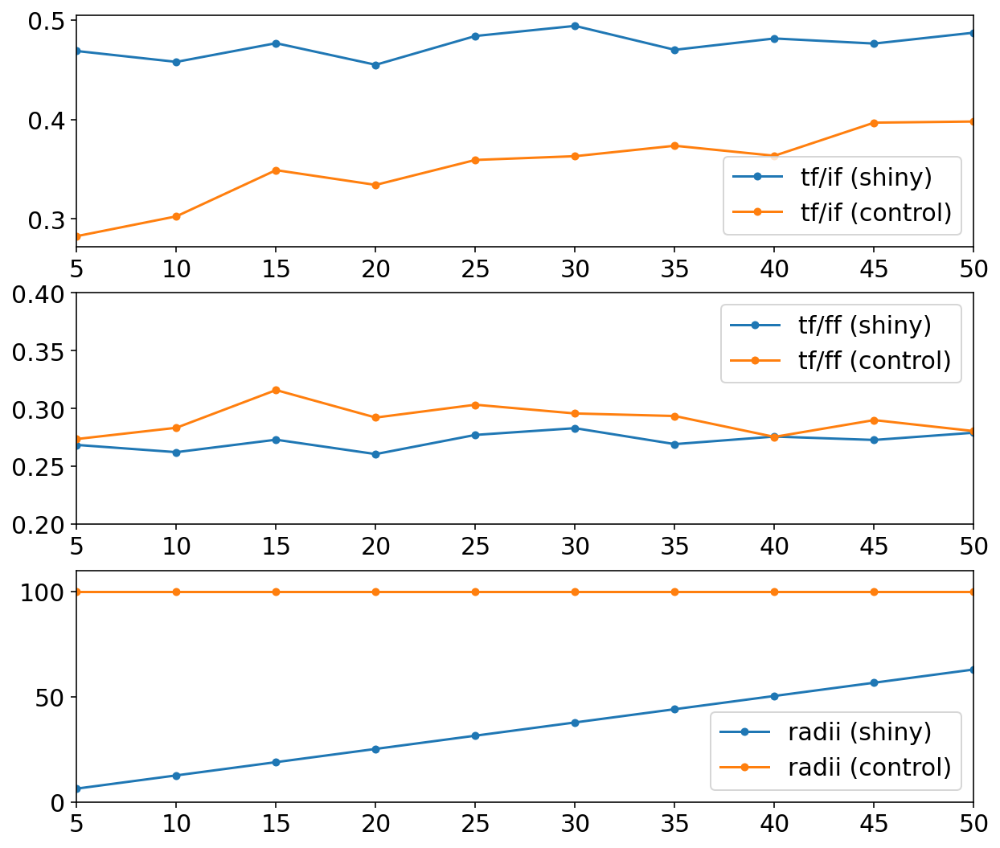

In [43]:
fig, ax = plt.subplots(nrows=3,figsize=(10,9))
ax[0].plot(depths,merit_fun[:,1],'o-',label='tf/if (shiny)',ms=4)
ax[0].plot(depths,merit_fun[:,3],'o-',label='tf/if (control)',ms=4)
ax[0].set_xlim(5,50)
ax[0].legend()
ax[1].plot(depths,merit_fun[:,2],'o-',label='tf/ff (shiny)',ms=4)
ax[1].plot(depths,merit_fun[:,4],'o-',label='tf/ff (control)',ms=4)
ax[1].set_ylim(0.2,0.4)
ax[1].set_xlim(5,50)
ax[1].legend()
ax[2].plot(depths,radii[::2],'o-',label='radii (shiny)',ms=4)
ax[2].plot(depths,radii[1::2],'o-',label='radii (control)',ms=4)
ax[2].legend()
ax[2].set_ylim(0,110)
ax[2].set_xlim(5,50)
plt.show()

In [44]:
for i in range(len(metalenses)):
#     if i == 2:
#         break
    metalens_shiny_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['shiny']
    print(metalens_shiny_fname.split('/')[-1])
    metalens_shiny = pickle.load(open(metalens_shiny_fname,'rb'))
    metalens_shiny = compute_post_simulation_params(metalens_shiny)
    metalens_control_fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % metalenses[i]['control']
    print(metalens_control_fname.split('/')[-1])
    metalens_control = pickle.load(open(metalens_control_fname,'rb'))
    metalens_control = compute_post_simulation_params(metalens_control)
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    control_field = np.abs(metalens_control['farfields']['rho_em'])
    shiny_field = np.abs(metalens_shiny['farfields']['rho_em'])
    this_field = np.concatenate((shiny_field,control_field),axis=0)
    fig, ax = plt.subplots(figsize=(10,10))
    extent_c = metalens_control['full_extent']
    extent_s = metalens_shiny['full_extent']
    extent = extent_s[:2] + [extent_s[2],extent_s[3]+(extent_c[3]-extent_s[2])]
    vmin = np.percentile(this_field.flatten(),2)
    vmax = np.percentile(this_field.flatten(),98)
    shiny_height = extent_s[3]-extent_s[2]
    ax.imshow(this_field,
              cmap=metalens_shiny['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=extent)
    ax.plot([-metalens_shiny['w'], metalens_shiny['w']],
             [metalens_shiny['detector_plane_coordinate']]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_shiny['R'], metalens_shiny['R']],
             [metalens_shiny['interface_coordinate']]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.plot([-metalens_control['w'], metalens_control['w']],
             [metalens_control['detector_plane_coordinate']+shiny_height]*2,
             'wx',
             ms=5)
    ax.plot([-metalens_control['R'], metalens_control['R']],
             [metalens_control['interface_coordinate']+shiny_height]*2,
             'wx',
             marker = "|",
             ms=5)
    ax.set_xlabel('x/$\mu$m')
    ax.set_ylabel('y/$\mu$m')
    ax.set_xlim(-105,105)
    ax.set_yticklabels([])
    plt.title('H={H}$\mu$m'.format(H=metalens_shiny['H']))
    #fig.subplots_adjust(hspace=0.1)
    plt.tight_layout()
    plt.savefig("/Users/juan/Temp/metalenses-sbs-boosted-1p1-%d.png" % metalens_control['H'],
               dpi=200)
    plt.close()

metalens-1586513929.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586513958.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586514285.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
metalens-1586514333.pkl
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field fo

In [45]:
os.system('pushover "done"')

0

### MEEP - eating fiber

In [121]:
sim_fname = '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [207]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 50, # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 100.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [False,''],
    'NAf': 0.5
    }
if 'NAf' in metalens.keys():
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['Ω'] = (metalens['wavelength']/2/metalens['unit cell size']
                     + metalens['NAf']) / metalens['n']
    metalens['R'] = metalens['H']*metalens['Ω']/np.sqrt(1-metalens['Ω']**2)
    metalens['zeta'] = np.arcsin(metalens['NAf'])
    metalens['d'] = np.tan(metalens['zeta']) * (metalens['w']-metalens['R'])
metalens['w'] = metalens['R']

In [208]:
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


In [209]:
metalens['tf/ff']

0.24657227324076642

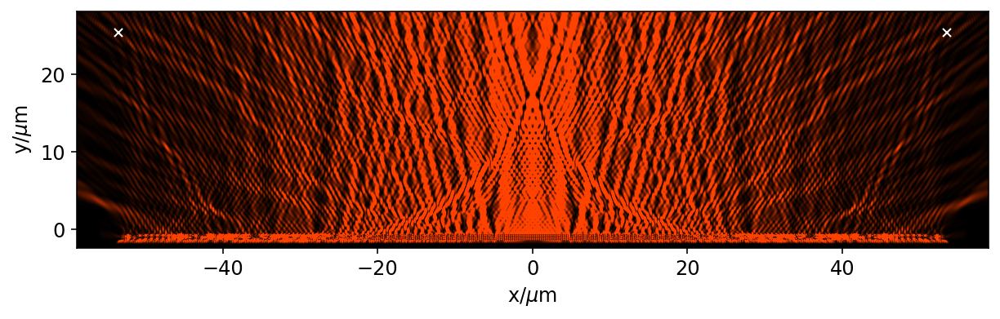

In [210]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=5)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.xlim(-1.1*metalens['w'],1.1*metalens['w'])
plt.show()

In [211]:
metalens['R']

53.50980571527563

In [212]:
metalens['detector_plane_coordinate']

25.44112618496361

In [213]:
90-np.arcsin(metalens['NAf'])*180/np.pi

60.0

### MEEP - in the deep

In [7]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [89]:
depth = 800
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': depth, # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 25.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3, # must be an odd integer
    'log_to_pkl': [False,'']
    }
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)
metalens = compute_post_simulation_params(metalens)
#gotchaHR.append([depth, metalens['tf/if'], metalens['tf/ff']])
metalens['tf/if']

Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


0.7392541587302638

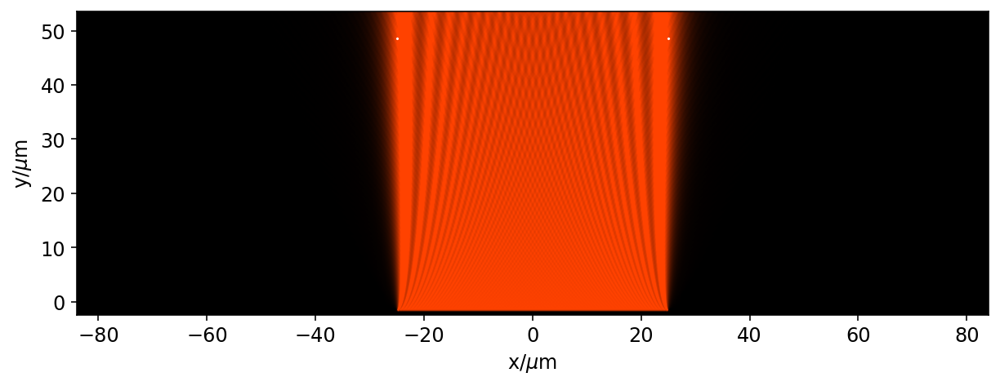

In [86]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [98]:
depths = np.linspace(5,100,20)

In [99]:
gotchaHR = []
for depth in depths:
    print('H=%.1f' % depth)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': depth, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': 25.,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 50.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': True,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [False,'']
        }
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    gotchaHR.append([depth, metalens['tf/if'], metalens['tf/ff']])
gotchaHR = np.array(gotchaHR)

H=5.0
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
H=10.0
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
H=15.0
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
H=20.0
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field

In [72]:
!pushover "done"

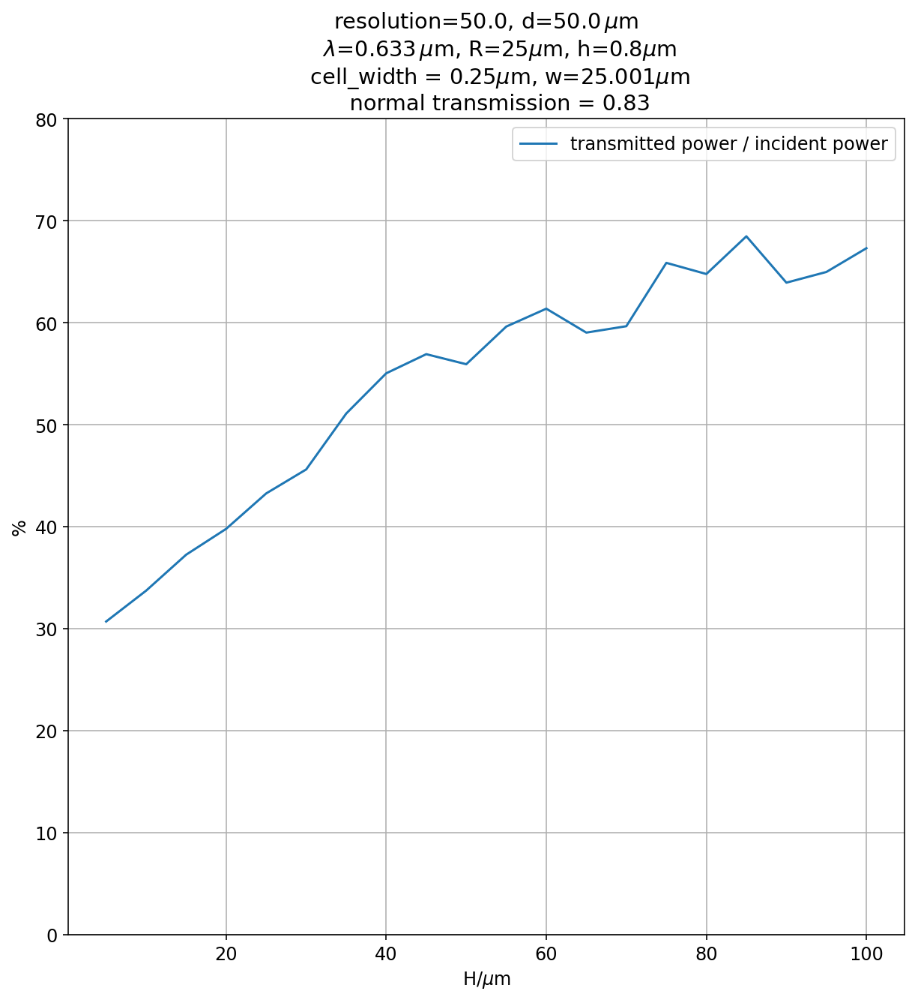

In [100]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,10))
title_string = '''resolution={resolution}, d={d}$\,\mu$m
    $\lambda$={wavelength}$\,\mu$m, R={R}$\mu$m, h={post_height}$\mu$m
    cell_width = {cell_width}$\mu$m, w={w}$\mu$m
    normal transmission = {normal_incidence_transmission:.2f}'''
#plt.plot(gotcha[:,0],100*gotchaHR[:,1],label='transmitted power / incident power')
plt.plot(gotchaHR[:,0],100*gotchaHR[:,1],label='transmitted power / incident power')
plt.xlabel('H/$\mu$m')
plt.ylabel('%')
plt.ylim(0,80.)
plt.legend()
plt.grid(True)
plt.title(title_string.format(**metalens))
plt.show()

In [96]:
gotchaHR

array([[ 5.        ,  0.30691622,  0.26834732],
       [10.        ,  0.33721816,  0.25553114],
       [15.        ,  0.37247481,  0.24432793],
       [20.        ,  0.3978596 ,  0.22695764],
       [25.        ,  0.43256937,  0.21628469],
       [30.        ,  0.45610905,  0.20172979],
       [35.        ,  0.51092394,  0.201745  ],
       [40.        ,  0.55040825,  0.19573363],
       [45.        ,  0.56916626,  0.18374334],
       [50.        ,  0.55930428,  0.1650883 ]])

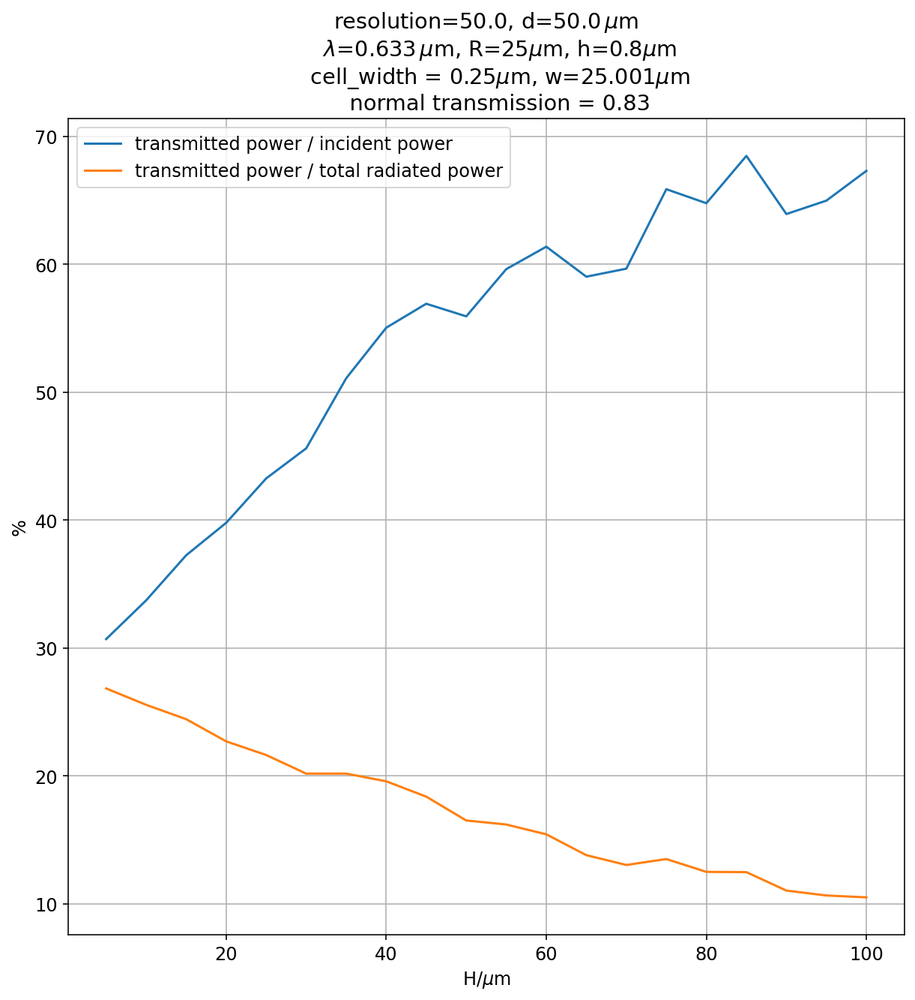

In [101]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,10))
title_string = '''resolution={resolution}, d={d}$\,\mu$m
    $\lambda$={wavelength}$\,\mu$m, R={R}$\mu$m, h={post_height}$\mu$m
    cell_width = {cell_width}$\mu$m, w={w}$\mu$m
    normal transmission = {normal_incidence_transmission:.2f}'''
plt.plot(gotchaHR[:,0],100*gotchaHR[:,1],label='transmitted power / incident power')
plt.plot(gotchaHR[:,0],100*gotchaHR[:,2],label='transmitted power / total radiated power')
plt.xlabel('H/$\mu$m')
plt.ylabel('%')
#plt.ylim(0,30.)
plt.legend()
plt.grid(True)
plt.title(title_string.format(**metalens))
plt.show()

In [296]:
print("target_flux/incident_flux = %.1f%%"  % (100*metalens['tf/if']))
print("target_flux/full_flux = %.1f%%"  % (100*metalens['tf/ff']))

target_flux/incident_flux = 29.3%
target_flux/full_flux = 4.3%


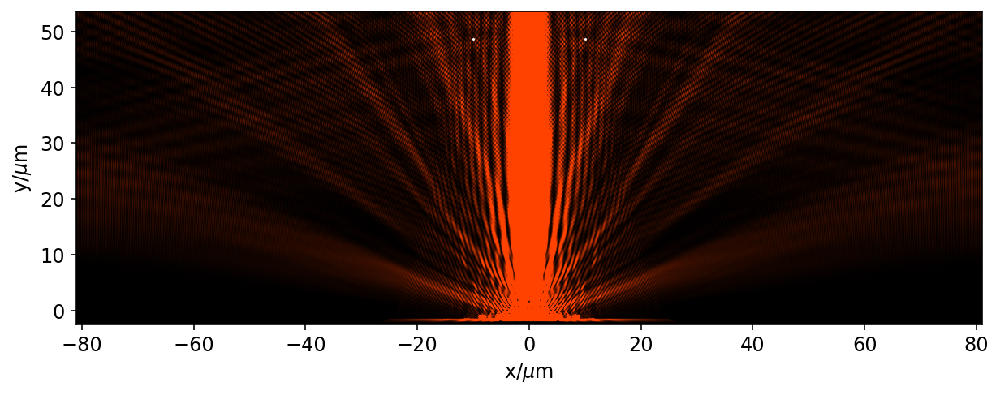

In [355]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [8]:
ws = np.array([5.,10.,15.,20.,25.,30.])
Hs = np.array([5.,10.,15.,20.,25.,30.])

In [9]:
metalenses_params = []
for w, H in itertools.product(ws,Hs):
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': H, # depth of emitter
        'gap_h': 1.0,
        'gap_v': 0.,
        'b': 2.0, # distance between source and interface
        'w': w,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 50.,
        'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': True,
        'freq_multiplier': 3, # must be an odd integer
        'log_to_pkl': [True,'']
        }
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalenses_params.append(metalens)

In [10]:
def quick_metal(metalens,cue):
    metalens['incident_flux'] = get_flux_on_metalens(metalens)
    metalens = simulate_metalens(metalens)
    print(metalens['sim_id'])
    cue.put(metalens)
# metalenses = multip.Pool(processes=4).map(quick_metal, metalenses_params[:4], chunksize=1);
cue = multip.Queue()
processes = [multip.Process(target=quick_metal,
            args=(metalens,cue)) for metalens in metalenses_params[:4]]
for p in processes:
    p.start()
for p in processes:
    p.join()
metalenses = [cue.get() for p in processes];

/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586255562.pkl
1586255562
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586255562.pkl
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586255562.pkl
/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1586255562.pkl
1586255562
1586255562
1586255562


Process Process-3:
Process Process-4:
Process Process-1:
Process Process-2:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/multiprocessing/process.py", line 300, in _bootstrap
    util._exit_function()
  File "/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/multiprocessing/process.py", line 300, in _bootstrap
    util._exit_function()
  File "/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/multiprocessing/process.py", line 300, in _bootstrap
    util._exit_function()
  File "/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/multiprocessing/process.py", line 300, in _bootstrap
    util._exit_function()
  File "/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/multiprocessing/util.py", line 337, in _exit_function
    _run_finalizers()
  File "/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/multiprocessing/util.py", line 337, in

KeyboardInterrupt: 

In [12]:
25/36*4

2.7777777777777777

In [1]:
!pushover "done"

In [102]:
ws = np.array([5.,10.,15.,20.,25.,30.])
Hs = np.array([5.,10.,15.,20.,25.,30.])
atlante_parallel = {}
for w in ws:
    for H in Hs:
        print('H=%.1f, w=%.1f' % (H, w))
        metalens = {
            'post_height':simulation_parameters['post_height'],
            'R': 25,
            'd': 50.,
            's': 0.0,
            'H': H, # depth of emitter
            'gap_h': 1.0,
            'gap_v': 0.,
            'b': 2.0, # distance between source and interface
            'w': w,
            'unit cell size': simulation_parameters['cell_width'],
            'epsilon': simulation_parameters['epsilon'],
            'phases': phases,
            'widths': post_widths,
            'wavelength': simulation_parameters['wavelength'],
            'min_width': 0.05,
            'pml_width': 1.0,
            'resolution': 50.,
            'sim_id': str(int(time.time())), #simulation_parameters['sim_id'],
            'simulation_parameters' : simulation_parameters,
            'complex_fields' : True,
            'save_output': False,
            'x_mirror_symmetry': True,
            'quiet': True,
            'freq_multiplier': 3, # must be an odd integer
            'log_to_pkl': [True,'']
            }
        metalens = aux_params(metalens)
        metalens = make_metalens_geometry(metalens)
        metalens['incident_flux'] = get_flux_on_metalens(metalens)
        metalens = para_metalens(metalens,4)
        atlante_parallel[(w,H)] = metalens['sim_id']

H=5.0, w=5.0
See progress in terminal.
H=10.0, w=5.0
See progress in terminal.
H=15.0, w=5.0
See progress in terminal.
H=20.0, w=5.0
See progress in terminal.
H=25.0, w=5.0
See progress in terminal.
H=30.0, w=5.0
See progress in terminal.
H=5.0, w=10.0
See progress in terminal.
H=10.0, w=10.0
See progress in terminal.
H=15.0, w=10.0
See progress in terminal.
H=20.0, w=10.0
See progress in terminal.
H=25.0, w=10.0
See progress in terminal.
H=30.0, w=10.0
See progress in terminal.
H=5.0, w=15.0
See progress in terminal.
H=10.0, w=15.0
See progress in terminal.
H=15.0, w=15.0
See progress in terminal.
H=20.0, w=15.0
See progress in terminal.
H=25.0, w=15.0
See progress in terminal.
H=30.0, w=15.0
See progress in terminal.
H=5.0, w=20.0
See progress in terminal.
H=10.0, w=20.0
See progress in terminal.
H=15.0, w=20.0
See progress in terminal.
H=20.0, w=20.0
See progress in terminal.
H=25.0, w=20.0
See progress in terminal.
H=30.0, w=20.0
See progress in terminal.
H=5.0, w=25.0
See progress

In [435]:
pickle.dump(atlante, open('/Users/juan/Google Drive/Zia Lab/Log/Data/atlante-1.pkl','wb'))

In [8]:
atlante = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/atlante-1.pkl','rb'))

In [11]:
fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % atlante[(10,10)]
metalens = pickle.load(open(fname,'rb'))

In [12]:
print_params(metalens)

-----------------------------  -----------------------
post_height                    0.80
R                              25
d                              50.00
s                              0.00
H                              10.00
gap_h                          1.00
gap_v                          0.00
b                              2.00
w                              10.00
unit cell size                 0.25
epsilon                        5.84
wavelength                     0.63
min_width                      0.05
pml_width                      1.00
resolution                     50.00
sim_id                         1585868559
complex_fields                 True
save_output                    False
x_mirror_symmetry              True
quiet                          True
freq_multiplier                3
aperture                       50
num of unit cells              199
ws                             25
fcen                           1.58
n                              2.42
normal_i

In [103]:
merit_tf_if = []
merit_tf_ff = []
ws = np.array([5.,10.,15.,20.,25.,30.])
Hs = np.array([5.,10.,15.,20.,25.,30.])
for w in ws:
    constant_w_1 = []
    constant_w_2 = []
    for H in Hs:
        #load it
        fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % atlante_parallel[(w,H)]
        metalens = pickle.load(open(fname,'rb'))
        #compute farfields
        metalens = compute_post_simulation_params(metalens)
        constant_w_1.append(metalens['tf/if'])
        constant_w_2.append(metalens['tf/ff'])
    merit_tf_if.append(constant_w_1)
    merit_tf_ff.append(constant_w_2)
merit_tf_if = np.array(merit_tf_if)
merit_tf_ff = np.array(merit_tf_ff)

Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Computing th

Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


In [12]:
!say "done"

In [65]:
constant_w_2

[0.11123385038473625,
 0.1243297683247757,
 0.1113867138805874,
 0.10506036866706987,
 0.10529474510869787,
 0.10364310921832474]

In [469]:
for w_index, w in enumerate(ws):
    for h_index, H in enumerate(Hs):
        print("{%.1f,%.1f,%.3f}," % (w, H, merit[w_index][h_index]))

{5.0,5.0,0.129},
{5.0,10.0,0.124},
{5.0,15.0,0.120},
{5.0,20.0,0.110},
{5.0,25.0,0.116},
{5.0,30.0,0.099},
{10.0,5.0,0.144},
{10.0,10.0,0.127},
{10.0,15.0,0.118},
{10.0,20.0,0.118},
{10.0,25.0,0.108},
{10.0,30.0,0.103},
{15.0,5.0,0.115},
{15.0,10.0,0.115},
{15.0,15.0,0.109},
{15.0,20.0,0.108},
{15.0,25.0,0.105},
{15.0,30.0,0.105},
{20.0,5.0,0.125},
{20.0,10.0,0.120},
{20.0,15.0,0.120},
{20.0,20.0,0.115},
{20.0,25.0,0.107},
{20.0,30.0,0.110},
{25.0,5.0,0.134},
{25.0,10.0,0.128},
{25.0,15.0,0.122},
{25.0,20.0,0.113},
{25.0,25.0,0.108},
{25.0,30.0,0.101},
{30.0,5.0,0.111},
{30.0,10.0,0.124},
{30.0,15.0,0.111},
{30.0,20.0,0.105},
{30.0,25.0,0.105},
{30.0,30.0,0.104},


In [15]:
merit_tf_ff

array([], shape=(6, 0), dtype=float64)

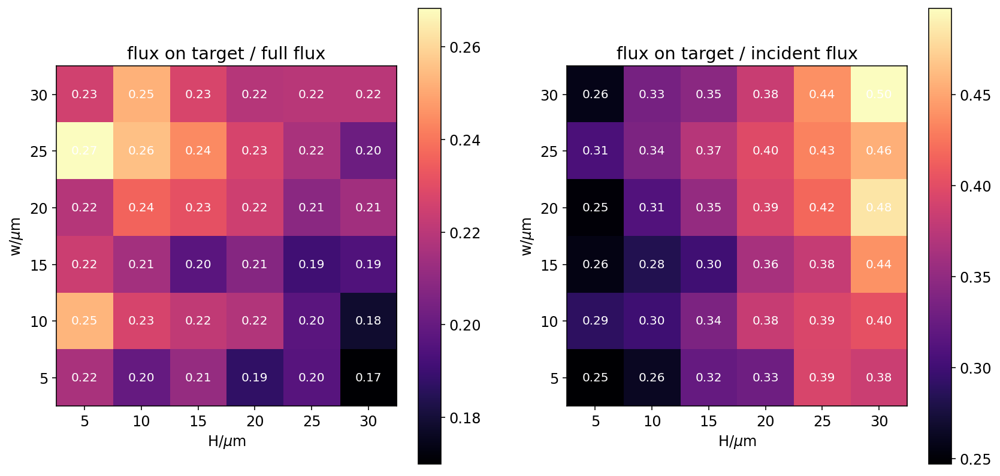

In [110]:

fig, axes = plt.subplots(ncols=2,figsize=(7*2,7))
for merit, ax, this_title in zip([merit_tf_ff, merit_tf_if],
                     axes,
                    ['flux on target / full flux',
                    'flux on target / incident flux']):
    im = ax.imshow(merit,
              origin='lower',
              cmap = 'magma',
              extent=[5-2.5,35-2.5,5-2.5,35-2.5])
    # cax = ax.add_axes([0.95, 0.075, 0.05, 0.85])
    for H_index, H in enumerate(Hs):
        for w_index, w in enumerate(ws): 
            ax.text(H, w, "%.2f" % merit[w_index][H_index],
                    va='center',ha='center',color='white',fontsize=10)
    ax.set_title(this_title)
    fig.colorbar(im, ax=ax)
    ax.set_ylabel('w/$\mu$m')
    ax.set_xlabel('H/$\mu$m')
plt.show()

In [105]:
!pushover "done"

In [119]:
for w in ws:
    for H in Hs:
        #load it
        fname = '/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-%s.pkl' % atlante_parallel[(w,H)]
        metalens = pickle.load(open(fname,'rb'))
        #compute farfields
        metalens = compute_post_simulation_params(metalens)
        plotfname = '/Users/juan/Temp/metalens-%d-%d.png' % (w,H)
        #make and save plot
        this_field = (metalens['farfields']['rho_em'])
        vmin = np.percentile(this_field.flatten(),5)
        vmax = np.percentile(this_field.flatten(),95)
        plt.figure(figsize=(10,5))
        plt.imshow(this_field,
                  cmap=metalens['cmap'],
                  origin='lower',
                  vmin=vmin,
                  vmax=vmax,
                  extent=metalens['full_extent'])
        plt.plot([-metalens['w'], -metalens['w'],-metalens['w'],-metalens['w']-2],
                 [metalens['detector_plane_coordinate']+1,
                 metalens['detector_plane_coordinate']-1,
                 metalens['detector_plane_coordinate'],
                 metalens['detector_plane_coordinate']],
                 'w-')
        plt.plot([metalens['w'], metalens['w'],metalens['w'],metalens['w']+2],
                 [metalens['detector_plane_coordinate']+1,
                 metalens['detector_plane_coordinate']-1,
                 metalens['detector_plane_coordinate'],
                 metalens['detector_plane_coordinate']],
                 'w-')
        plt.plot([60-metalens['R']*0.25,60+metalens['R']*0.25],[20-10]*2,'w-')
        plt.plot([60],[20-metalens['H']*0.25-10],'wx')
        plt.plot([60-metalens['w']*0.25,
                 60+metalens['w']*0.25],[20+metalens['d']*0.25-10]*2,'w-')
        plt.xlabel('x/$\mu$m')
        plt.ylabel('y/$\mu$m')
        plt.text(60,50,'H=%d $\mu$m w=%d $\mu$m' % (w,H),va='center',ha='center',
                color='white')
        plt.xlim(-40,80)
        plt.ylim(metalens['full_extent'][2],53)
        plt.tight_layout()
        print("Saving figure...")
        plt.savefig(plotfname, dpi=300)
        plt.close()

Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Saving figure...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Saving figure...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Saving figure...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
P

Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Saving figure...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Saving figure...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...
Saving figure...
Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_

In [120]:
!say "done"

In [117]:
this_field.shape

(2799, 8100)

In [116]:
pickle.dump(atlante_parallel, open('/Users/juan/Google Drive/Zia Lab/Log/Data/atlante-1.pkl','wb'))

In [474]:
!pushover "done"

### MEEP - flux through target

In [235]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [259]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 20., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 10.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 30.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3 # must be an odd integer
    }
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens['incident_flux'] = get_flux_on_metalens(metalens)
metalens = simulate_metalens(metalens)

In [260]:
metalens = compute_post_simulation_params(metalens)

Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


In [261]:
print("target_flux/incident_flux = %.1f%%"  % (100*metalens['tf/if']))
print("target_flux/full_flux = %.1f%%"  % (100*metalens['tf/ff']))

target_flux/incident_flux = 19.8%
target_flux/full_flux = 5.7%


### MEEP - Flux Capacitor

In [2]:
# given the size of the custom source
# the wavelength
# and the index of refraction
# determine the amount of radiant flux it would emit in 
# a homogeneous medium
# understand how this scales with resolution

* there is no dependence on wavelength
* it is inversely proportional to the refractive index


In [137]:
def source_flux(wave=1.0,
               resolution=30,
               epsilon=1.0):
    metalens = {'sim_cell_width':40,
               'sim_cell_height':20.,
               'pml_width':1,
               'source_width': 0,
               'wavelength':wave,
               'source_coordinate':0,
               'ws':5,
               'x_mirror_symmetry': True,
               'complex_fields': True,
               'resolution':40.,
               'quiet': True,
               'epsilon': epsilon,
               'H': 10.,
               's': 0.}
    metalens['gate_radius'] = metalens['ws']
    metalens['n'] = np.sqrt(metalens['epsilon'])
    metalens['k'] = metalens['n']*2.*np.pi/metalens['wavelength']
    metalens['simulation_time'] = (metalens['source_width']+
                                   3*metalens['n']
                                   *metalens['wavelength']
                                  /metalens['wavelength'])

    # Setup the MEEP objects
    cell = mp.Vector3(metalens['sim_cell_width'],
                      metalens['sim_cell_height'])
    # All around the simulation cell
    pml_layers = [ mp.PML(metalens['pml_width']) ]
    amp_func = far_ez_source_amp_func(metalens)
    # Set up the sources
    sources = [mp.Source(src=mp.ContinuousSource(
                         wavelength=metalens['wavelength'],
                         width=metalens['source_width']
                        ),
              component=mp.Ez,
              center=mp.Vector3(0, metalens['source_coordinate']),
              size=mp.Vector3(2 * metalens['ws'], 0),
              amp_func=amp_func)]
    # Set up the symmetries
    metalens['geometry'] = [mp.Block(size = mp.Vector3(metalens['sim_cell_width'],
                                                metalens['sim_cell_height']),
                            center = mp.Vector3(0,0),
                            material = mp.Medium(epsilon = metalens['epsilon']))]
    syms = []
    if metalens['x_mirror_symmetry']:
        syms.append(mp.Mirror(mp.X))
    sim = mp.Simulation(cell_size=cell,
                boundary_layers=pml_layers,
                geometry=metalens['geometry'],
                force_complex_fields=metalens['complex_fields'],
                symmetries=syms,
                sources=sources,
                resolution=metalens['resolution'])
    mp.quiet(metalens['quiet'])
    sim.init_sim()
    sim.run(until=metalens['simulation_time']) 
    metalens['fields'] = {'Ez': sim.get_array(component=mp.Ez).transpose(),
                          'Hx': sim.get_array(component=mp.Hx).transpose(),
                          'Hy': sim.get_array(component=mp.Hy).transpose()}
    metalens['optical_axis'] = np.linspace(-metalens['sim_cell_height']/2,
                                          metalens['sim_cell_height']/2,
                                          metalens['fields']['Ez'].shape[0])
    metalens['interface_index'] =  np.argmin(
                                   np.abs(metalens['optical_axis']))
    metalens['gate_index'] = metalens['interface_index'] + 1
    metalens['extent'] = [-metalens['sim_cell_height']/2,
                         metalens['sim_cell_height']/2,
                         -metalens['sim_cell_width']/2,
                         metalens['sim_cell_width']/2]
    metalens['transverse_axis'] = (
        np.linspace(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2,
        metalens['fields']['Ez'].shape[1]))
    metalens['source_amps'] = [amp_func(mp.Vector3(x,0)) 
                               for x in metalens['transverse_axis']]
    metalens['fields']['Sy'] = np.real(np.conjugate(metalens['fields']['Ez'])
                              * metalens['fields']['Hx'])
    metalens['Sy_on_gate'] = metalens['fields']['Sy'][metalens['gate_index']]
    metalens['total_flux'] = np.sum(metalens['Sy_on_gate']
            [metalens['transverse_axis']<=metalens['gate_radius']])
    return (np.abs(metalens['source_amps']), metalens['total_flux'])

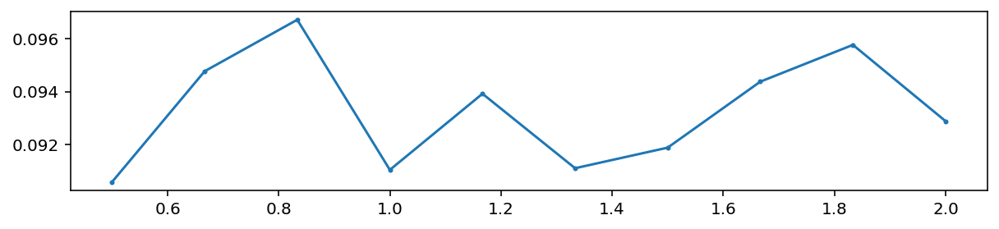

In [138]:
wavelengths = np.linspace(0.5,2,10)
fluxes = np.array([source_flux(wave=wave,
                              resolution=30,
                              epsilon=1.0) for wave in wavelengths])
plt.figure(figsize=(10,2))
plt.plot(wavelengths,
        fluxes[:,1],
        'o-',ms=2)
# plt.ylim(0,0.1)
plt.show()

In [157]:
metalens['geometry']

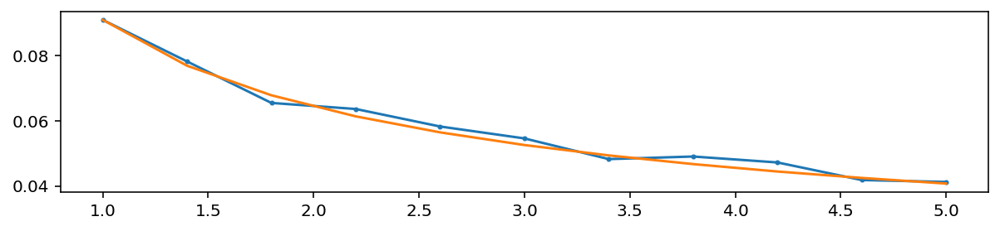

In [147]:
epsilons = np.linspace(1,5.,11)
fluxes = np.array([source_flux(wave=1.0,resolution=30,epsilon=epsilon) for epsilon in epsilons])
plt.figure(figsize=(10,2))
plt.plot(epsilons,
        fluxes[:,1],
        'o-',ms=2)
plt.plot(epsilons,
        fluxes[:,1][0]/np.sqrt(epsilons))
plt.show()

In [155]:
# list(map(lambda x: np.sum(x**2),fluxes[:,0]))

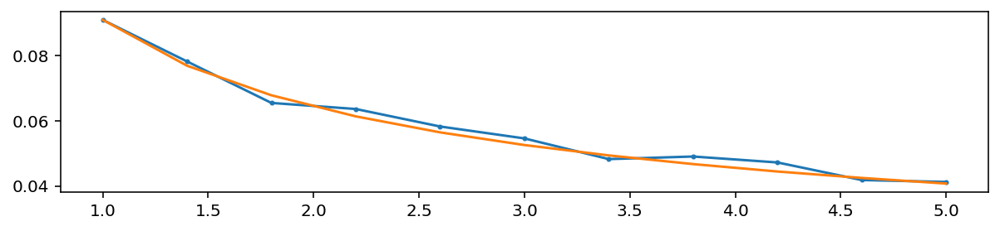

In [148]:
plt.figure(figsize=(10,2))
plt.plot(epsilons,
        fluxes[:,0],
        'o-',ms=2)
plt.plot(epsilons,
        fluxes[:,1][0]/np.sqrt(epsilons))
plt.show()

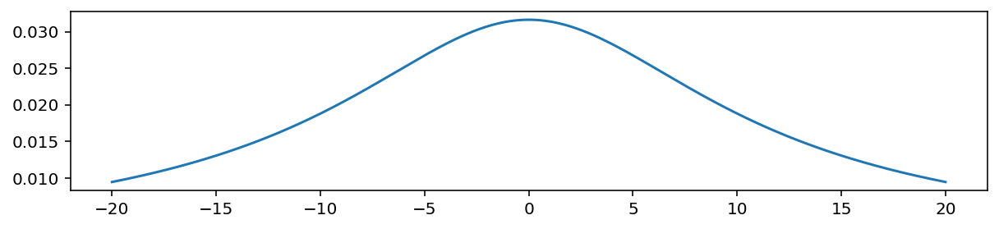

In [114]:
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],
        np.abs(metalens['source_amps']))
plt.show()

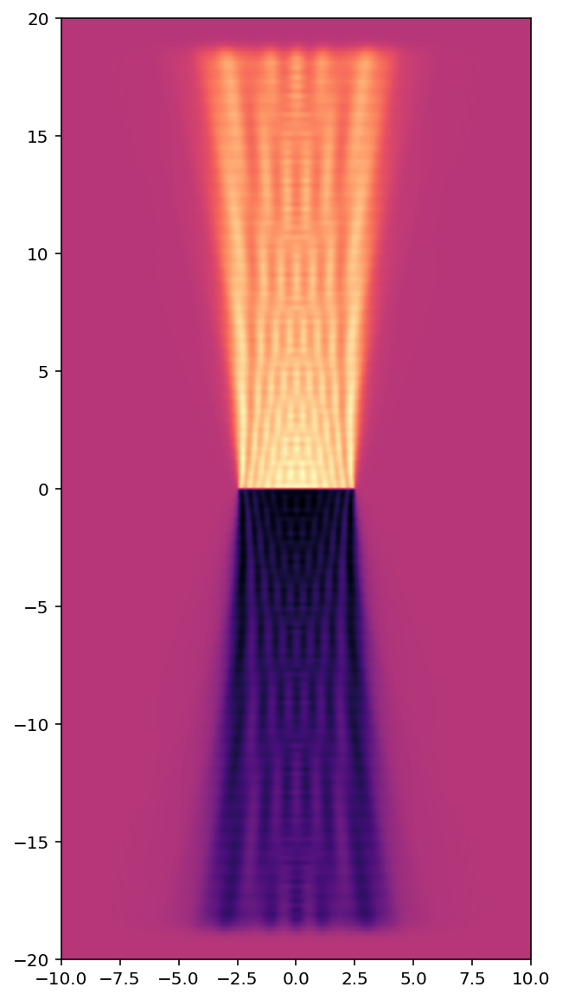

In [66]:
plt.figure(figsize=(10,10))
plt.imshow(np.real(metalens['fields']['Sy']),
          extent=metalens['extent'],
          origin='lower',
          cmap='magma')
plt.show()

### MEEP - change the horizontal gap with improved farfield

In [747]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [759]:
metalenses = []
gap_hs = [0,2,4]
for gap_h in gap_hs:
    os.system('say "[[volm 0.3]] %.1f"' % gap_h)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap_h': gap_h,
        'gap_v': 0.,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False,
        'freq_multiplier': 3}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    metalenses.append(metalens)
del metalens

-----------
Initializing structure...
     block, center = (0,-0.9,0)
          size (52,1,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,1.11022e-16,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,1.11022e-16,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,1.11022e-16,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,1.11022e-16,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,1.11022e-16,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,1.11022e-16,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,1.11022e-16,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,1.11022e-16,0)
          size

In [760]:
!say "done"

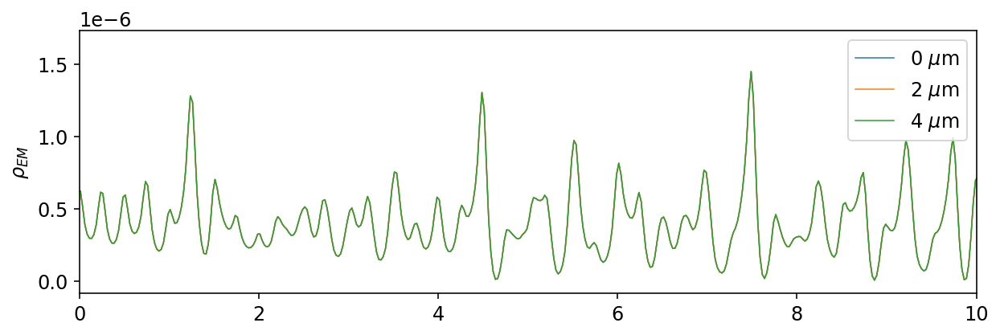

In [761]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for metalens in metalenses:
    strip = (metalens['rho_em'][metalens['nearfield_index']])
    x_axis = metalens['transverse_axis_extended']
    plt.plot(x_axis, strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = metalens['gap_h']))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

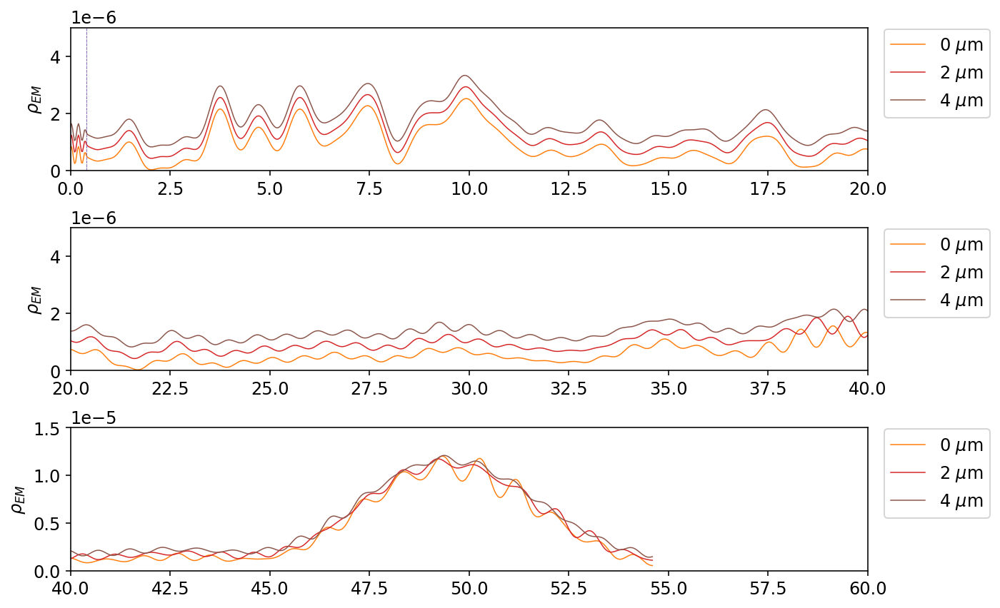

In [762]:
plt.rcParams.update({'font.size': 12})
fig, axes = plt.subplots(nrows=3, figsize=(10,7))
for index2, ax in enumerate(axes):
    for index, metalens in enumerate(metalenses):
        strip = (metalens['rho_em'][:,metalens['optical_axis_index']]
                 + 4*0.01e-5*index)
        x_axis = np.linspace(-metalens['sim_cell_height']/2,
                             metalens['detector_plane_coordinate']
                             + metalens['top_plus'],
                             len(strip))
        ax.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
                lw=0.5)
        ax.plot(x_axis,strip,
                 '-',lw=0.75,
                label="{gap} $\mu$m".format(gap = metalens['gap_h']))
        ax.set_xlim(60./3*index2, 60./3*(index2 + 1))
        ax.set_ylim(0,[0.5,0.5,1.5][index2]*1e-5)
    ax.legend(bbox_to_anchor=(1.01, 1.05),loc="upper left")
    ax.set_ylabel(r'$\rho_{EM}$')
fig.subplots_adjust(hspace=0.4)
plt.show()

### MEEP - zero padding for FFT

In [165]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [229]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 50., # depth of emitter
    'gap_h': 1.0,
    'gap_v': 0.,
    'b': 2.0, # distance between source and interface
    'w': 15.,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 40.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': True,
    'freq_multiplier': 3 # must be an odd integer
    }
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
metalens = simulate_metalens(metalens)

In [233]:
metalens = compute_post_simulation_params(metalens)
#print("FFT/IF = %.1f%%"  % (100*metalens['FTT/IF']))

Computing the farfield for Ez...
Computing the farfield for Hx...
Computing the farfield for Hy...
Computing the farfield for rho_em...
Patching the entire field for Ez...
Patching the entire field for Hx...
Patching the entire field for Hy...
Patching the entire field for rho_em...


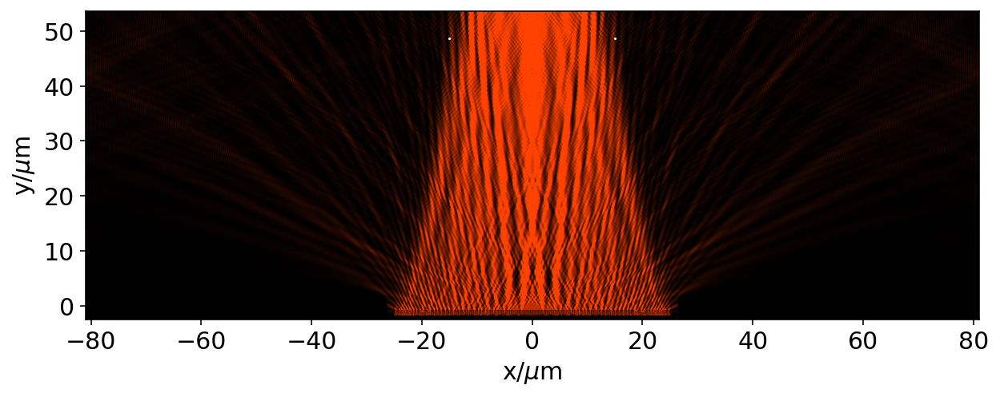

In [202]:
this_field = np.abs(metalens['farfields']['rho_em'])
vmin = np.percentile(this_field.flatten(),5)
vmax = np.percentile(this_field.flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_field,
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wx',
         ms=1)
# plt.ylim(-2,0)
# plt.xlim(0,30)
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.show()

In [913]:
# stitched_rho_em = np.concatenate((metalens['rho_em'],
#                                  metalens['rho_em'],
#                                  metalens['rho_em']),axis=1)

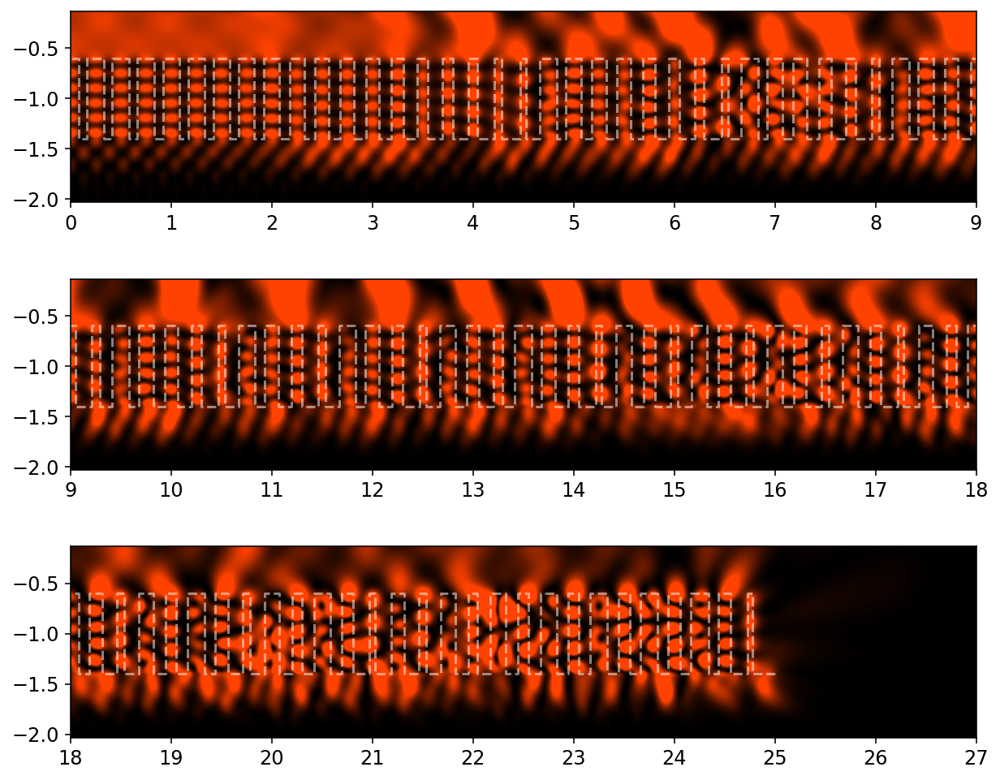

In [914]:
vmin = np.percentile(metalens['farfields']['rho_em'].flatten(),5)
vmax = np.percentile(metalens['farfields']['rho_em'].flatten(),95)
chunks = 3
chunk_width = metalens['sim_cell_width']/chunks/2
aspectratio = (metalens['wavelength']*3)/(chunk_width)
fig, axes = plt.subplots(nrows=chunks,
             figsize=(13,13*aspectratio*chunks))
for chunk, ax in enumerate(axes):
    ax.imshow(metalens['farfields']['rho_em'],
              cmap=metalens['cmap'],
              origin='lower',
              vmin=vmin,
              vmax=vmax,
              extent=metalens['full_extent'])
    ax.plot([-metalens['w'], metalens['w']],
             [metalens['detector_plane_coordinate']]*2,
             'wx',
             ms=1)
    ax.plot(metalens['contour'][:,0],
            metalens['contour'][:,1],'w--',alpha=0.5)
    ax.set_xlim(chunk_width*chunk,chunk_width*(chunk+1))
    ax.set_ylim(metalens['interface_coordinate']-metalens['wavelength']*1,
             metalens['interface_coordinate']+metalens['wavelength']*2)
fig.subplots_adjust(hspace=0.4)
plt.show()

### MEEP - change the horizontal gap

In [537]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [645]:
metalenses = []
gap_hs = [20,40,60,80,100]
for gap_h in gap_hs:
    os.system('say "[[volm 0.3]] %.1f"' % gap_h)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap_h': gap_h,
        'gap_v': 0.,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    metalenses.append(metalens)
del metalens

-----------
Initializing structure...
     block, center = (0,-0.9,0)
          size (92,1,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,1.11022e-16,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,1.11022e-16,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,1.11022e-16,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,1.11022e-16,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,1.11022e-16,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,1.11022e-16,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,1.11022e-16,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,1.11022e-16,0)
          size

Meep progress: 34.025/40.76047077409162 = 83.5% done in 32.1s, 6.3s to go
Meep progress: 38.325/40.76047077409162 = 94.0% done in 36.1s, 2.3s to go
run 0 finished at t = 40.7625 (3261 timesteps)


In [646]:
!say "done"

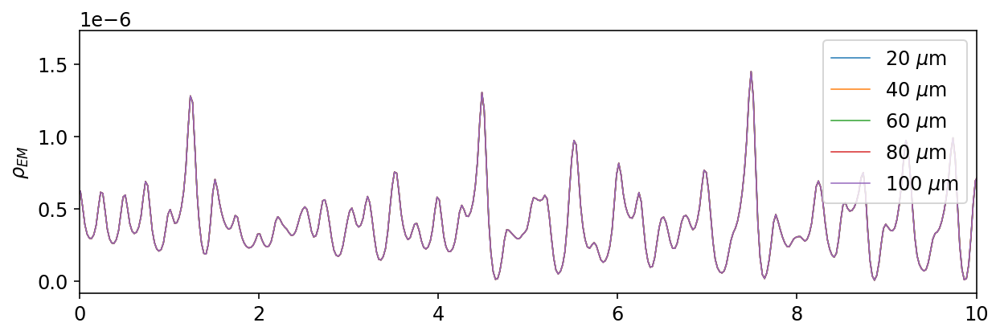

In [647]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for metalens in metalenses:
    strip = (metalens['rho_em'][metalens['nearfield_index']])
    x_axis = metalens['transverse_axis']
    plt.plot(x_axis, strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = metalens['gap_h']))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

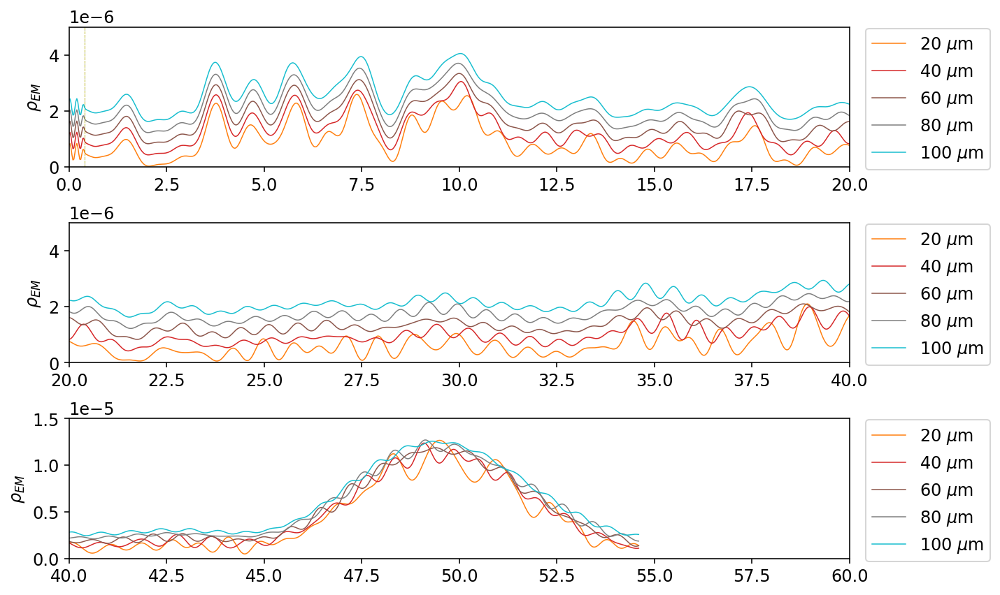

In [648]:
plt.rcParams.update({'font.size': 12})
fig, axes = plt.subplots(nrows=3, figsize=(10,7))
for index2, ax in enumerate(axes):
    for index, metalens in enumerate(metalenses):
        strip = (metalens['rho_em'][:,metalens['optical_axis_index']]
                 + 4*0.01e-5*index)
        x_axis = np.linspace(-metalens['sim_cell_height']/2,
                             metalens['detector_plane_coordinate']
                             + metalens['top_plus'],
                             len(strip))
        ax.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
                lw=0.5)
        ax.plot(x_axis,strip,
                 '-',lw=0.75,
                label="{gap} $\mu$m".format(gap = metalens['gap_h']))
        ax.set_xlim(60./3*index2, 60./3*(index2 + 1))
        ax.set_ylim(0,[0.5,0.5,1.5][index2]*1e-5)
    ax.legend(bbox_to_anchor=(1.01, 1.05),loc="upper left")
    ax.set_ylabel(r'$\rho_{EM}$')
fig.subplots_adjust(hspace=0.4)
plt.show()

In [653]:
kay=np.array([1,2,3])

In [660]:
round(0.9999)

1

In [655]:
padman = np.zeros(len(kay))

In [657]:
np.concatenate((padman, kay, padman))

array([0., 0., 0., 1., 2., 3., 0., 0., 0.])

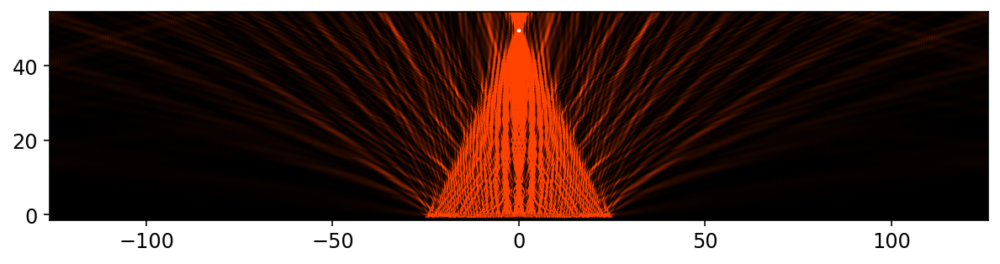

In [651]:
metalens = metalenses[-1]
vmin = np.percentile(metalens['rho_em'].flatten(),5)
vmax = np.percentile(metalens['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wo',
         ms=1)
plt.show()

In [650]:
!pushover "done"

### MEEP - change the vertical gap

In [537]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [630]:
metalenses = []
gap_vs = [0,2,4,6,8]
for gap_v in gap_vs:
    os.system('say %f' % gap_v)
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap_h': 2.,
        'gap_v': gap_v,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 40.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    metalenses.append(metalens)
del metalens

-----------
Initializing structure...
     block, center = (0,-10.9,0)
          size (56,21,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,1.44329e-15,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,1.44329e-15,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,1.44329e-15,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,1.44329e-15,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,1.44329e-15,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,1.44329e-15,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,1.44329e-15,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,1.44329e-15,0)
          si

Meep progress: 5.9625/40.76047077409162 = 14.6% done in 28.2s, 164.6s to go
Meep progress: 6.800000000000001/40.76047077409162 = 16.7% done in 32.2s, 160.8s to go
Meep progress: 7.65/40.76047077409162 = 18.8% done in 36.3s, 156.9s to go
Meep progress: 8.475/40.76047077409162 = 20.8% done in 40.3s, 153.4s to go
Meep progress: 9.3125/40.76047077409162 = 22.8% done in 44.3s, 149.5s to go
Meep progress: 10.162500000000001/40.76047077409162 = 24.9% done in 48.3s, 145.5s to go
Meep progress: 11.0/40.76047077409162 = 27.0% done in 52.3s, 141.6s to go
Meep progress: 11.8375/40.76047077409162 = 29.0% done in 56.3s, 137.7s to go
Meep progress: 12.675/40.76047077409162 = 31.1% done in 60.4s, 133.7s to go
Meep progress: 13.512500000000001/40.76047077409162 = 33.2% done in 64.4s, 129.9s to go
Meep progress: 14.350000000000001/40.76047077409162 = 35.2% done in 68.4s, 126.0s to go
Meep progress: 15.175/40.76047077409162 = 37.2% done in 72.4s, 122.1s to go
Meep progress: 15.975000000000001/40.76047077

In [631]:
!say "done"

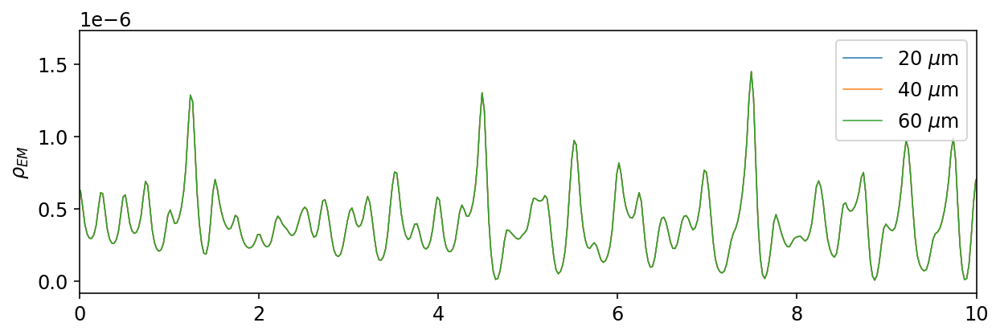

In [632]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for metalens in metalenses:
    strip = (metalens['rho_em'][metalens['nearfield_index']])
    x_axis = metalens['transverse_axis']
    plt.plot(x_axis, strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = metalens['gap_v']))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

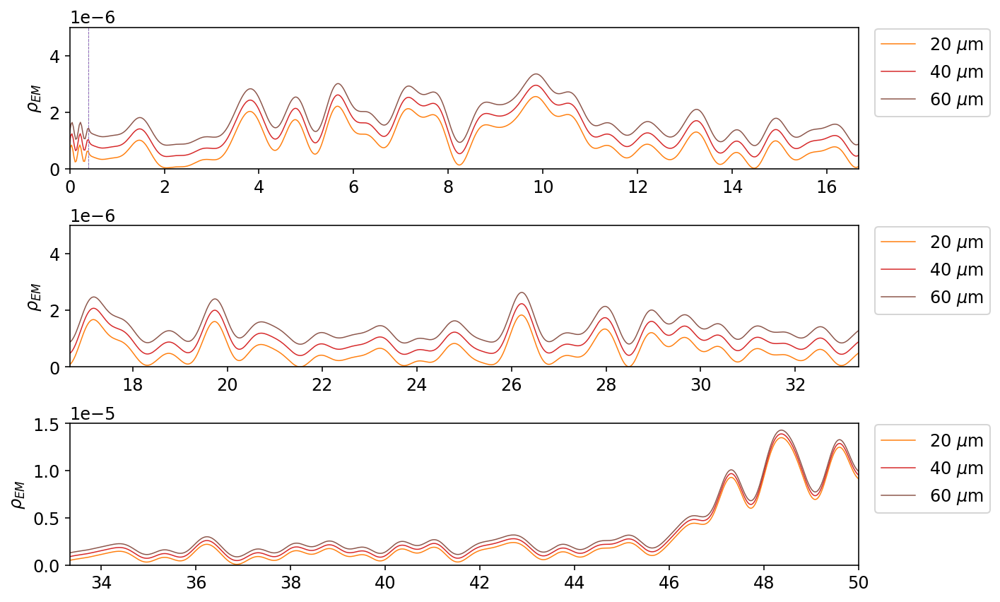

In [635]:
plt.rcParams.update({'font.size': 12})
fig, axes = plt.subplots(nrows=3, figsize=(10,7))
for index2, ax in enumerate(axes):
    for index, metalens in enumerate(metalenses):
        strip = (metalens['rho_em'][:,metalens['optical_axis_index']]
                 + 4*0.01e-5*index)
        x_axis = np.linspace(-metalens['sim_cell_height']/2,
                             metalens['detector_plane_coordinate']
                             + metalens['top_plus'],
                             len(strip))
        ax.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
                lw=0.5)
        ax.plot(x_axis,strip,
                 '-',lw=0.75,
                label="{gap} $\mu$m".format(gap = metalens['gap_v']))
        ax.set_xlim(50/3*index2, 50/3*index2 + 50/3)
        ax.set_ylim(0,[0.5,0.5,1.5][index2]*1e-5)
    ax.legend(bbox_to_anchor=(1.01, 1.05),loc="upper left")
    ax.set_ylabel(r'$\rho_{EM}$')
fig.subplots_adjust(hspace=0.4)
plt.show()

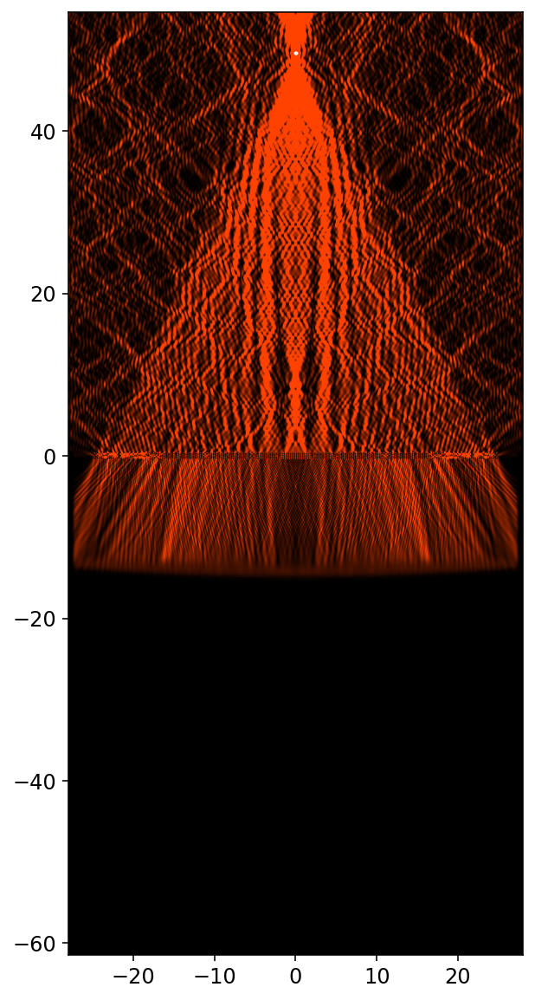

In [638]:
metalens = metalenses[-1]
vmin = np.percentile(metalens['rho_em'].flatten(),5)
vmax = np.percentile(metalens['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wo',
         ms=1)
plt.show()

In [608]:
!pushover "done"

### MEEP - separate vertical and horizontal gaps

In [513]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

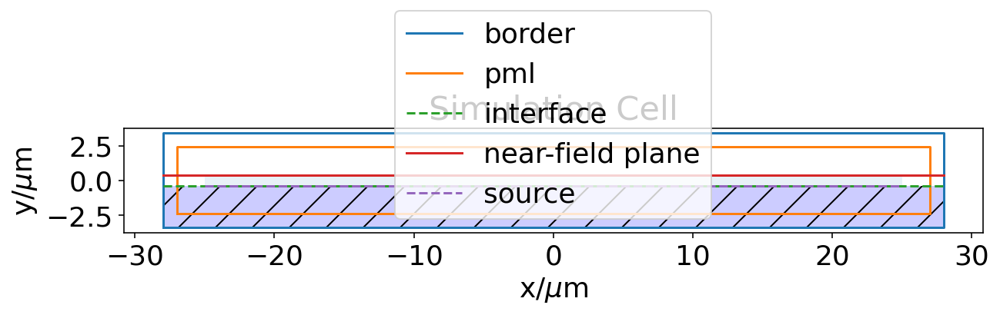

In [514]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 0.0,
    'H': 50., # depth of emitter
    'gap_h': 2.,
    'gap_v': 2.0,
    'b': 0.0,
    'w': 0.1,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1.0,
    'resolution': 50.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True,
    'quiet': False}
metalens = aux_params(metalens)
metalens = make_metalens_geometry(metalens)
plot_simulation_cell(metalens)

In [515]:
metalens = simulate_metalens(metalens)

-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (56,3,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,1.11022e-16,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,1.11022e-16,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,1.11022e-16,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,1.11022e-16,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,1.11022e-16,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,1.11022e-16,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,1.11022e-16,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,1.11022e-16,0)
          size

In [523]:
metalens['optical_axis'] = np.linspace(-metalens['sim_cell_height']/2,
                                        metalens['sim_cell_height']/2,
                                        metalens['fields']['Ez'].shape[0])
metalens['transverse_axis'] = np.linspace(-metalens['sim_cell_width']/2,
                                        metalens['sim_cell_width']/2,
                                        metalens['fields']['Ez'].shape[1])
metalens['optical_axis_index'] = np.argmin(
                                      np.abs(metalens['transverse_axis']))
metalens['top_of_post_index'] = np.argmin(np.abs(metalens['optical_axis']
                                - metalens['top_of_posts_coordinate']))
# far-field propagation
metalens['nearfield_index'] = np.argmin(np.abs(metalens['optical_axis']
                                - metalens['nearfield_coordinate']))                              
metalens['near_Ez_fft'] = np.fft.fft(metalens['fields']
                          ['Ez'][metalens['nearfield_index']])
metalens['kx_frequencies'] = 2*np.pi*np.fft.fftfreq(
                        metalens['fields']['Ez'].shape[1],
                        d=1./metalens['resolution'])
metalens['ky'] = np.sqrt(metalens['k_0']**2-metalens['kx_frequencies']**2+0j)
metalens['detector_Ez_fft'] = (metalens['near_Ez_fft'] 
          * np.exp(1j*metalens['ky']*(
          metalens['detector_plane_coordinate']-
          metalens['nearfield_coordinate'] ))
             )
metalens['detector_Ez'] = np.fft.ifft(metalens['detector_Ez_fft'])

In [526]:
metalens = compute_post_simulation_params(metalens)

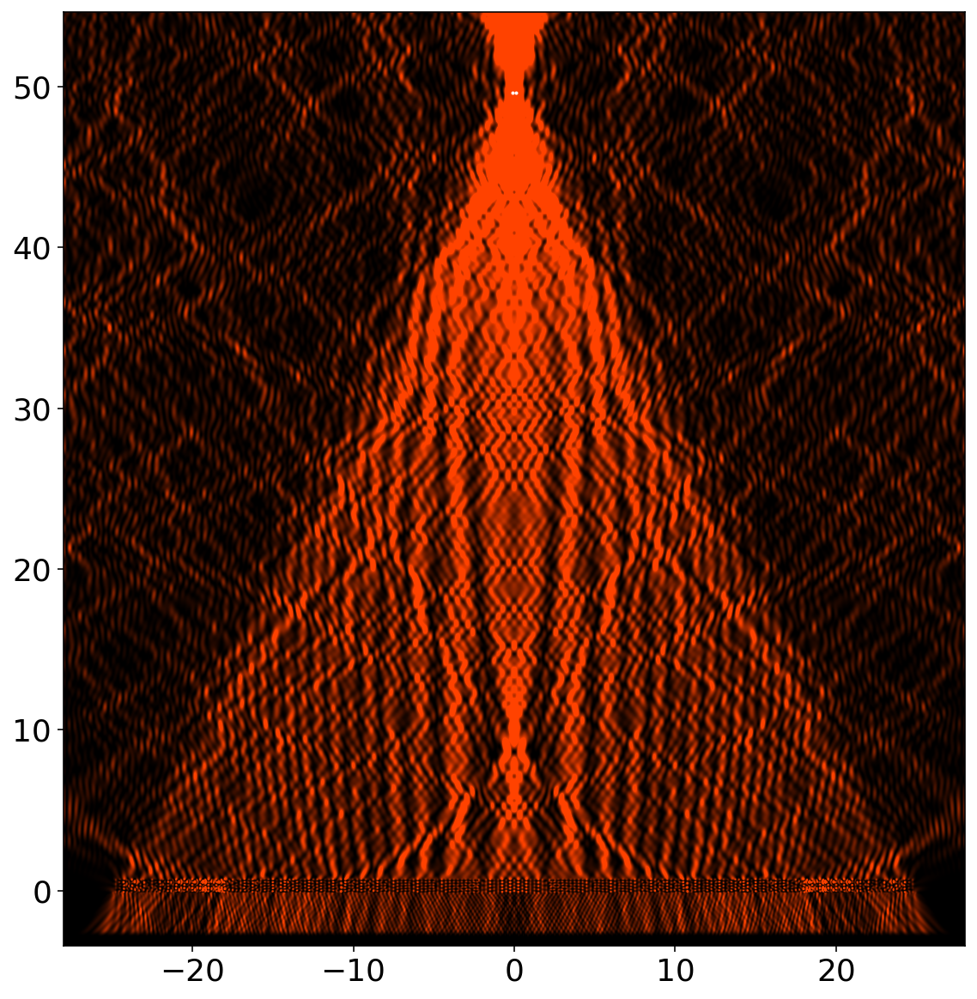

In [536]:
vmin = np.percentile(metalens['rho_em'].flatten(),5)
vmax = np.percentile(metalens['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=metalens['full_extent'])
plt.plot([-metalens['w'], metalens['w']],
         [metalens['detector_plane_coordinate']]*2,
         'wo',
         ms=1)
plt.show()

# Finite Conjugate H=20 um, d=50um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [289]:
simulation_parameters = {
                        'wavelength': 0.633,
                        'post_width': 0.075,
                        'post_height': 0.800,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1}
simulation_parameters = expand_sim_params(simulation_parameters)

In [290]:
results = post_phase(simulation_parameters)

In [291]:
post_widths = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_widths:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_widths)
print(critical_width)

0.18015461198312047


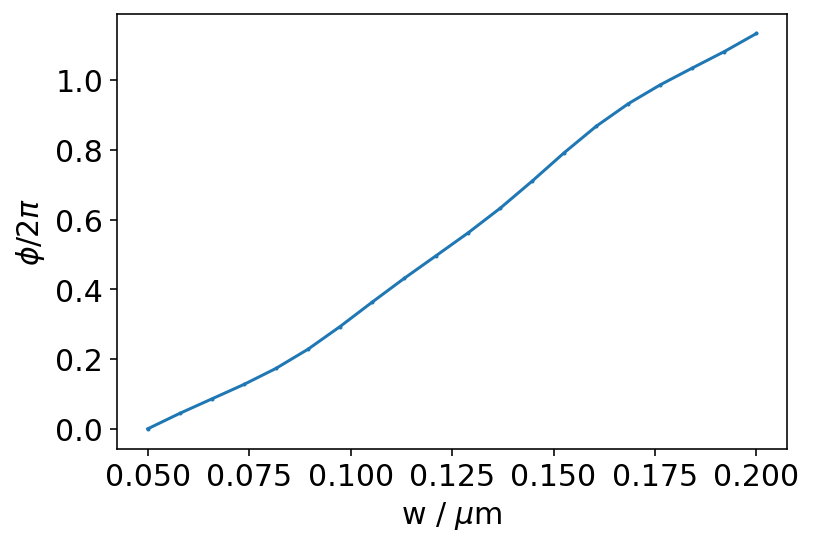

In [292]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_widths,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [293]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_widths':post_widths,'phases': phases,
             'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1585689733


### MEEP - modify the gap

In [303]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [476]:
gaps = [2,4,6,8,10,12]
results = []
for gap in gaps:
    print('gap={gap}'.format(gap=gap))
    metalens = {
        'post_height':simulation_parameters['post_height'],
        'R': 25,
        'd': 50.,
        's': 0.0,
        'H': 50., # depth of emitter
        'gap': gap,
        'b': 0.0,
        'w': 0.1,
        'unit cell size': simulation_parameters['cell_width'],
        'epsilon': simulation_parameters['epsilon'],
        'phases': phases,
        'widths': post_widths,
        'wavelength': simulation_parameters['wavelength'],
        'min_width': 0.05,
        'pml_width': 1.0,
        'resolution': 50.,
        'sim_id': simulation_parameters['sim_id'],
        'simulation_parameters' : simulation_parameters,
        'complex_fields' : True,
        'save_output': False,
        'x_mirror_symmetry': True,
        'quiet': False}
    metalens = aux_params(metalens)
    metalens = make_metalens_geometry(metalens)
    metalens = simulate_metalens(metalens)
    metalens = compute_post_simulation_params(metalens)
    results.append([gap, metalens])

gap=2
-----------
Initializing structure...
     block, center = (0,-1.9,0)
          size (56,3,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,1.11022e-16,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,1.11022e-16,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,1.11022e-16,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,1.11022e-16,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,1.11022e-16,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,1.11022e-16,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,1.11022e-16,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,1.11022e-16,0)
        

Meep progress: 18.78/40.76047077409162 = 46.1% done in 40.1s, 46.9s to go
Meep progress: 20.84/40.76047077409162 = 51.1% done in 44.1s, 42.2s to go
Meep progress: 22.89/40.76047077409162 = 56.2% done in 48.1s, 37.6s to go
Meep progress: 24.95/40.76047077409162 = 61.2% done in 52.1s, 33.0s to go
Meep progress: 26.97/40.76047077409162 = 66.2% done in 56.2s, 28.7s to go
Meep progress: 29.01/40.76047077409162 = 71.2% done in 60.2s, 24.4s to go
Meep progress: 31.060000000000002/40.76047077409162 = 76.2% done in 64.2s, 20.0s to go
Meep progress: 32.910000000000004/40.76047077409162 = 80.7% done in 68.2s, 16.3s to go
Meep progress: 34.910000000000004/40.76047077409162 = 85.6% done in 72.2s, 12.1s to go
Meep progress: 36.95/40.76047077409162 = 90.7% done in 76.2s, 7.9s to go
Meep progress: 38.96/40.76047077409162 = 95.6% done in 80.2s, 3.7s to go
run 0 finished at t = 40.77 (4077 timesteps)
gap=10
-----------
Initializing structure...
     block, center = (0,-5.9,0)
          size (72,11,0)
  

In [477]:
!pushover "done"

libc++abi.dylib: terminating with uncaught exception of type std::runtime_error: Couldn't close file


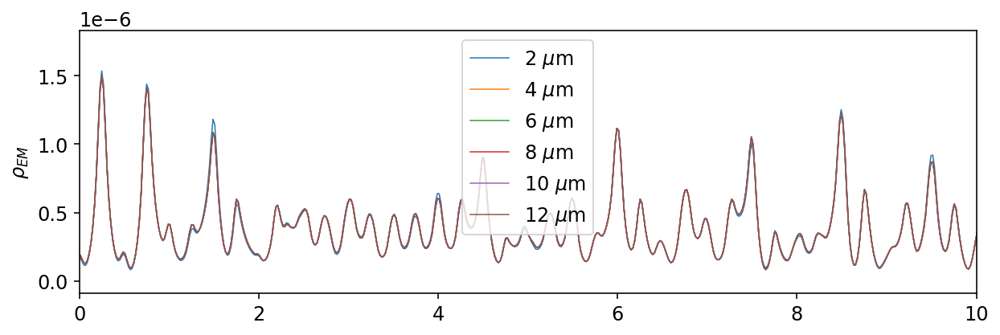

In [507]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for index, result in enumerate(results):
    this_metalens = result[-1]
    strip = (this_metalens['rho_em'][this_metalens['nearfield_index']]
             + 0*0.01e-5*index)
    x_axis = this_metalens['transverse_axis']
    plt.plot(x_axis,strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = result[0]))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,10)
plt.legend()
plt.show()

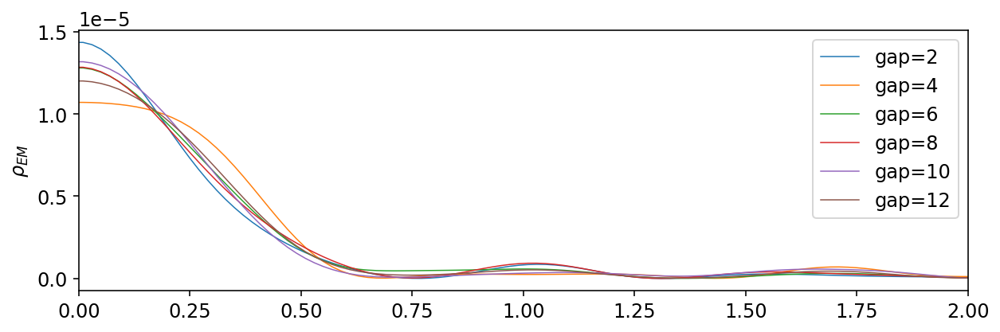

In [479]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for index, result in enumerate(results):
    this_metalens = result[-1]
    strip = (this_metalens['rho_em'][-1*([1,1,1,1,1,1][index])]
             + 0*0.01e-5*index)
    x_axis = this_metalens['transverse_axis']
    plt.plot(x_axis,strip,
             '-',lw=0.75,
            label="gap={gap}".format(gap = result[0]))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(0,2)
plt.legend()
plt.show()

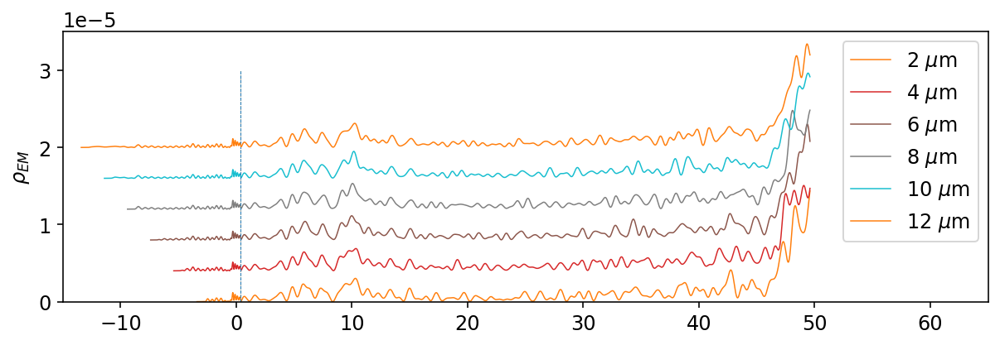

In [502]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
for index, result in enumerate(results):
    this_metalens = result[-1]
    strip = (this_metalens['rho_em'][:,this_metalens['optical_axis_index']]
             + 40*0.01e-5*index)
    x_axis = np.linspace(-this_metalens['sim_cell_height']/2,
                         this_metalens['detector_plane_coordinate'],
                         len(strip))
    plt.plot([metalens['nearfield_coordinate']]*2,[0,3e-5],'--',
            lw=0.5)
    plt.plot(x_axis,strip,
             '-',lw=0.75,
            label="{gap} $\mu$m".format(gap = result[0]))
plt.ylabel(r'$\rho_{EM}$')
plt.xlim(-15,65)
plt.ylim(0,3.5e-5)
plt.legend()
plt.show()

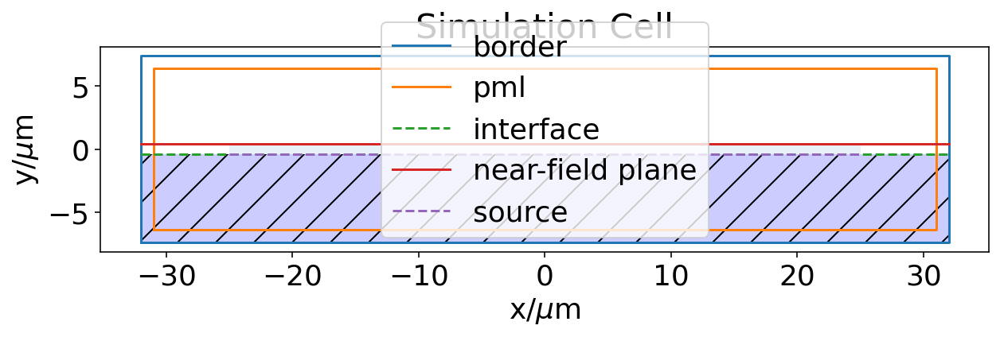

In [369]:
plot_simulation_cell(results[2][-1])

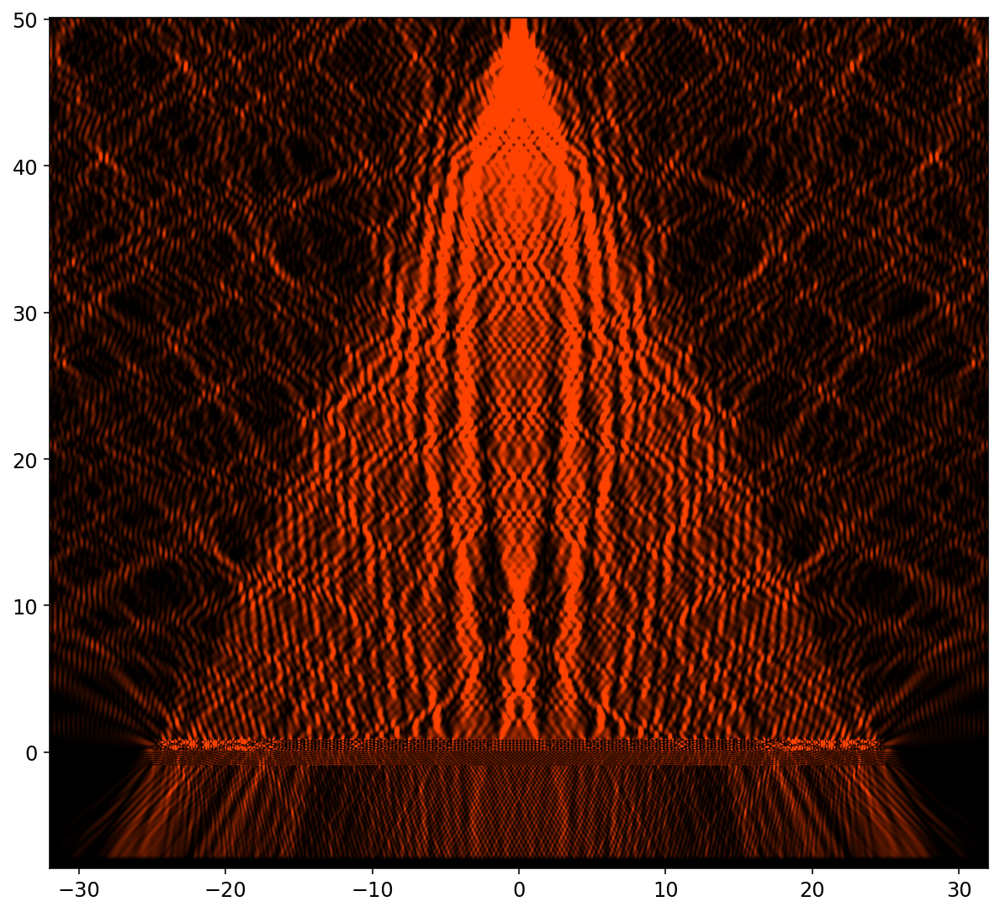

In [438]:
this_one = results[2][-1]
vmin = np.percentile(this_one['rho_em'].flatten(),5)
vmax = np.percentile(this_one['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_one['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=this_one['full_extent'])
plt.show()

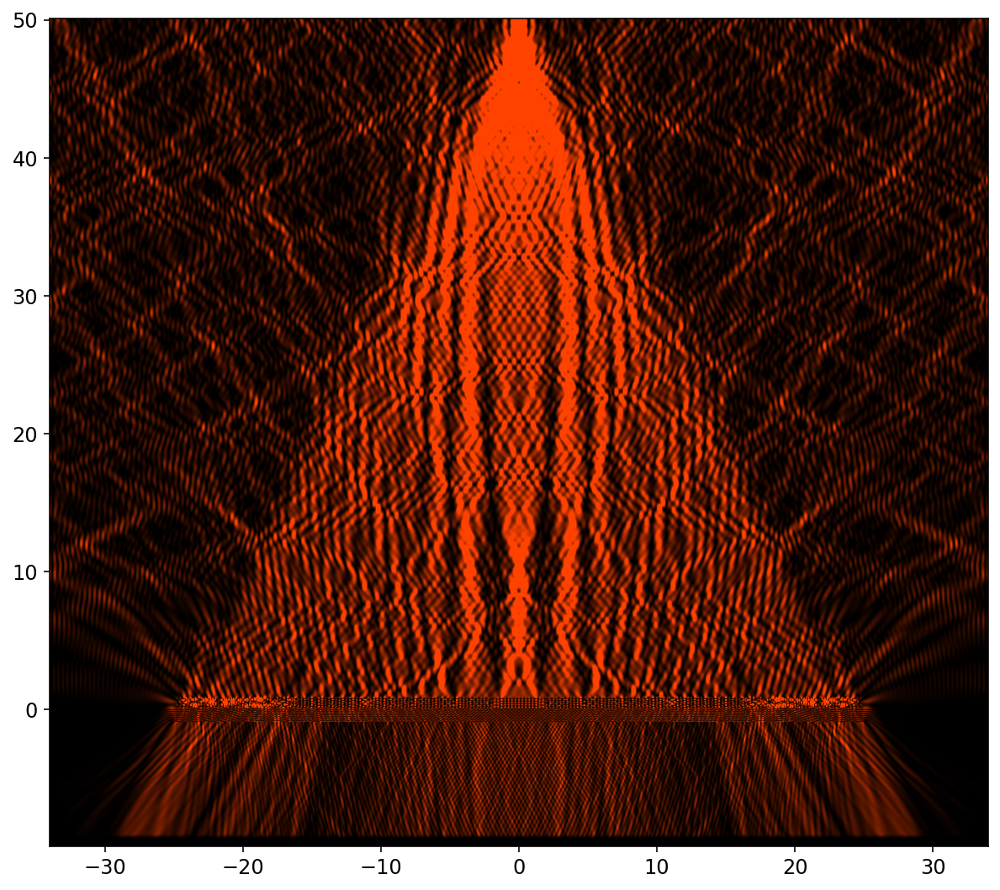

In [437]:
this_one = results[3][-1]
vmin = np.percentile(this_one['rho_em'].flatten(),5)
vmax = np.percentile(this_one['rho_em'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(this_one['rho_em'],
          cmap=metalens['cmap'],
          origin='lower',
          vmin=vmin,
          vmax=vmax,
          extent=this_one['full_extent'])
plt.show()

### MEEP - run varying s and b

In [294]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

In [295]:
bs = [0.,0.25,0.50]
ss = [0.,0.25,0.50]
results = []
for b in bs:
    for s in ss:
        print('{s},{b}'.format(b=b,s=s))
        os.system('say s={s},b={b}'.format(b=b,s=s))
        metalens = {
            'post_height':simulation_parameters['post_height'],
            'R': 25,
            'd': 50.,
            's': s,
            'H': 50., # depth of emitter
            'gap': 4,
            'b': b,
            'w': 0.1,
            'unit cell size': simulation_parameters['cell_width'],
            'epsilon': simulation_parameters['epsilon'],
            'phases': phases,
            'widths': post_widths,
            'wavelength': simulation_parameters['wavelength'],
            'min_width': 0.05,
            'pml_width': 1,
            'resolution': 40.,
            'sim_id': simulation_parameters['sim_id'],
            'simulation_parameters' : simulation_parameters,
            'complex_fields' : True,
            'save_output': False,
            'x_mirror_symmetry': True,
            'quiet': False}
        metalens = aux_params(metalens)
        metalens = make_metalens_geometry(metalens)
        metalens = simulate_metalens(metalens)
        metalens = compute_post_simulation_params(metalens)
        results.append([b,s,metalens['rho_em'][-1]])
    #plot_simulation_cell(metalens)

0.0,0.0
-----------
Initializing structure...
     block, center = (0,-2.9,0)
          size (60,5,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,-3.33067e-16,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,-3.33067e-16,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,-3.33067e-16,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,-3.33067e-16,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,-3.33067e-16,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,-3.33067e-16,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,-3.33067e-16,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,-3.33067e-16,0

     block, center = (0,-3.025,0)
          size (60,5.5,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,0.125,0)
          size (0.05,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,0.125,0)
          size (0.13272,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,0.125,0)
          size (0.0834958,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,0.125,0)
          size (0.150746,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,0.125,0)
          size (0.104183,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,0.125,0)
          size (0.168051,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,0.125,0)
          size (0.121524,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,0.125,0)
          size (0.0620674,0.8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (

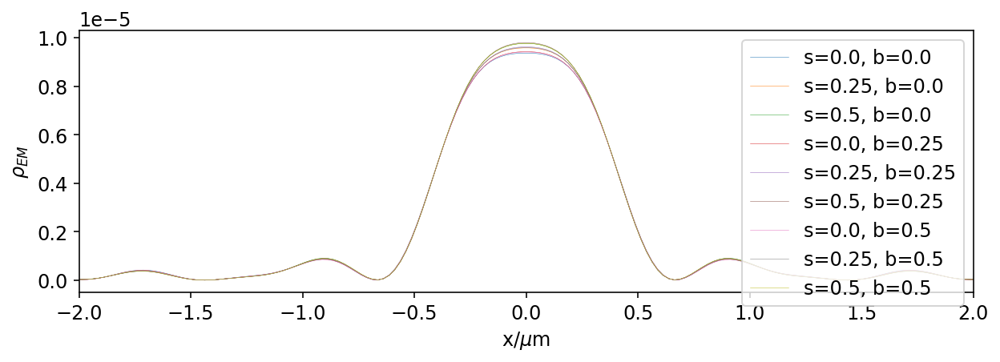

In [300]:
plt.rcParams.update({'font.size': 12})

plt.figure(figsize=(10,3))
for result in results:
#     if result[1] != 0.5:
#         continue
    plt.plot(metalens['transverse_axis'],
             result[-1],
             '-',lw=0.25,
            label="s={s}, b={b}".format(s=result[1], b=result[0]))
plt.xlim(-2,2)
plt.xlabel('x/$\mu$m')
plt.ylabel(r'$\rho_{EM}$')
plt.legend()
plt.show()

In [301]:
differences = []
pivot = results[-1][-1]
for result in results:
    print("b=",result[0],"s=",result[1])
    differences.append(np.sum(np.abs(result[-1]-pivot)))
differences = np.array(differences).reshape((3,3))

b= 0.0 s= 0.0
b= 0.0 s= 0.25
b= 0.0 s= 0.5
b= 0.25 s= 0.0
b= 0.25 s= 0.25
b= 0.25 s= 0.5
b= 0.5 s= 0.0
b= 0.5 s= 0.25
b= 0.5 s= 0.5


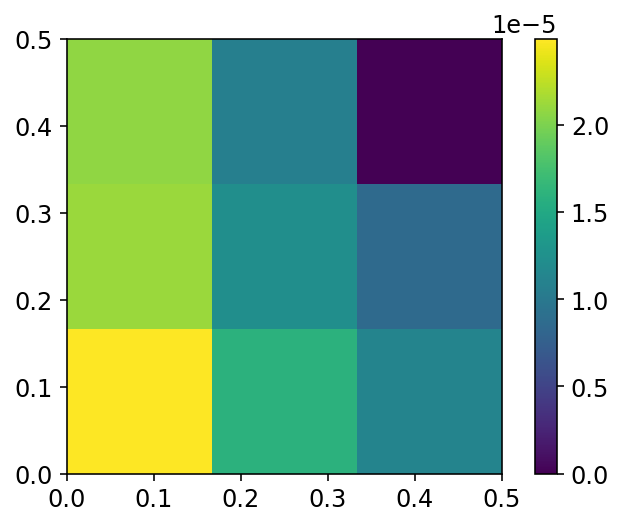

In [302]:
plt.figure()
plt.imshow(differences,origin='lower',
          extent=[0,0.5,0,0.5])
plt.colorbar()
plt.show()

In [ ]:
!say "finished"

In [ ]:
!pushover "done"

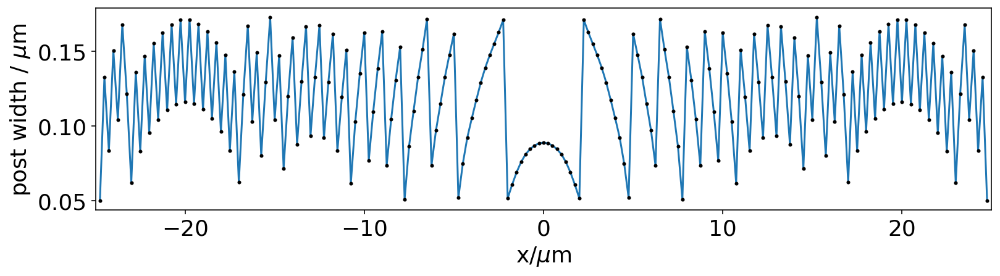

In [234]:
metalens = make_metalens_geometry(metalens)
plot_phase_profile(metalens)
metalens = simulate_metalens(metalens)

In [235]:
metalens=compute_post_simulation_params(metalens)

In [240]:
! pushover "finished"

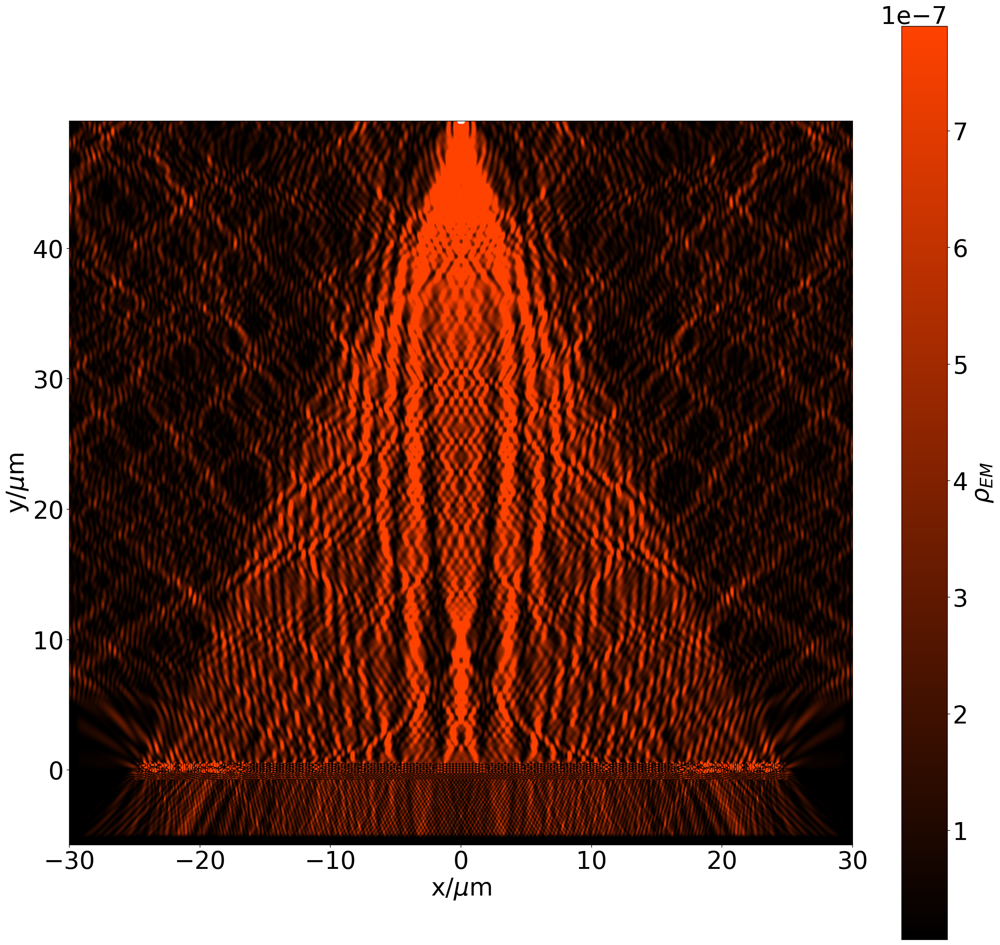

In [283]:
plot_density(metalens,
             'rho_em',
             extra='''''',
            pmin=5,
            pmax=95)

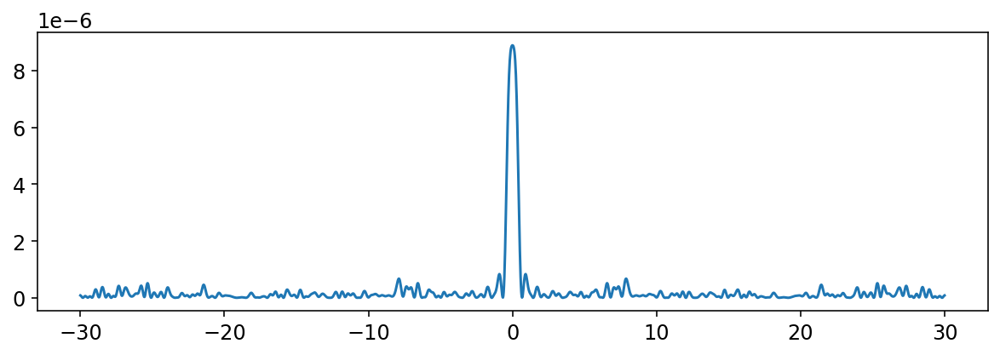

In [238]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

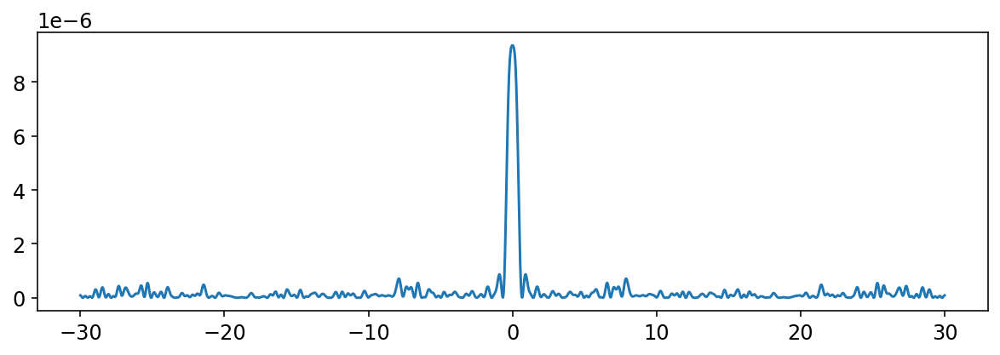

In [226]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

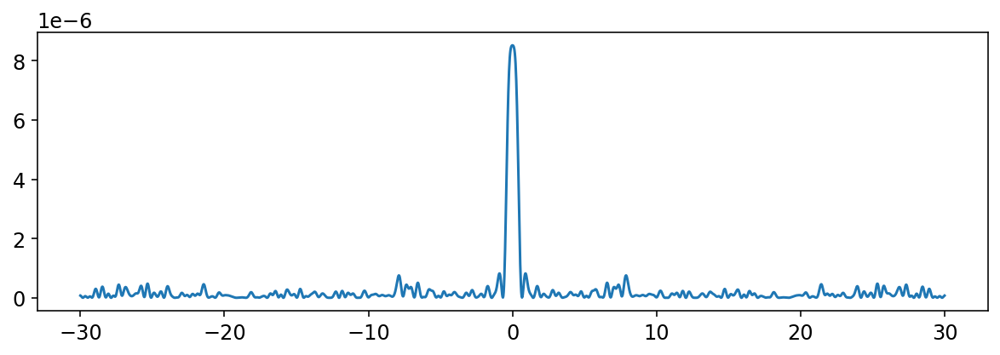

In [232]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

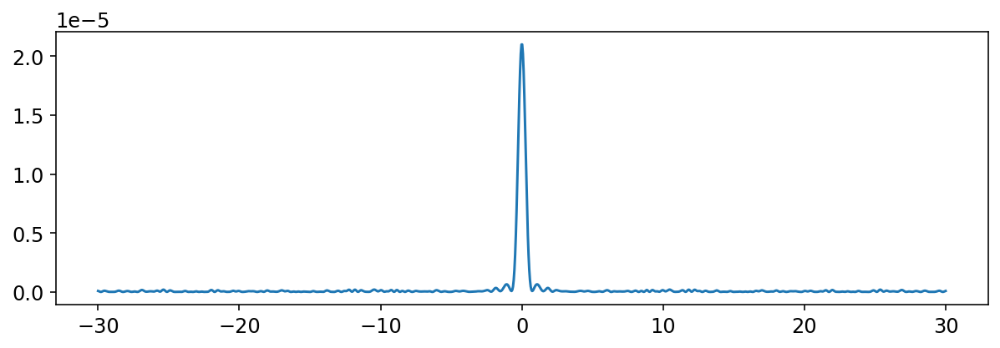

In [214]:
plt.rcParams.update({'font.size': 12})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         metalens['rho_em'][-1])
plt.show()

In [282]:
print_params(metalens)

-------------------------  -----------------------
post_height                0.80
R                          25
d                          50.00
s                          0.50
H                          50.00
gap                        4
b                          0.16
w                          0.10
unit cell size             0.25
epsilon                    5.84
wavelength                 0.63
min_width                  0.05
pml_width                  1
resolution                 40.00
sim_id                     1585680410
complex_fields             True
save_output                False
x_mirror_symmetry          True
quiet                      False
aperture                   50
num of unit cells          199
ws                         25
fcen                       1.58
n                          2.42
TIR_onset_coordinate       22.72
wavelength_rgb             22.72
k                          23.99
cmap                       23.99
k_0                        9.93
sim_cell_width     

# Freespace propagator

In [282]:
# metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1585259134.pkl','rb'))
metalens = pickle.load(open('/Users/juan/Google Drive/Zia Lab/Log/Data/metalens-1585257775.pkl','rb'))

In [283]:
metalens = compute_post_simulation_params(metalens)
metalens['TIR_onset_coordinate'] = np.tan(np.arcsin(1/metalens['n']))*metalens['H']

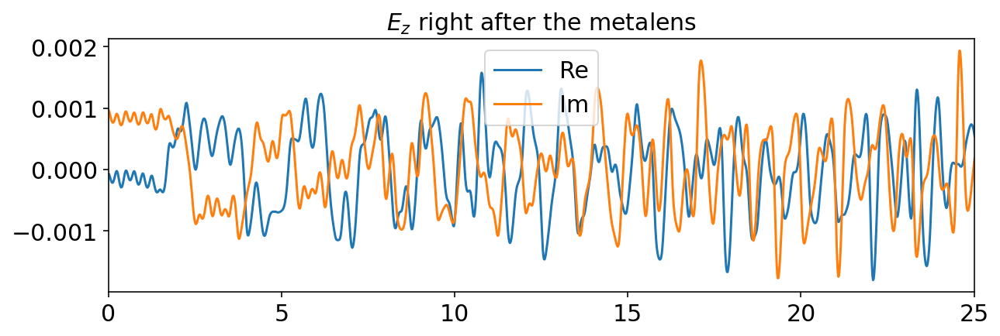

In [290]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         np.real(metalens['fields']
                 ['Ez']
                 [metalens['top_of_post_index']+1]),
        label='Re')
plt.plot(metalens['transverse_axis'],
         np.imag(metalens['fields']
                 ['Ez']
                 [metalens['top_of_post_index']+1]),
        label='Im')
plt.xlim(0,metalens['R'])
plt.legend()
plt.title('$E_z$ right after the metalens',
     fontsize=15)
plt.show()

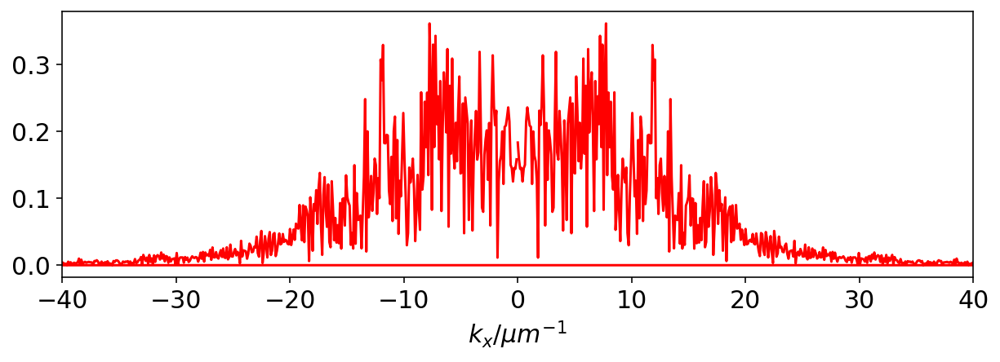

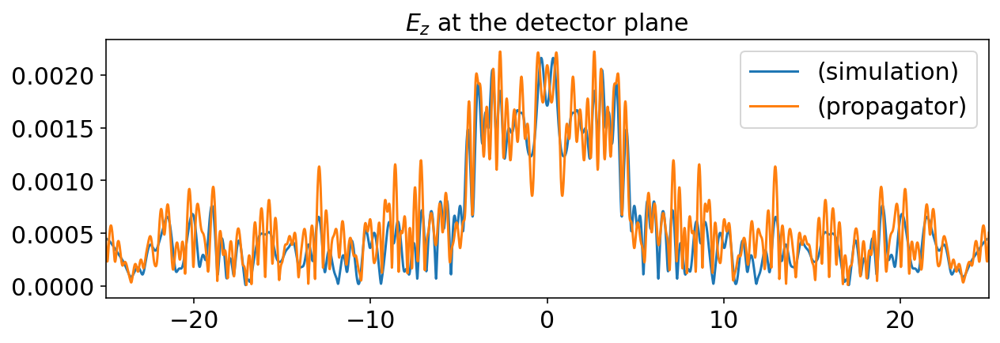

In [295]:
metalens['kx_frequencies'] = 2*np.pi*np.fft.fftfreq(metalens['fields']['Ez'].shape[1],
                                           d=1/metalens['resolution'])
metalens['near_ft_index'] = metalens['top_of_post_index']+1
metalens['near_ft_coordinate'] = (metalens['optical_axis']
                                 [metalens['near_ft_index']])
metalens['near_ft_Ez'] = np.fft.fft(metalens['fields']
                 ['Ez'][metalens['near_ft_index']])
k_sorter = np.argsort(metalens['kx_frequencies'])
metalens['k_0'] = 2*np.pi/metalens['wavelength']
metalens['ky'] = np.sqrt(metalens['k_0']**2-metalens['kx_frequencies']**2+0j)
metalens['detector_ft_Ez'] = (metalens['near_ft_Ez'] 
                              * np.exp(1j*metalens['ky']*(
                              metalens['detector_plane_coordinate']-
                              metalens['near_ft_coordinate'] ))
                             )
metalens['detector_Ez'] = np.fft.ifft(metalens['detector_ft_Ez'])

plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,3))
plt.plot(metalens['kx_frequencies'],
        np.abs(metalens['near_ft_Ez']),
        'r-')
plt.xlim(-40,40)
plt.xlabel('$k_x$/${\mu}m^{-1}$')
plt.show()

plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,3))
plt.plot(metalens['transverse_axis'],
         np.abs(metalens['fields']
                 ['Ez']
                 [metalens['detector_plane_index']]),
        label='(simulation)')
plt.plot(metalens['transverse_axis'],
         np.abs(metalens['detector_Ez']),
        label='(propagator)')
plt.xlim(-metalens['R'],metalens['R'])
plt.legend()
plt.title('$E_z$ at the detector plane',
     fontsize=15)
plt.show()

In [296]:
boost = 1
metalens['optical_axis_for_ff']=np.linspace(metalens['near_ft_coordinate'],
            metalens['detector_plane_coordinate'],
           boost*int((metalens['detector_plane_coordinate']
            -metalens['near_ft_coordinate'])*metalens['resolution']))-metalens['near_ft_coordinate']
metalens['optical_axis_for_ff']=metalens['optical_axis_for_ff'].reshape((len(metalens['optical_axis_for_ff']),1))
metalens['Ez_ft'] = (metalens['near_ft_Ez'] 
                     * np.exp(boost*1j*metalens['ky']*metalens['optical_axis_for_ff']))
metalens['Ez_ff'] = np.fft.ifft(metalens['Ez_ft'])

In [297]:
metalens['Ez_ff_squared'] = np.abs(metalens['Ez_ff'])**2

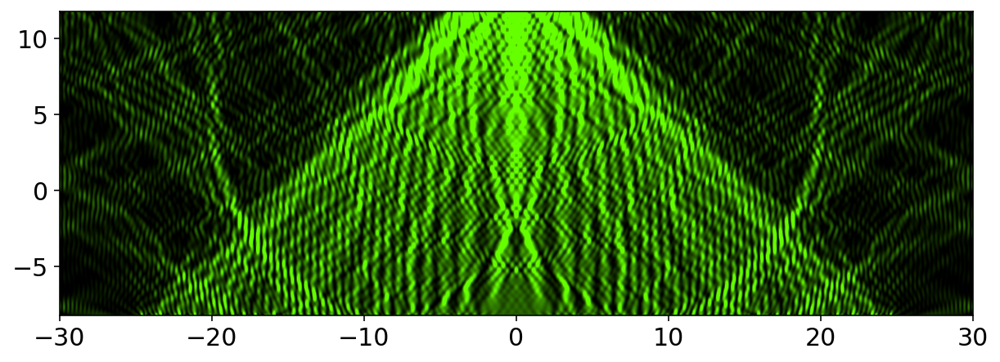

In [298]:
vmin = np.percentile(metalens['Ez_ff_squared'].flatten(),5)
vmax = np.percentile(metalens['Ez_ff_squared'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['Ez_ff_squared'],origin='lower',
           cmap=metalens['cmap'],
           norm=Normalize(vmin=vmin, vmax=vmax),
          extent=[-metalens['sim_cell_width']/2,
                 metalens['sim_cell_width']/2,
                 min(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate'],
                 boost*max(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate']])
plt.show()

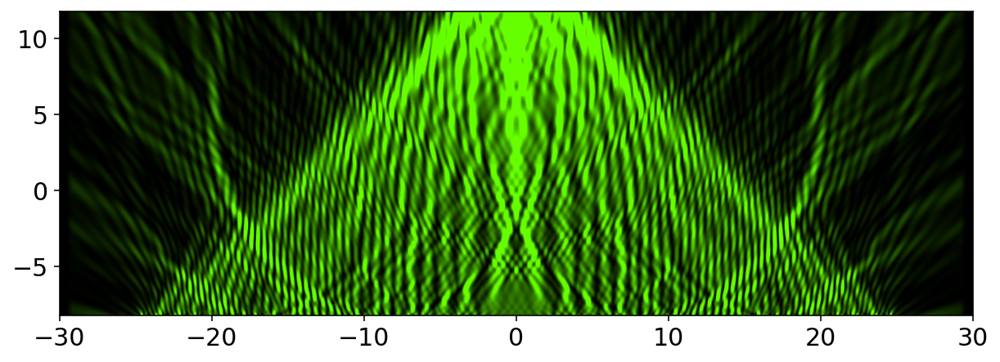

In [299]:
metalens['e2'] = np.abs(metalens['fields']['Ez'])**2
vmin = np.percentile(metalens['e2'].flatten(),5)
vmax = np.percentile(metalens['e2'].flatten(),95)
plt.figure(figsize=(10,10))
plt.imshow(metalens['e2'],origin='lower',
           cmap=metalens['cmap'],
           norm=Normalize(vmin=vmin, vmax=vmax),
          extent=metalens['extent'])
plt.ylim(min(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate'],
         max(metalens['optical_axis_for_ff'])+metalens['near_ft_coordinate'])
plt.show()

# MEEP point sources

### Ez point source

In [215]:
metasource = {'sim_cell_width': 20,
             'sim_cell_height': 20,
             'pml_width': 1,
             'wavelength': 0.532,
             'resolution': 50.}
metasource['k'] = 2*np.pi/metasource['wavelength']
metasource['simulation_time'] = metasource['sim_cell_height']/2.
metasource['extent'] = [-metasource['sim_cell_width']/2,
                       metasource['sim_cell_width']/2,
                        -metasource['sim_cell_height']/2,
                       metasource['sim_cell_height']/2,
                       ]

# Setup the MEEP objects
cell = mp.Vector3(metasource['sim_cell_width'],
                  metasource['sim_cell_height'])
# All around the simulation cell
pml_layers = [mp.PML(metasource['pml_width'])]

# Let sources be continuous
sources = [mp.Source(src=mp.ContinuousSource(
            wavelength=metasource['wavelength'],
            width = 0.),
          component=mp.Ez,
          center=mp.Vector3(0.,0.),
          size=mp.Vector3(0.,0.))]
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=[],
            force_complex_fields = True,
            symmetries = syms,
            sources=sources,
            resolution=metasource['resolution'])
start_time = time.time()
metasource['run_date'] = datetime.datetime.now().strftime("%b %d %Y at %H:%M:%S")
sim.init_sim()
sim.run(until=1*metasource['simulation_time']) 

metasource['run_time_in_s'] = time.time() - start_time
metasource['fields'] = {'Ez': sim.get_array(component=mp.Ez).transpose()}
#pickle.dump(metalens, open('%smetalens-%s.pkl' % (datadir, metalens['sim_id']),'wb'))

-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 3.23/10.0 = 32.3% done in 4.0s, 8.4s to go
Meep progress: 6.18/10.0 = 61.8% done in 8.0s, 5.0s to go
Meep progress: 9.47/10.0 = 94.7% done in 12.0s, 0.7s to go
run 0 finished at t = 10.0 (1000 timesteps)


/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/site-packages/ipykernel_launcher.py:4: ComplexWarning: Casting complex values to real discards the imaginary part
  after removing the cwd from sys.path.
/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/site-packages/ipykernel_launcher.py:10: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  # Remove the CWD from sys.path while we load stuff.


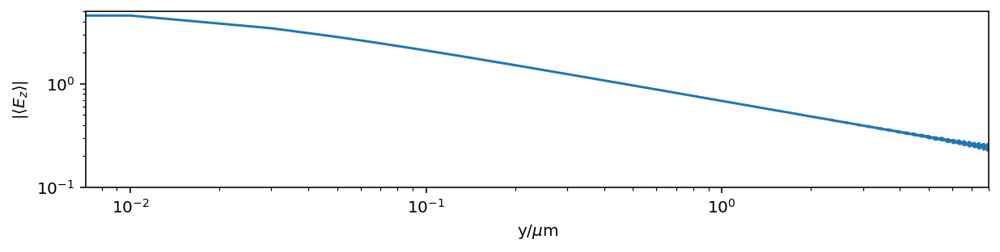

In [223]:
bits = []
for x,y in zip(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt((metasource['fields']['Ez']))[:,500]):
    bits.append("{%f,%f},"%(x,y))
pyperclip.copy(''.join(bits))
plt.figure(figsize=(10,2))
plt.loglog(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           (np.abs(metasource['fields']['Ez']))[:,500])
plt.ylim(0.1,5)
plt.xlim(0,8)
plt.xlabel('y/$\mu$m')
plt.ylabel('$|\langle E_z {\\rangle}|$')
plt.show()

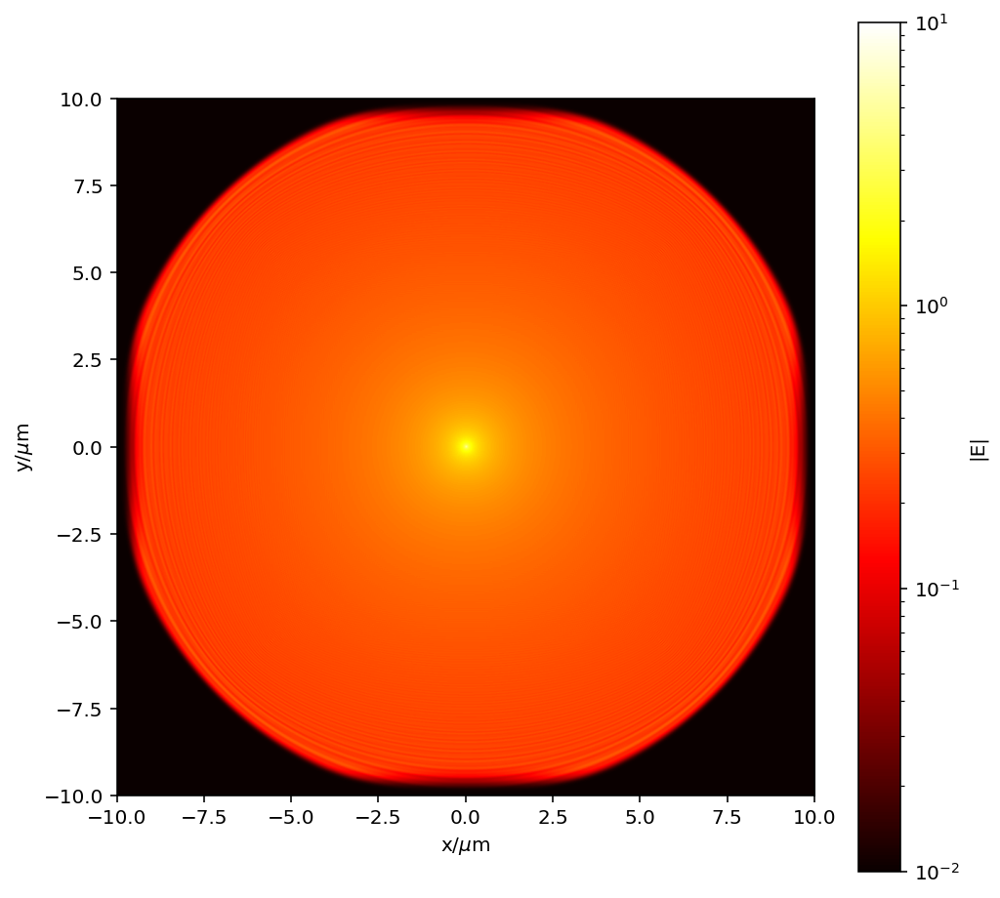

In [221]:
plt.figure(figsize=(8,8))
plt.imshow(10**(-2)+np.abs((metasource['fields']['Ez'])),
           origin='lower',
           cmap='hot',
          extent=metasource['extent'],
          norm=LogNorm(vmin=10**(-2),vmax=10))
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.colorbar(label='|E|')
plt.show()

### Ex point source

In [171]:
metasource = {'sim_cell_width': 20,
             'sim_cell_height': 20,
             'pml_width': 1,
             'wavelength': 0.532,
             'resolution': 50.}
metasource['k'] = 2*np.pi/metasource['wavelength']
metasource['simulation_time'] = metasource['sim_cell_height']/2.
metasource['extent'] = [-metasource['sim_cell_width']/2,
                       metasource['sim_cell_width']/2,
                        -metasource['sim_cell_height']/2,
                       metasource['sim_cell_height']/2,
                       ]

# Setup the MEEP objects
cell = mp.Vector3(metasource['sim_cell_width'],
                  metasource['sim_cell_height'])
# All around the simulation cell
pml_layers = [mp.PML(metasource['pml_width'])]

# Let sources be continuous
sources = [mp.Source(src=mp.ContinuousSource(
            wavelength=metasource['wavelength'],
            width = 0.),
          component=mp.Ex,
          center=mp.Vector3(0.,0.),
          size=mp.Vector3(0.,0.))]
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=[],
            force_complex_fields = True,
            symmetries = syms,
            sources=sources,
            resolution=metasource['resolution'])
start_time = time.time()
metasource['run_date'] = datetime.datetime.now().strftime("%b %d %Y at %H:%M:%S")
sim.init_sim()
sim.run(until=1*metasource['simulation_time']) 

metasource['run_time_in_s'] = time.time() - start_time
metasource['fields'] = {'Ex': sim.get_array(component=mp.Ex).transpose(),
                      'Ey': sim.get_array(component=mp.Ey).transpose()}
#pickle.dump(metalens, open('%smetalens-%s.pkl' % (datadir, metalens['sim_id']),'wb'))

-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 2.58/10.0 = 25.8% done in 4.0s, 11.5s to go
Meep progress: 5.72/10.0 = 57.2% done in 8.0s, 6.0s to go
Meep progress: 8.86/10.0 = 88.6% done in 12.0s, 1.5s to go
run 0 finished at t = 10.0 (1000 timesteps)


/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/site-packages/ipykernel_launcher.py:10: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  # Remove the CWD from sys.path while we load stuff.


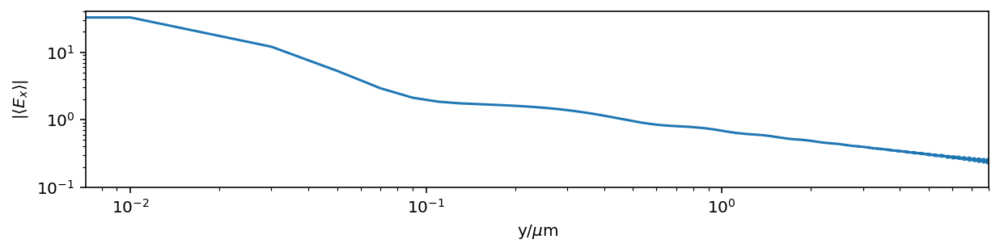

In [212]:
bits = []
for x,y in zip(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[:,500]):
    bits.append("{%f,%f},"%(x,y))
pyperclip.copy(''.join(bits))
plt.figure(figsize=(10,2))
plt.loglog(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[:,500])
plt.ylim(0.1,40)
plt.xlim(0,8)
plt.xlabel('y/$\mu$m')
plt.ylabel('$|\langle E_x {\\rangle}|$')
plt.show()

/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/site-packages/ipykernel_launcher.py:11: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  # This is added back by InteractiveShellApp.init_path()


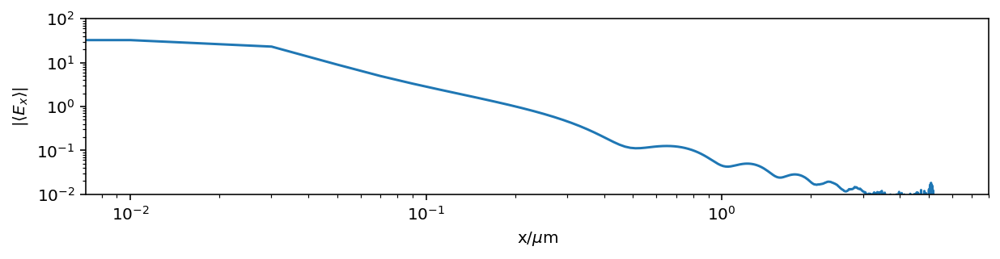

In [213]:
bits = []
for x,y in zip(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[500]):
    bits.append("{%f,%f},"%(x,y))
pyperclip.copy(''.join(bits))

plt.figure(figsize=(10,2))
plt.loglog(np.linspace(-metasource['sim_cell_width']/2,metasource['sim_cell_width']/2,1000),
           np.sqrt(np.abs(metasource['fields']['Ex'])**2+np.abs(metasource['fields']['Ey'])**2)[500])
plt.ylim(1e-2,100)
plt.xlim(0,8)
plt.xlabel('x/$\mu$m')
plt.ylabel('$|\langle E_x {\\rangle}|$')
plt.show()

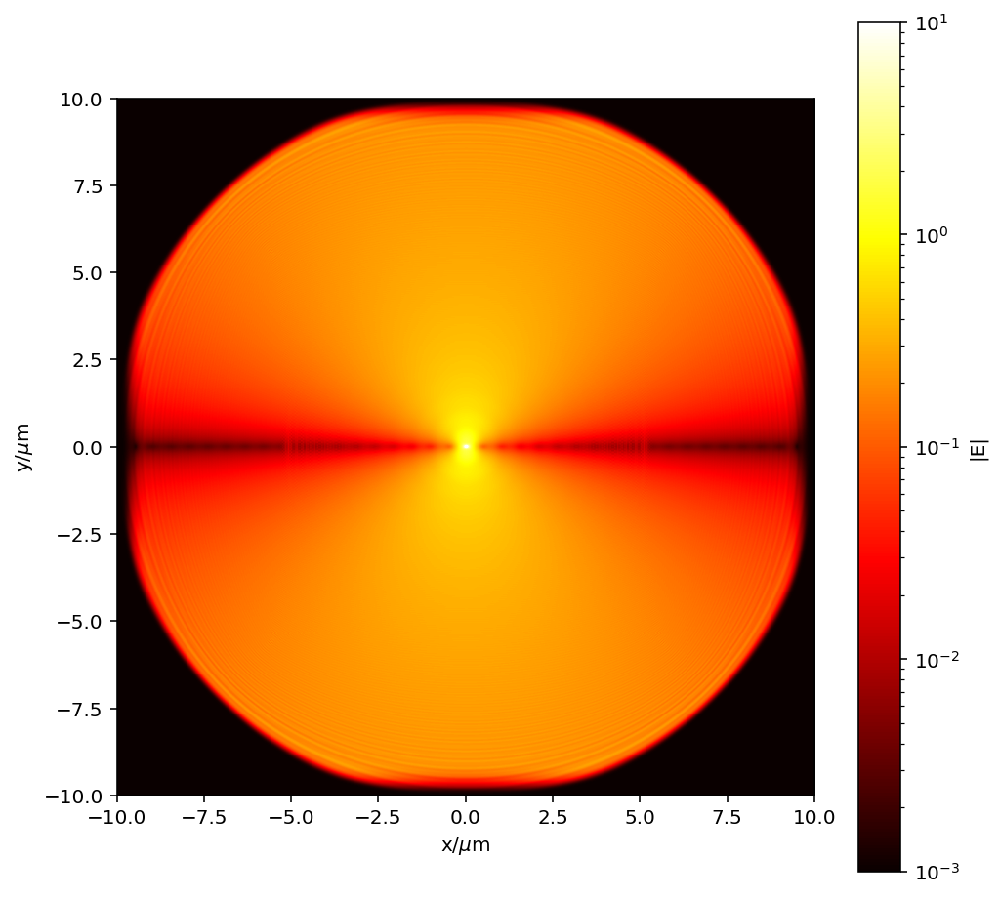

In [208]:
plt.figure(figsize=(8,8))
plt.imshow(10**(-3)+np.sqrt(np.abs(metasource['fields']['Ex'])**2+
                           np.abs(metasource['fields']['Ey'])**2),
           origin='lower',
           cmap='hot',
          extent=metasource['extent'],
          norm=LogNorm(vmin=10**(-3),vmax=10))
plt.xlabel('x/$\mu$m')
plt.ylabel('y/$\mu$m')
plt.colorbar(label='|E|')
plt.show()

## Ez Point source outside of sim cell

In [539]:
metasource = {'sim_cell_width': 20,
             'sim_cell_height': 20,
             'point_source_depth': 2.0,
             'pml_width': 1,
             'wavelength': 0.532,
             'resolution': 40.,
             'gap':1}
metasource['ws'] = (metasource['sim_cell_width'] 
                    - 2*metasource['pml_width']
                    - 2*metasource['gap'])/2.
metasource['k'] = 2*np.pi/metasource['wavelength']
metasource['simulation_time'] = 3.0*np.sqrt(metasource['ws']**2+
                                       metasource['point_source_depth']**2)
metasource['extent'] = [-metasource['sim_cell_width']/2,
                       metasource['sim_cell_width']/2,
                        -metasource['sim_cell_height']/2,
                       metasource['sim_cell_height']/2,
                       ]

def far_dip_amp_fun_maker(metasource):
    def far_dip(mpvec):
        r_mag = np.sqrt(mpvec.x**2
                +metasource['point_source_depth']**2)
        the_phase = np.exp(1j*metasource['k']*r_mag)
        the_amplitude = 1./(r_mag)**1.5
        return the_phase * the_amplitude
    return far_dip
# Setup the MEEP objects
cell = mp.Vector3(metasource['sim_cell_width'],
          metasource['sim_cell_height'])
# All around the simulation cell
pml_layers = [mp.PML(metasource['pml_width'])]

# Let sources be continuous
sources = [mp.Source(src=mp.ContinuousSource(
            wavelength=metasource['wavelength'],
            width = 0.),
          component=mp.Ez,
          center=mp.Vector3(0,0),
          size=mp.Vector3(2*metasource['ws'],0),
          amp_func=far_dip_amp_fun_maker(metasource))]
syms = []
sim = mp.Simulation(cell_size=cell,
            boundary_layers=pml_layers,
            geometry=[],
            force_complex_fields = True,
            symmetries = syms,
            sources=sources,
            resolution=metasource['resolution'])
start_time = time.time()
metasource['run_date'] = datetime.datetime.now().strftime("%b %d %Y at %H:%M:%S")
sim.init_sim()
sim.run(until=1*metasource['simulation_time']) 

metasource['run_time_in_s'] = time.time() - start_time
metasource['fields'] = {'Ez': sim.get_array(component=mp.Ez).transpose(),
                      'Bx': sim.get_array(component=mp.Bx).transpose(),
                      'By': sim.get_array(component=mp.By).transpose()}
#pickle.dump(metalens, open('%smetalens-%s.pkl' % (datadir, metalens['sim_id']),'wb'))
metasource['rho_em'] = 0.5*np.abs(metasource['fields']['Ez'])**2
xlist = np.linspace(-metasource['sim_cell_width']/2,
                    metasource['sim_cell_width']/2,
                   metasource['fields']['Ez'].shape[0])

-----------
Initializing structure...
Meep: using complex fields.
Meep progress: 7.3500000000000005/24.73863375370596 = 29.7% done in 4.0s, 9.5s to go
Meep progress: 14.5/24.73863375370596 = 58.6% done in 8.0s, 5.7s to go
Meep progress: 20.75/24.73863375370596 = 83.9% done in 12.0s, 2.3s to go
run 0 finished at t = 24.75 (1980 timesteps)


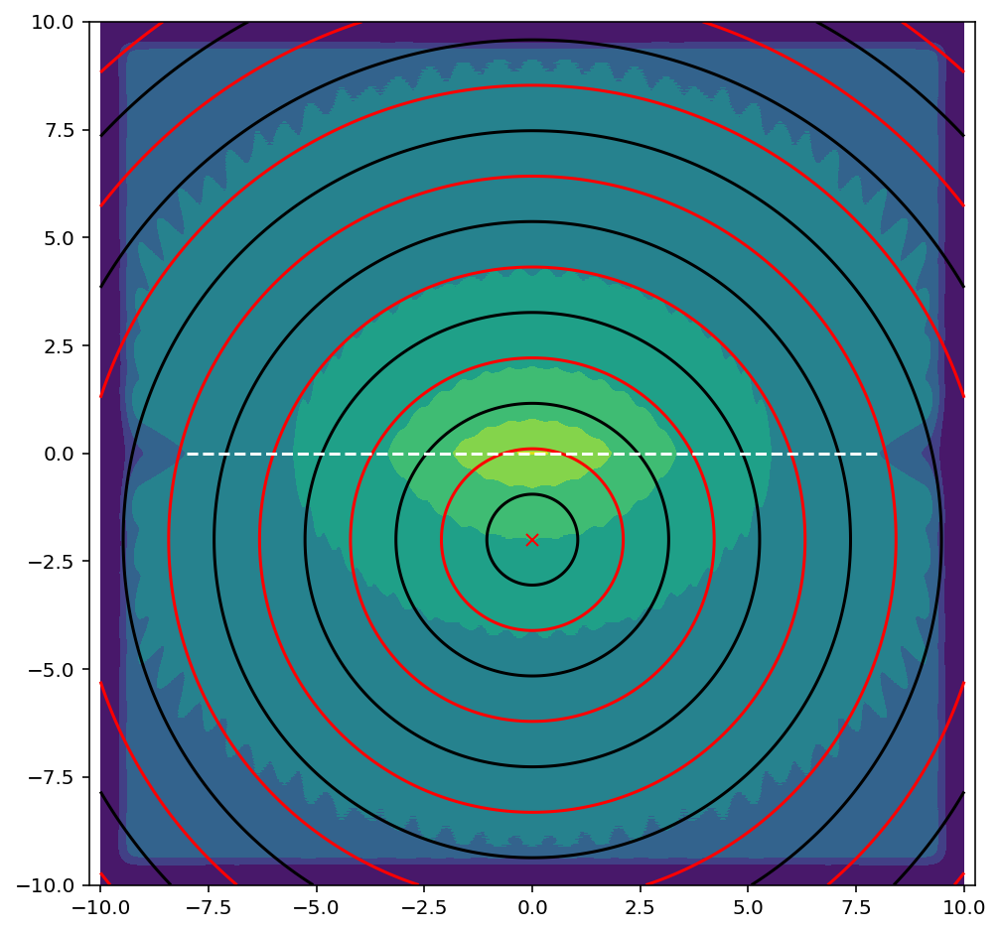

In [540]:
X, Y = np.meshgrid(xlist, xlist)
plt.figure(figsize=(8,8))
plt.contourf(X,
             Y,
             np.abs((metasource['fields']['Ez'])),
           origin='lower',
          extent=metasource['extent'])
plt.contour(X,
            Y,
            np.sqrt(X**2+(Y+metasource['point_source_depth'])**2),
            origin='lower',
            colors='r',
            levels=np.linspace(0,metasource['sim_cell_height'],20)[::2],
            extent=metasource['extent'])
plt.contour(X,
            Y,
            np.sqrt(X**2+(Y+metasource['point_source_depth'])**2),
            origin='lower',
            colors='k',
            levels=np.linspace(0,metasource['sim_cell_height'],20)[1::2],
            extent=metasource['extent'])
plt.plot([-metasource['ws'],metasource['ws']],
        [0,0],'w--')
plt.plot([0],[-metasource['point_source_depth']],'rx')
plt.axis('equal')
plt.show()

/Users/juan/opt/anaconda3/envs/pmeep/lib/python3.7/site-packages/ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in true_divide


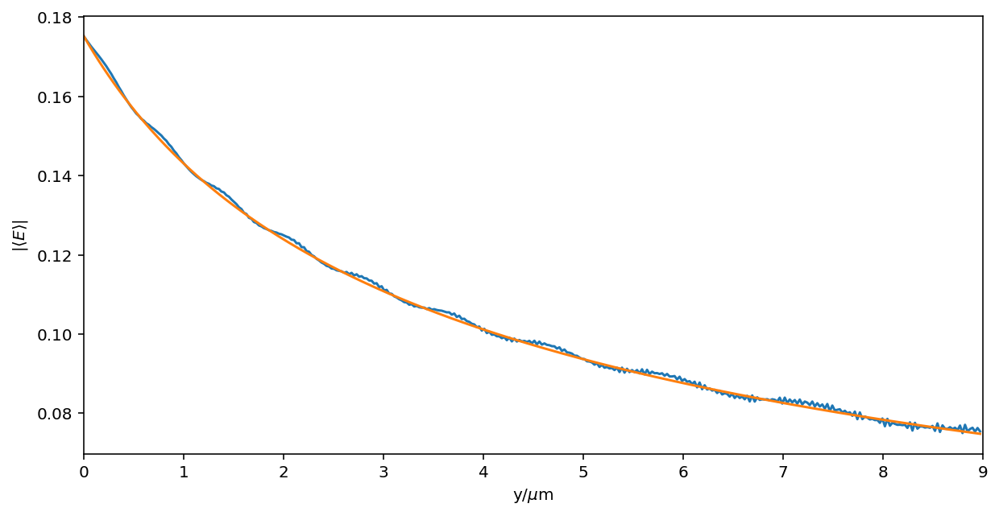

In [541]:
middle_index = int(metasource['fields']['Ez'].shape[0]/2)
exponent = 0.5
pivot_position = 1.
max_y = 9

e_mag = np.abs(metasource['fields']['Ez'])[:,middle_index][middle_index:]

y_axis = np.linspace(0,
                    metasource['sim_cell_height']/2,
                     len(e_mag))
max_y_index = np.argmin(np.abs(y_axis-max_y))
pivot_index = np.argmin(np.abs(y_axis-pivot_position))
ideal_mag = (e_mag[pivot_index]*1/
             ((y_axis+metasource['point_source_depth'])**exponent)*
             (pivot_position+metasource['point_source_depth'])**exponent)
dummy_mag = (e_mag[pivot_index]*1/
             ((y_axis)**exponent)*
             (pivot_position)**exponent)
plt.figure(figsize=(10,5))
plt.plot(y_axis[:max_y_index],
         e_mag[:max_y_index])
plt.plot(y_axis[:max_y_index],
        ideal_mag[:max_y_index])
plt.xlim(0,9)
plt.xlabel('y/$\mu$m')
plt.ylabel('|$\langle E \\rangle$|')
plt.show()

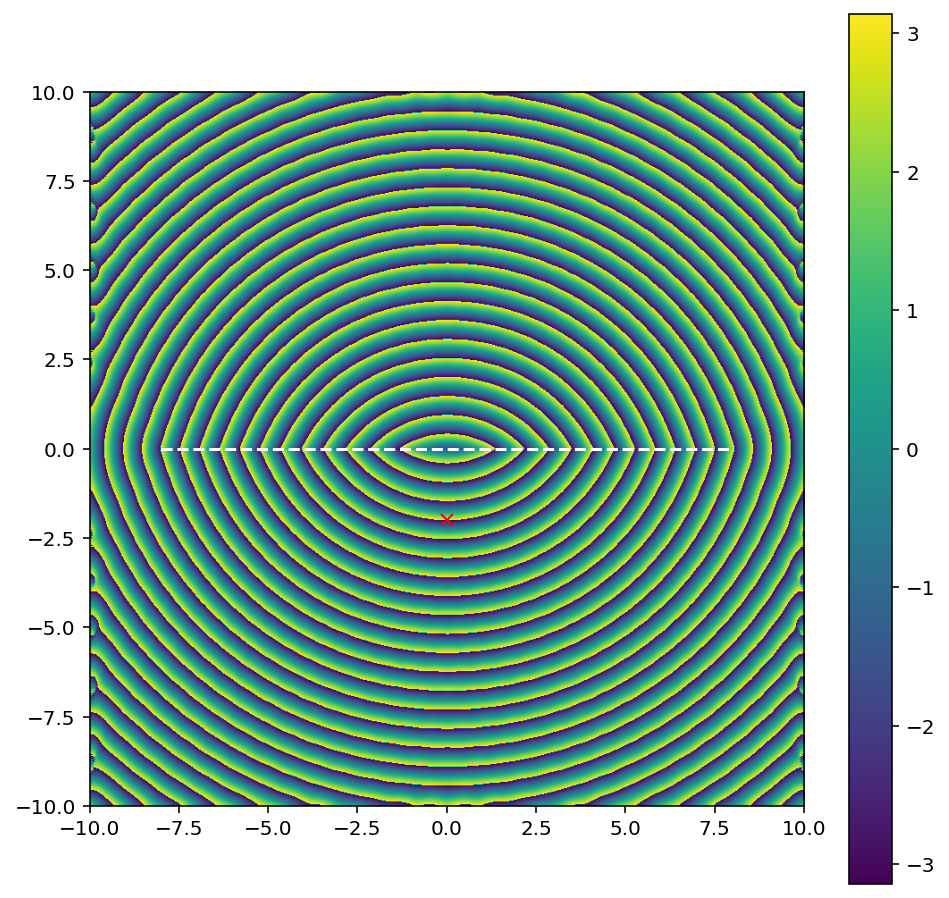

In [533]:
plt.figure(figsize=(8,8))
plt.imshow((np.angle(metasource['fields']['Ez'])),
           origin='lower',
          extent=metasource['extent'])
plt.plot([-metasource['ws'],metasource['ws']],
        [0,0],'w--')
plt.plot([0],[-metasource['point_source_depth']],'rx')
plt.colorbar()
plt.show()

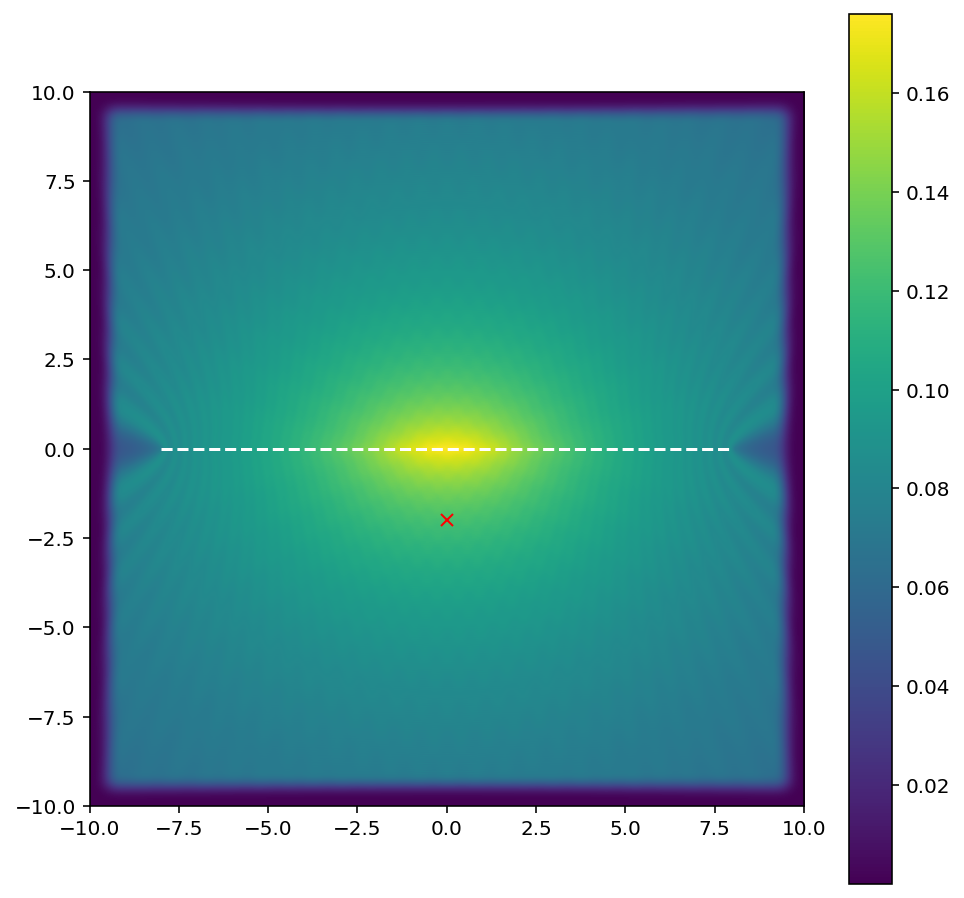

In [537]:
xlist = np.linspace(-metasource['sim_cell_width']/2,
                    metasource['sim_cell_width']/2,
                   metasource['fields']['Ez'].shape[0])
X, Y = np.meshgrid(xlist, xlist)
plt.figure(figsize=(8,8))
plt.imshow(np.abs((metasource['fields']['Ez'])),
           origin='lower',
          extent=metasource['extent'])
plt.plot([-metasource['ws'],metasource['ws']],
        [0,0],'w--')
plt.colorbar()
plt.plot([0],[-metasource['point_source_depth']],'rx')

plt.show()

In [382]:
# bits = []
# for x,y in zip(np.linspace(-metasource['sim_cell_height']/2,
#                     metasource['sim_cell_height']/2,1000)[500:],
#          np.abs((metasource['fields']['Ez']))[:,500][500:]):
#     bits.append("{%f,%f},"%(x,y))
# pyperclip.copy(''.join(bits))

# Finite Conjugate H=20 um, d=50um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [160]:
simulation_parameters = {
                        'wavelength': 0.532,
                        'post_width': 0.075,
                        'post_height': 0.600,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1,
                        'finite_conjugate': True}
simulation_parameters = expand_sim_params(simulation_parameters)

In [161]:
results = post_phase(simulation_parameters)

In [162]:
post_widths = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_widths:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_widths)
print(critical_width)

0.19421068187715892


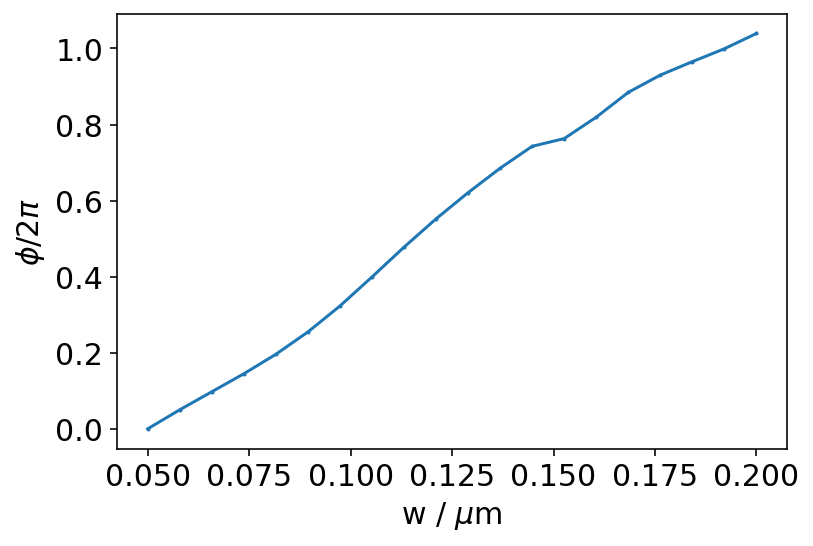

In [163]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_widths,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [164]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_widths':post_widths,'phases': phases, 'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1585259134


### MEEP - run

In [165]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % simulation_parameters['sim_id']
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

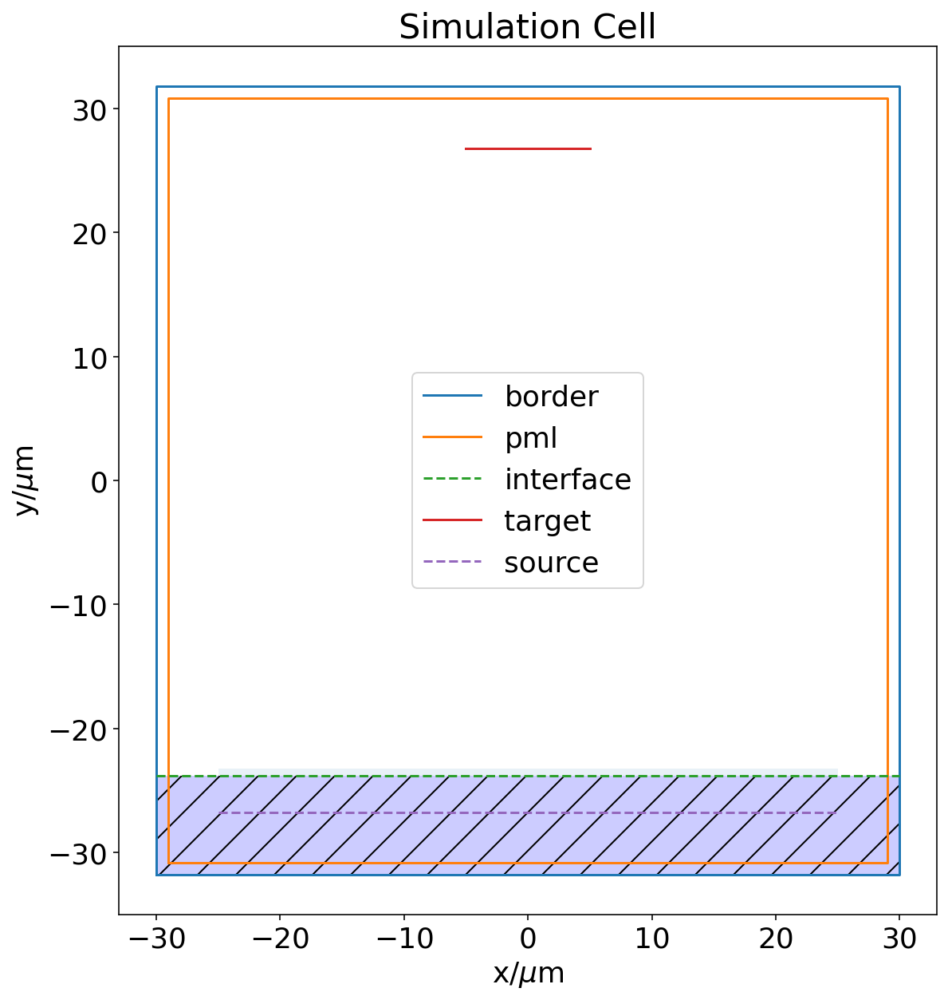

In [166]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50.,
    's': 3.,
    'H': 20,
    'gap': 4,
    'w': 5,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1,
    'resolution': 60.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True}
metalens = aux_params(metalens)
plot_simulation_cell(metalens)

In [167]:
metalens = make_metalens_geometry(metalens)

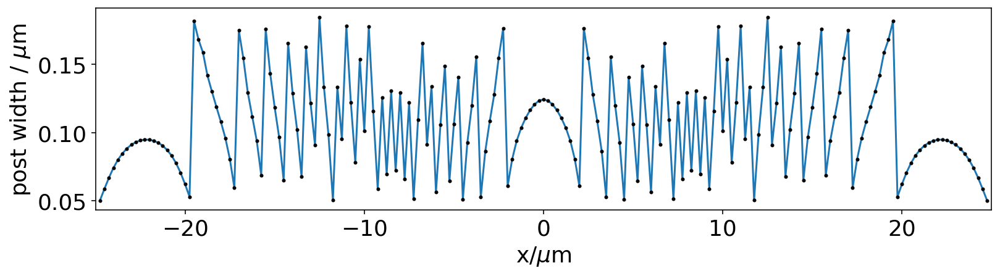

In [168]:
plot_phase_profile(metalens)

In [169]:
metalens = simulate_metalens(metalens)

-----------
Initializing structure...
     block, center = (0,-27.8,0)
          size (60,8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,-23.5,0)
          size (0.05,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,-23.5,0)
          size (0.0585313,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,-23.5,0)
          size (0.0666634,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,-23.5,0)
          size (0.0739205,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,-23.5,0)
          size (0.0798385,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,-23.5,0)
          size (0.0845032,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,-23.5,0)
          size (0.0882174,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,-23.5,0)
          size (0.0909532,0.6,0)
          axes (1,0,0)

Meep progress: 38.391666666666666/119.771977826172 = 32.1% done in 347.1s, 735.7s to go
Meep progress: 38.833333333333336/119.771977826172 = 32.4% done in 351.1s, 731.8s to go
Meep progress: 39.275/119.771977826172 = 32.8% done in 355.1s, 727.9s to go
Meep progress: 39.71666666666667/119.771977826172 = 33.2% done in 359.2s, 724.0s to go
Meep progress: 40.15833333333333/119.771977826172 = 33.5% done in 363.2s, 720.1s to go
Meep progress: 40.6/119.771977826172 = 33.9% done in 367.3s, 716.2s to go
Meep progress: 41.041666666666664/119.771977826172 = 34.3% done in 371.3s, 712.3s to go
Meep progress: 41.483333333333334/119.771977826172 = 34.6% done in 375.4s, 708.5s to go
Meep progress: 41.88333333333333/119.771977826172 = 35.0% done in 379.4s, 705.6s to go
Meep progress: 42.325/119.771977826172 = 35.3% done in 383.5s, 701.7s to go
Meep progress: 42.766666666666666/119.771977826172 = 35.7% done in 387.5s, 697.8s to go
Meep progress: 43.208333333333336/119.771977826172 = 36.1% done in 391.6s

Meep progress: 82.35833333333333/119.771977826172 = 68.8% done in 742.9s, 337.5s to go
Meep progress: 82.83333333333333/119.771977826172 = 69.2% done in 747.0s, 333.1s to go
Meep progress: 83.3/119.771977826172 = 69.5% done in 751.0s, 328.8s to go
Meep progress: 83.75/119.771977826172 = 69.9% done in 755.1s, 324.8s to go
Meep progress: 84.19166666666666/119.771977826172 = 70.3% done in 759.1s, 320.8s to go
Meep progress: 84.66666666666667/119.771977826172 = 70.7% done in 763.2s, 316.5s to go
Meep progress: 85.13333333333333/119.771977826172 = 71.1% done in 767.3s, 312.2s to go
Meep progress: 85.6/119.771977826172 = 71.5% done in 771.3s, 307.9s to go
Meep progress: 86.06666666666666/119.771977826172 = 71.9% done in 775.3s, 303.6s to go
Meep progress: 86.53333333333333/119.771977826172 = 72.2% done in 779.3s, 299.4s to go
Meep progress: 86.99166666666666/119.771977826172 = 72.6% done in 783.4s, 295.2s to go
Meep progress: 87.45/119.771977826172 = 73.0% done in 787.4s, 291.0s to go
Meep p

In [170]:
metalens=compute_post_simulation_params(metalens)

In [171]:
! pushover "finished"

In [181]:
metalens['TIR_onset_coordinate'] = np.tan(np.arcsin(1/metalens['n']))*metalens['H']

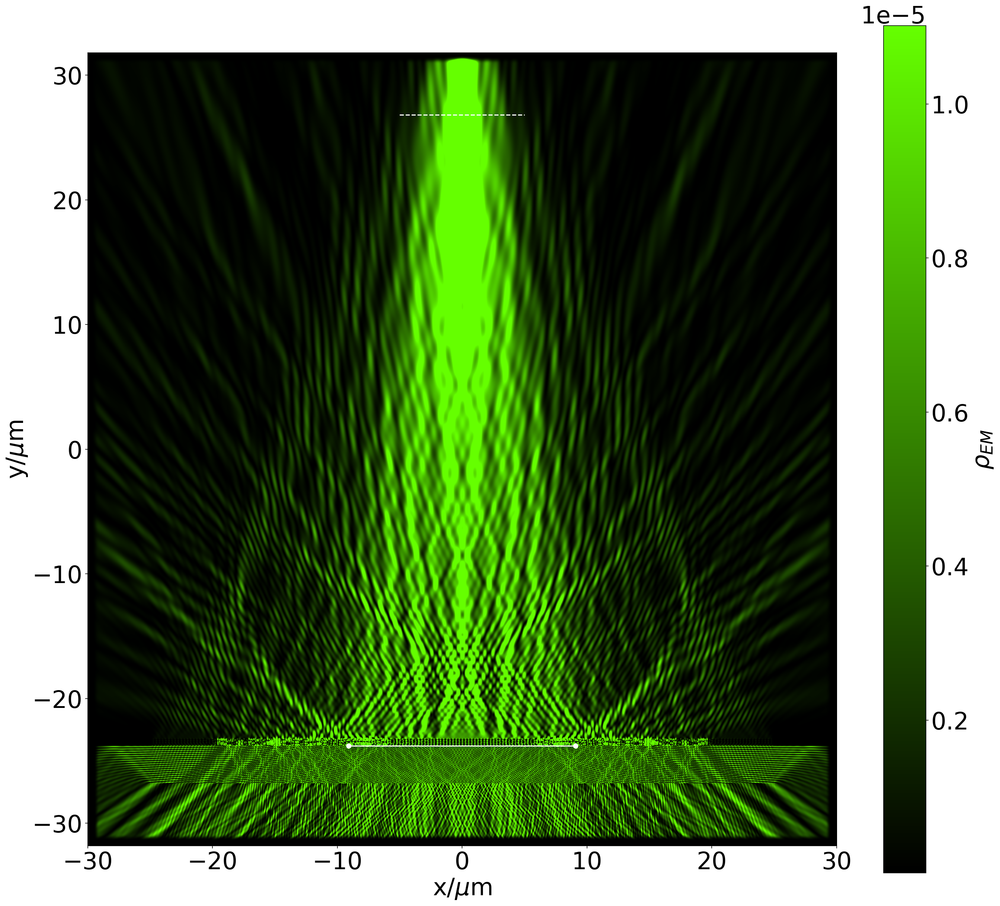

In [188]:
plot_density(metalens,
             'rho_em',
             extra='''plt.plot([-metalens["TIR_onset_coordinate"],
             metalens["TIR_onset_coordinate"]],
             [metalens["interface_coordinate"]]*2,
             "wo-")
             ''')

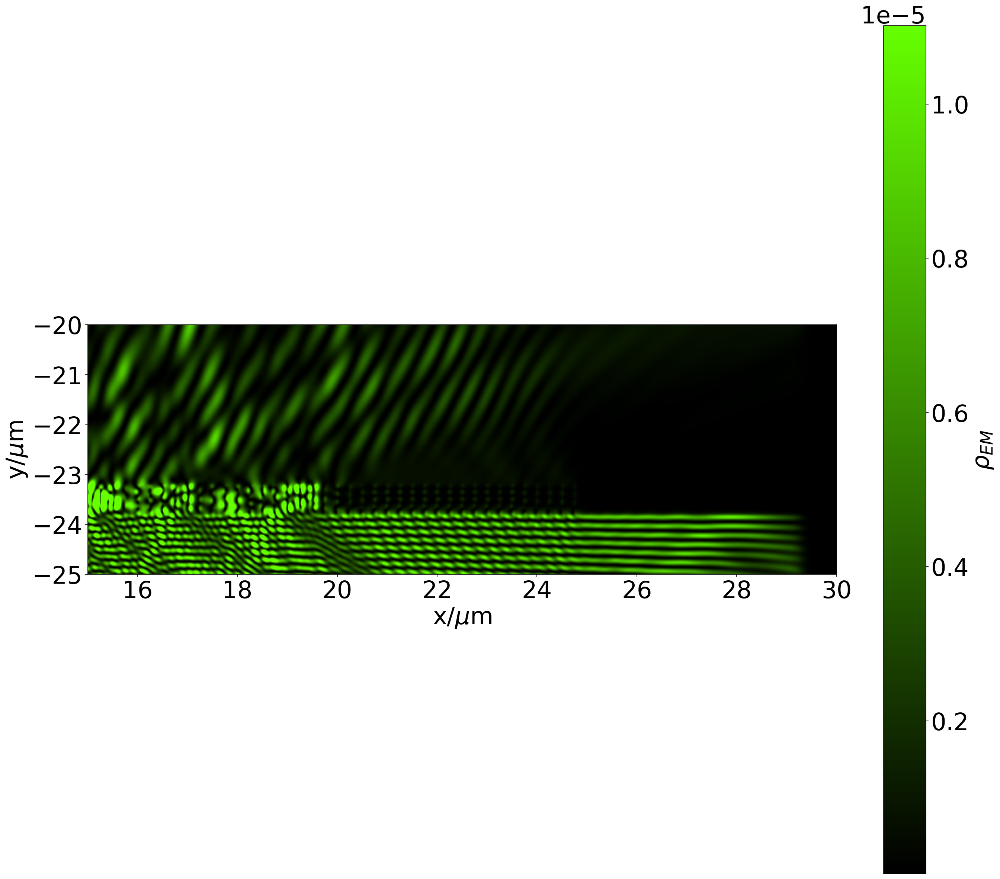

In [194]:
plot_density(metalens,
             'rho_em',
             extra='''plt.plot([-metalens["TIR_onset_coordinate"],
             metalens["TIR_onset_coordinate"]],
             [metalens["interface_coordinate"]]*2,
             "wo-"); plt.xlim(15,30); plt.ylim(-25,-20)
             ''')

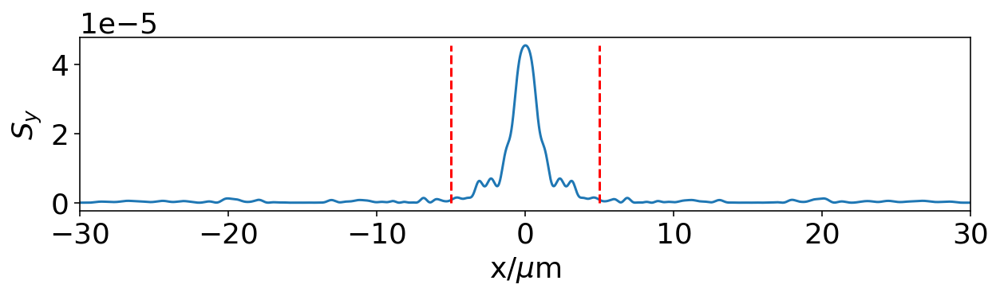

In [195]:
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],metalens['Sy'][metalens['detector_plane_index']])
#plt.plot(metalens['transverse_axis'],metalens['e2'][metalens['max_axial_field_in_image_space']])
plt.plot([-metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.plot([metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.xlabel('x/$\mu$m')
plt.ylabel('$S_y$')
plt.xlim(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2)
plt.savefig('metalens-{sim_id}-top-cross-section.pdf'.format(**metalens),
           transparent=True)
plt.show()

In [174]:
print_params(metalens)

------------------------------  -----------------------
post_height                     0.60
R                               25
d                               50.00
s                               3.00
H                               20
gap                             4
w                               5
unit cell size                  0.25
epsilon                         5.84
wavelength                      0.53
min_width                       0.05
pml_width                       1
resolution                      60.00
sim_id                          1585259134
complex_fields                  True
save_output                     False
x_mirror_symmetry               True
aperture                        50
num of unit cells               199
ws                              25
fcen                            1.88
n                               2.42
wavelength_rgb                  2.42
k                               28.55
cmap                            28.55
sim_cell_width            

In [205]:
required_phases = np.array([imaging_phase_profile(**metalens, x=xs) 
                                for xs in metalens['axis_positions']])
#required_phases = required_phases - min(required_phases)
# required_phases = required_phases % (2*np.pi)

In [208]:
int(min(required_phases)/2/np.pi)

-62

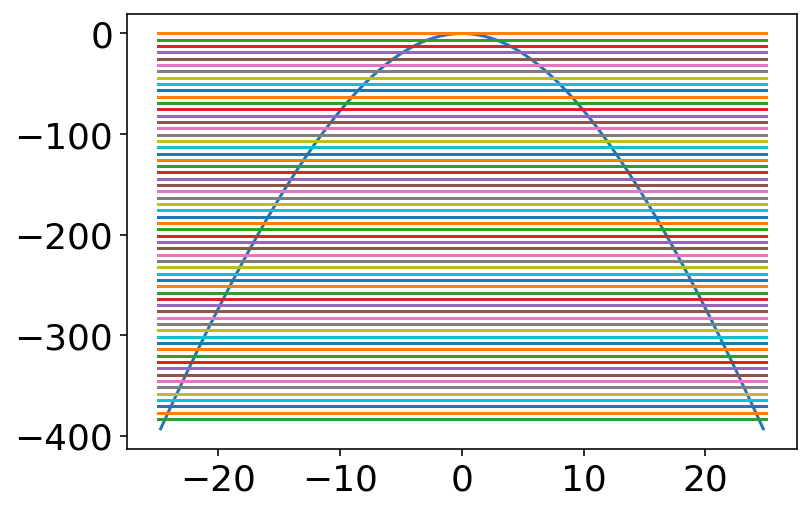

In [209]:
plt.figure()
plt.plot(metalens['axis_positions'],
        required_phases)
for i in range(-int(min(required_phases)/2/np.pi)):
    plt.plot([-metalens['R'],metalens['R']],
            [-i*2*np.pi]*2)
plt.show()

# Finite Conjugate H=50 um, d=20um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [132]:
simulation_parameters = {
                        'wavelength': 0.532,
                        'post_width': 0.075,
                        'post_height': 0.600,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1,
                        'finite_conjugate': True}
simulation_parameters = expand_sim_params(simulation_parameters)

In [133]:
results = post_phase(simulation_parameters)

In [134]:
post_widths = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_widths:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_widths)
print(critical_width)

0.19421068187715892


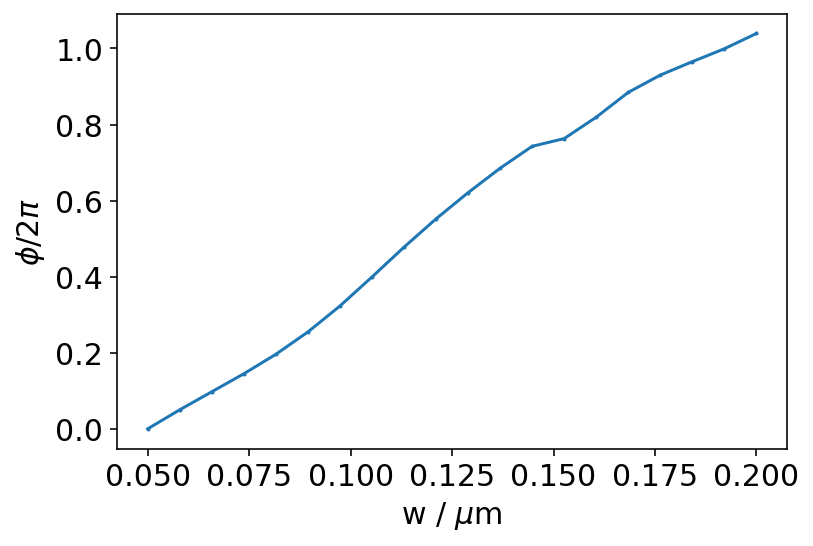

In [135]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_widths,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [136]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_widths':post_widths,'phases': phases, 'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1585257775


### MEEP - run

In [137]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % '1585257775'
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

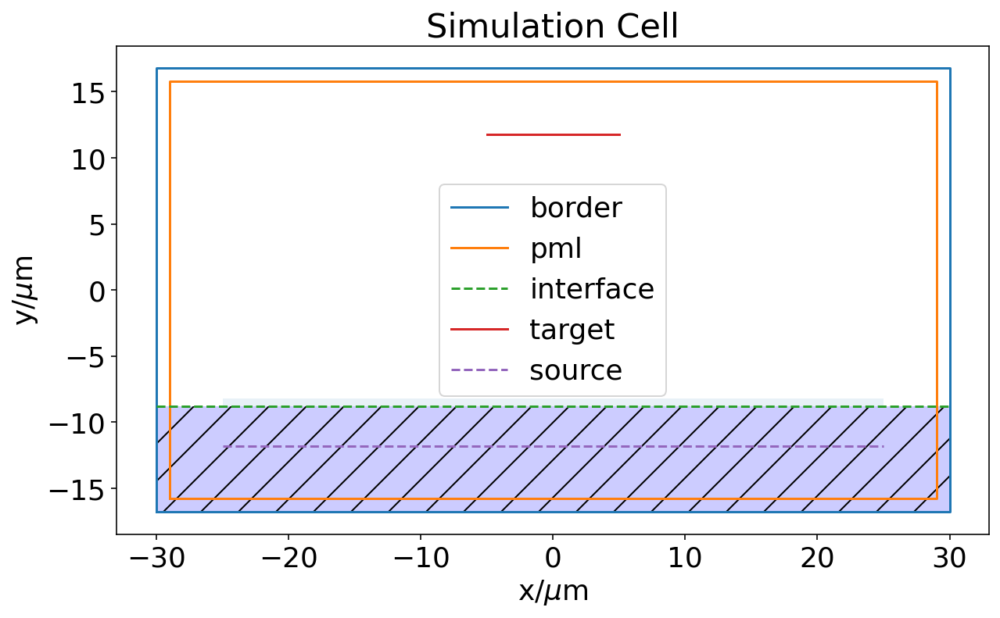

In [151]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 20.,
    's': 3.,
    'H': 50,
    'gap': 4,
    'w': 5,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1,
    'resolution': 60.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True}
metalens = aux_params(metalens)
plot_simulation_cell(metalens)

In [152]:
metalens = make_metalens_geometry(metalens)

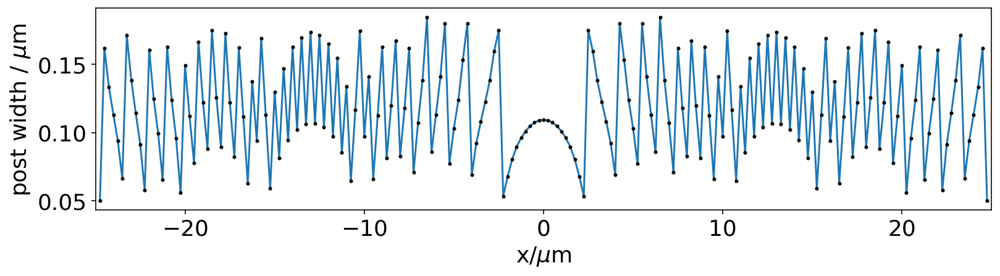

In [153]:
plot_phase_profile(metalens)

In [154]:
metalens = simulate_metalens(metalens)

-----------
Initializing structure...
     block, center = (0,-12.8,0)
          size (60,8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,-8.5,0)
          size (0.05,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,-8.5,0)
          size (0.162002,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,-8.5,0)
          size (0.133422,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,-8.5,0)
          size (0.113117,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,-8.5,0)
          size (0.0936946,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,-8.5,0)
          size (0.0660765,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,-8.5,0)
          size (0.171289,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,-8.5,0)
          size (0.138465,0.6,0)
          axes (1,0,0), (0,1,0), (0

Meep progress: 70.56666666666666/74.8733344984831 = 94.2% done in 345.8s, 21.1s to go
Meep progress: 71.45/74.8733344984831 = 95.4% done in 349.8s, 16.8s to go
Meep progress: 72.325/74.8733344984831 = 96.6% done in 353.9s, 12.5s to go
Meep progress: 73.18333333333334/74.8733344984831 = 97.7% done in 357.9s, 8.3s to go
Meep progress: 74.025/74.8733344984831 = 98.9% done in 361.9s, 4.1s to go
Meep progress: 74.875/74.8733344984831 = 100.0% done in 365.9s, -0.0s to go
run 0 finished at t = 74.875 (8985 timesteps)


In [155]:
metalens=compute_post_simulation_params(metalens)

In [156]:
! pushover "finished"

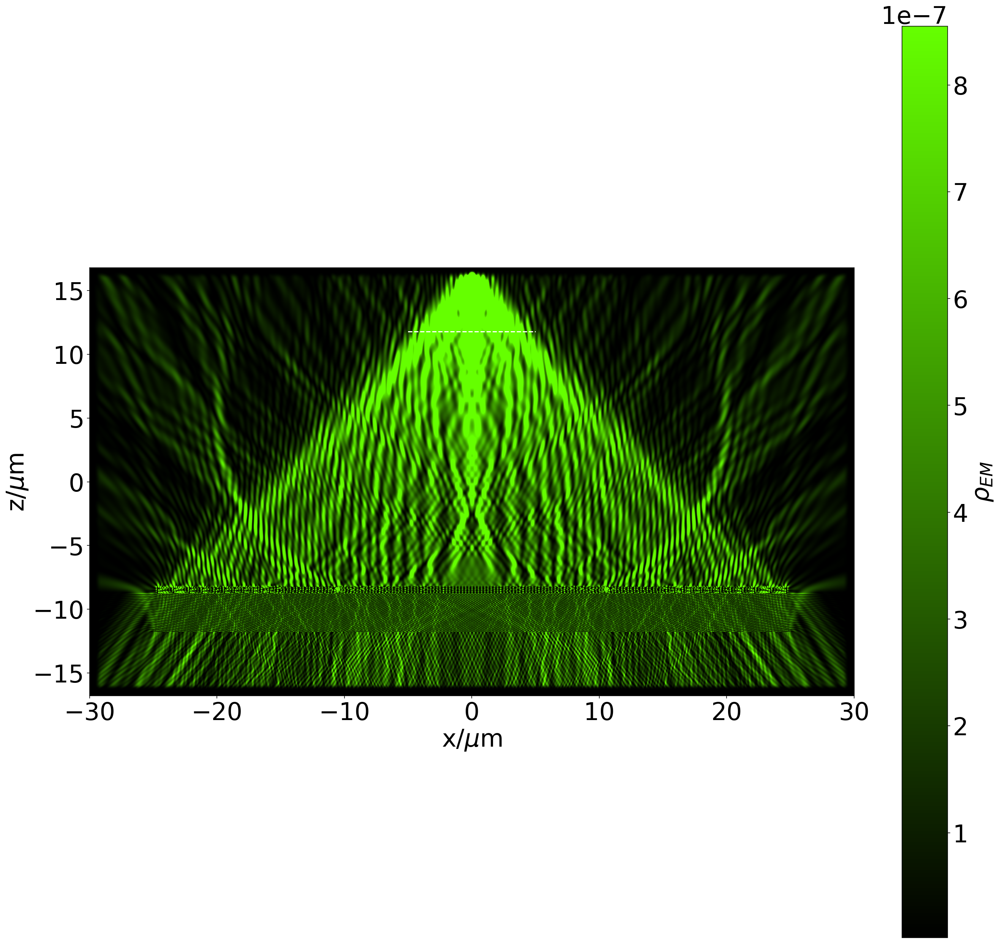

In [157]:
plot_density(metalens, 'rho_em')

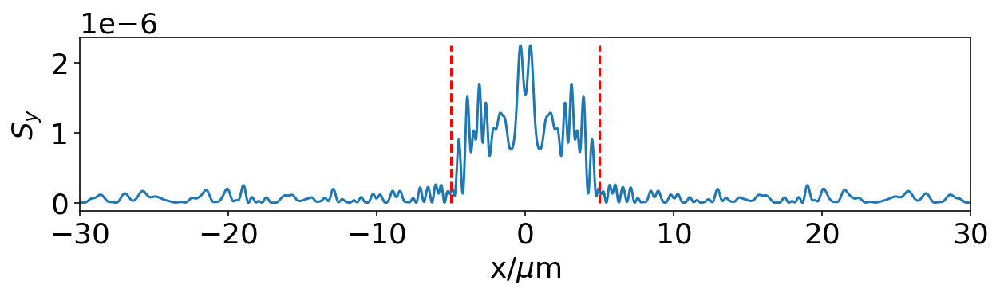

In [158]:
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],metalens['Sy'][metalens['detector_plane_index']])
#plt.plot(metalens['transverse_axis'],metalens['e2'][metalens['max_axial_field_in_image_space']])
plt.plot([-metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.plot([metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.xlabel('x/$\mu$m')
plt.ylabel('$S_y$')
plt.xlim(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2)
plt.savefig('metalens-{sim_id}-top-cross-section.pdf'.format(**metalens),
           transparent=True)
plt.show()

In [159]:
print_params(metalens)

------------------------------  -----------------------
post_height                     0.60
R                               25
d                               20.00
s                               3.00
H                               50
gap                             4
w                               5
unit cell size                  0.25
epsilon                         5.84
wavelength                      0.53
min_width                       0.05
pml_width                       1
resolution                      60.00
sim_id                          1585257775
complex_fields                  True
save_output                     False
x_mirror_symmetry               True
aperture                        50
num of unit cells               199
ws                              25
fcen                            1.88
n                               2.42
wavelength_rgb                  2.42
k                               28.55
cmap                            28.55
sim_cell_width            

# Finite Conjugate H=d=50 um, R=25, w=5, 250 nm pitch

### S4 - bootstrap

In [4]:
simulation_parameters = {
                        'wavelength': 0.532,
                        'post_width': 0.075,
                        'post_height': 0.600,
                        'cell_width': 0.25,
                        'epsilon': 5.8418,
                        'num_G' : 70,
                        'x_coord': 0,
                        'y_coord': 0,
                        'sim_id' : str(int(time.time())),
                        's_amp': 0, 'p_amp': 1,
                        'finite_conjugate': True}
simulation_parameters = expand_sim_params(simulation_parameters)

In [5]:
results = post_phase(simulation_parameters)

In [6]:
post_widths = np.linspace(0.05,0.2,20)
phases = []
simulation_parameters['field_height'] = simulation_parameters['post_height']
for p_width in post_widths:
    simulation_parameters['post_width'] = p_width
    simulation_parameters = expand_sim_params(simulation_parameters)
    results = post_phase(simulation_parameters)
    Exr = results[0]
    Eyr = results[1]
    Ezr = results[2]
    Exi = results[3]
    Eyi = results[4]
    Ezi = results[5] 
    phases.append(np.arctan2(Exi, Exr))
phases = np.array(phases)
phases = np.unwrap(phases)
phases = phases - phases[0]
critical_width = np.interp(2*np.pi*1.01,phases,post_widths)
print(critical_width)

0.19421068187715892


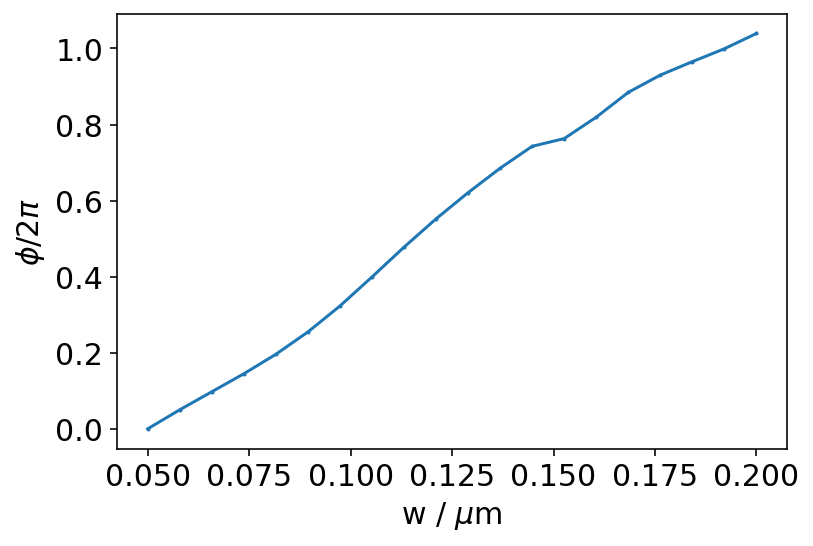

In [7]:
plt.rcParams.update({'font.size': 15})
plt.figure()
plt.plot(post_widths,phases / (2*np.pi),'o-',ms=1.)
plt.xlabel('w / $\mu$m')
plt.ylabel('$\phi/2\pi$')
plt.show()

In [8]:
print(simulation_parameters['sim_id'])
pickle.dump({'post_widths':post_widths,'phases': phases, 'simulation_parameters': simulation_parameters},
            open('carbon-phases-%s.pkl' % simulation_parameters['sim_id'],'wb'))

1585246101


### MEEP - run

In [9]:
sim_fname =  '/Users/juan/Google Drive/Zia Lab/CEM/MEEP/carbon-phases-%s.pkl' % '1585246101'
post_widths = pickle.load(open(sim_fname,'rb'))['post_widths']
phases = pickle.load(open(sim_fname,'rb'))['phases']
simulation_parameters = pickle.load(open(sim_fname,'rb'))['simulation_parameters']

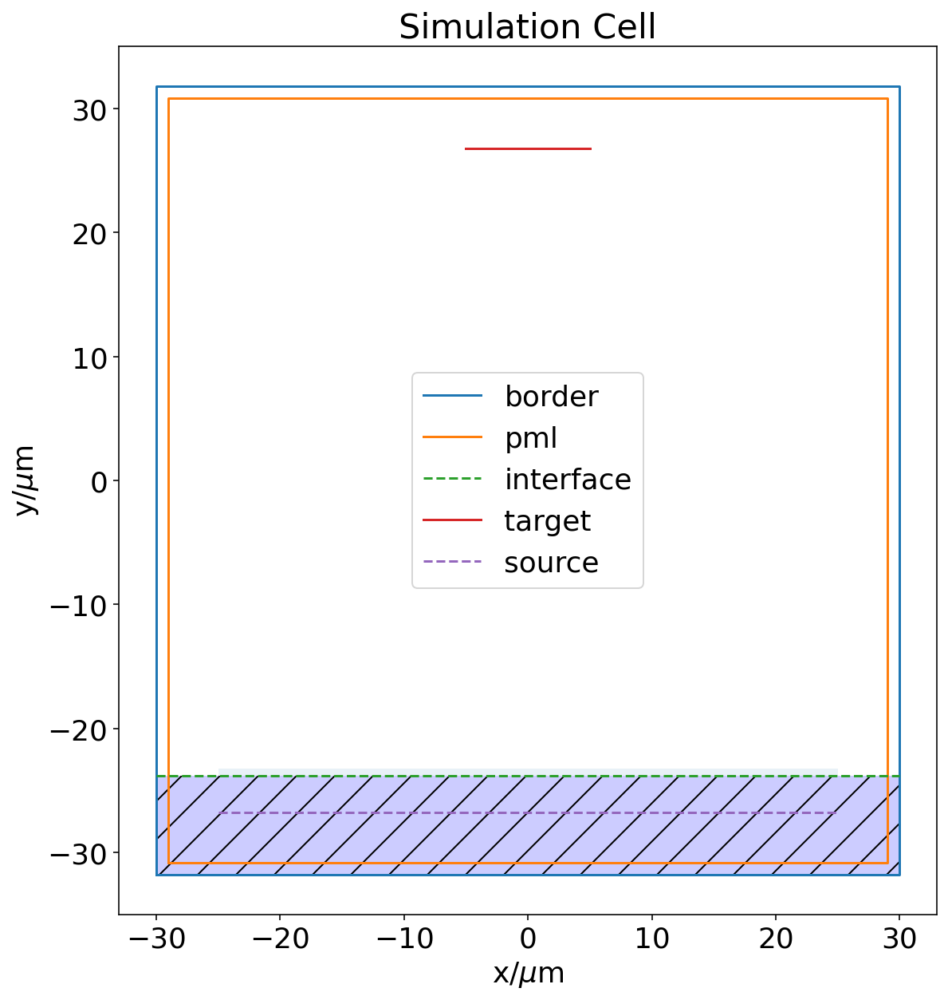

In [60]:
metalens = {
    'post_height':simulation_parameters['post_height'],
    'R': 25,
    'd': 50,
    's': 3.,
    'H': 50,
    'gap': 4,
    'w': 5,
    'unit cell size': simulation_parameters['cell_width'],
    'epsilon': simulation_parameters['epsilon'],
    'phases': phases,
    'widths': post_widths,
    'wavelength': simulation_parameters['wavelength'],
    'min_width': 0.05,
    'pml_width': 1,
    'resolution': 60.,
    'sim_id': simulation_parameters['sim_id'],
    'simulation_parameters' : simulation_parameters,
    'complex_fields' : True,
    'save_output': False,
    'x_mirror_symmetry': True}
metalens = aux_params(metalens)
plot_simulation_cell(metalens)

In [61]:
metalens = make_metalens_geometry(metalens)

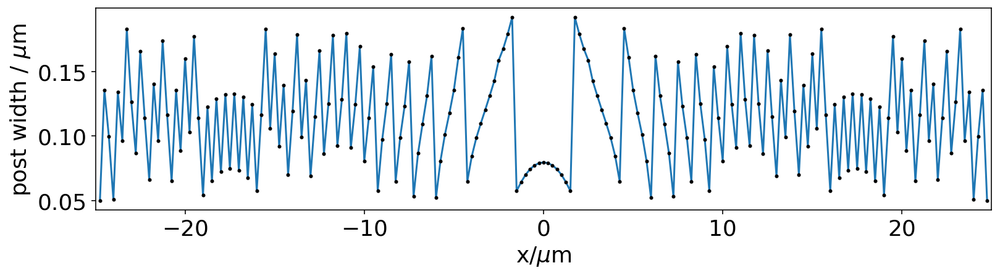

In [62]:
plot_phase_profile(metalens)

In [63]:
metalens = simulate_metalens(metalens)

-----------
Initializing structure...
     block, center = (0,-27.8,0)
          size (60,8,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.75,-23.5,0)
          size (0.05,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.5,-23.5,0)
          size (0.135479,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24.25,-23.5,0)
          size (0.0993931,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-24,-23.5,0)
          size (0.0508402,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.75,-23.5,0)
          size (0.134047,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.5,-23.5,0)
          size (0.0963095,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23.25,-23.5,0)
          size (0.182898,0.6,0)
          axes (1,0,0), (0,1,0), (0,0,1)
     block, center = (-23,-23.5,0)
          size (0.126465,0.6,0)
          axes (1,0,0), (0

Meep progress: 38.641666666666666/119.771977826172 = 32.3% done in 347.0s, 728.6s to go
Meep progress: 39.09166666666667/119.771977826172 = 32.6% done in 351.1s, 724.6s to go
Meep progress: 39.541666666666664/119.771977826172 = 33.0% done in 355.1s, 720.6s to go
Meep progress: 39.983333333333334/119.771977826172 = 33.4% done in 359.2s, 716.8s to go
Meep progress: 40.425/119.771977826172 = 33.8% done in 363.2s, 712.9s to go
Meep progress: 40.858333333333334/119.771977826172 = 34.1% done in 367.3s, 709.3s to go
Meep progress: 41.3/119.771977826172 = 34.5% done in 371.3s, 705.5s to go
Meep progress: 41.75/119.771977826172 = 34.9% done in 375.4s, 701.5s to go
Meep progress: 42.19166666666666/119.771977826172 = 35.2% done in 379.4s, 697.7s to go
Meep progress: 42.641666666666666/119.771977826172 = 35.6% done in 383.5s, 693.6s to go
Meep progress: 43.083333333333336/119.771977826172 = 36.0% done in 387.5s, 689.7s to go
Meep progress: 43.53333333333333/119.771977826172 = 36.3% done in 391.6s,

Meep progress: 83.525/119.771977826172 = 69.7% done in 747.0s, 324.2s to go
Meep progress: 84.0/119.771977826172 = 70.1% done in 751.1s, 319.8s to go
Meep progress: 84.46666666666667/119.771977826172 = 70.5% done in 755.1s, 315.6s to go
Meep progress: 84.93333333333334/119.771977826172 = 70.9% done in 759.2s, 311.4s to go
Meep progress: 85.40833333333333/119.771977826172 = 71.3% done in 763.2s, 307.1s to go
Meep progress: 85.875/119.771977826172 = 71.7% done in 767.3s, 302.9s to go
Meep progress: 86.34166666666667/119.771977826172 = 72.1% done in 771.3s, 298.6s to go
Meep progress: 86.75833333333333/119.771977826172 = 72.4% done in 775.3s, 295.0s to go
Meep progress: 87.21666666666667/119.771977826172 = 72.8% done in 779.3s, 290.9s to go
Meep progress: 87.69166666666666/119.771977826172 = 73.2% done in 783.3s, 286.6s to go
Meep progress: 88.16666666666667/119.771977826172 = 73.6% done in 787.4s, 282.3s to go
Meep progress: 88.63333333333333/119.771977826172 = 74.0% done in 791.4s, 278.

In [108]:
metalens=compute_post_simulation_params(metalens)

In [65]:
! pushover "finished"

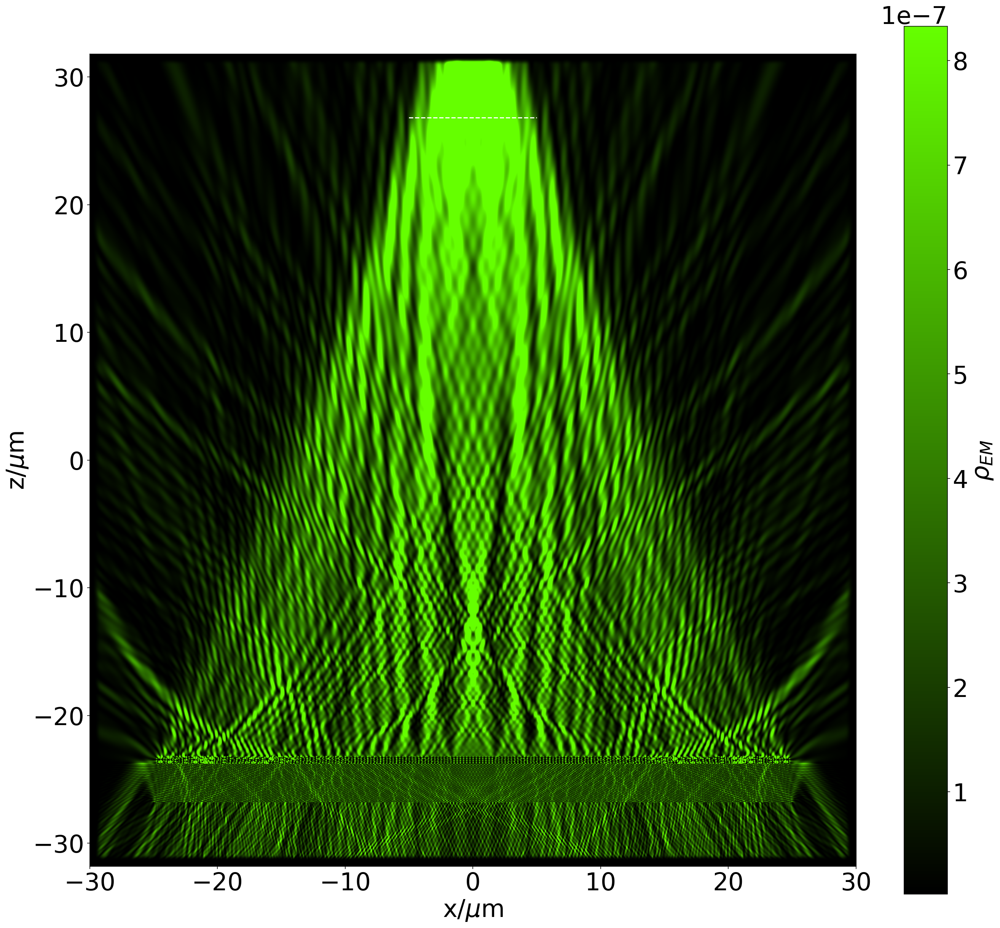

In [126]:
plot_density(metalens, 'rho_em')

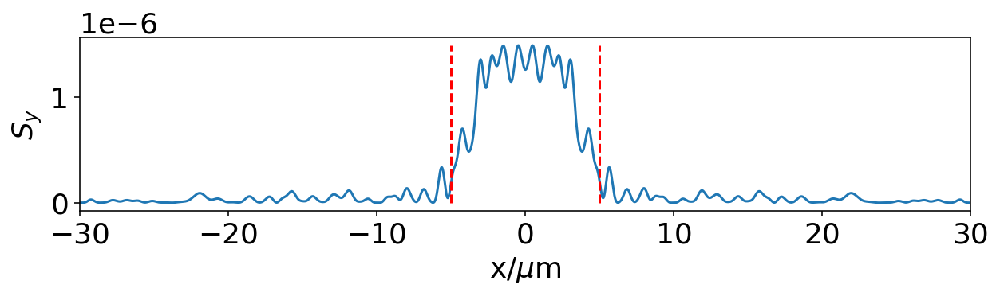

In [128]:
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(10,2))
plt.plot(metalens['transverse_axis'],metalens['Sy'][metalens['detector_plane_index']])
#plt.plot(metalens['transverse_axis'],metalens['e2'][metalens['max_axial_field_in_image_space']])
plt.plot([-metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.plot([metalens['w']]*2,[0,max(metalens['Sy'][metalens['detector_plane_index']])],'r--')
plt.xlabel('x/$\mu$m')
plt.ylabel('$S_y$')
plt.xlim(-metalens['sim_cell_width']/2,
        metalens['sim_cell_width']/2)
plt.savefig('metalens-{sim_id}-top-cross-section.pdf'.format(**metalens),
           transparent=True)
plt.show()

In [123]:
print_params(metalens)

------------------------------  -----------------------
post_height                     0.60
R                               25
d                               50
s                               3.00
H                               50
gap                             4
w                               5
unit cell size                  0.25
epsilon                         5.84
wavelength                      0.53
min_width                       0.05
pml_width                       1
resolution                      60.00
sim_id                          1585246101
complex_fields                  True
save_output                     False
x_mirror_symmetry               True
aperture                        50
num of unit cells               199
ws                              25
fcen                            1.88
n                               2.42
wavelength_rgb                  2.42
k                               28.55
cmap                            28.55
sim_cell_width               